## Inital QC of AMP phase 2 cite-seq samples
## Fan Zhang
## 2020-01-22

In [2]:
library(Seurat)
library(harmony)
library(magrittr)
library(gridExtra)
library(ggthemes)
# library(monocle)
library(reticulate)
library(ggbeeswarm)
library(ggrepel)
library(plyr)
library(ggplot2)
library(gridExtra)
library(ggthemes)
library(dplyr)
library(Seurat)
library(RColorBrewer)
library(ggbeeswarm)
library(ggrepel)
library(MASS)
library(matrixStats)
library(viridis)
library(grid)

meta_colors <- list(
  "tissue" = c( 
    "blood" = "#66C2A5", 
    "marrow" = "#FC8D62", 
    "TF" = "#80B1D3",
    "Cord blood" = "#66C2A5", 
    "Bone marrow" = "#FC8D62",

    "IBD" = "#A6761D", # IBD
    "healthy (IBD)" = "#E6AB02", # healthy vs IBD

    "healthy (SLE)" = "#B2DF8A",

    "healthy (PF)" = "#A6CEE3", # healthy vs Pulmonary Fibrosis

    "PF" = "#1F78B4",

    "Crohn" = "#6A3D9A", 
    "SLE" = "#33A02C", 
    "RA" = "#E31A1C",

    "OA"  = "#FB9A99"

  ),
  "source" = c( 
    "tissue" = "#BD0026",
    "PBMC" = "#7570B3",
    "fluid" = "#FEB24C"
  ),

 "cluster" = c(
     "0" = "#E41A1C",
     "1" = "#377EB8",
     "2" = "#4DAF4A",
     "3" = "#984EA3",
     "4" = "#FF7F00",
     "5" = "#FFFF33",
     "6" = "#A65628",
     "7" = "#F781BF",
     "8" = "#999999",
     "9" = "#66C2A5",
     "10" = "#FC8D62",
     "11" = "#8DA0CB",
     "12" = "#E78AC3",
     "13" = "#A6D854",
     "14" = "#FFD92F",
     "15" = "#E5C494",
     "16" = "#B3B3B3",
     "17" = "#E41A1C",
     "18" = "#377EB8",
     "19" = "#4DAF4A",
     "20" = "#984EA3",
     "21" = "#FF7F00",
     "22" = "#FFFF33"
  )
)


suppressMessages({source("/data/srlab/ik936/Foxxy/utils/libraries.R")
                  library(viridis)
                  library(data.table)
                  library(dplyr)
                  library(reticulate)
                  library(Rcpp)
                  library(scales)
                  library(irlba)
                  library(Seurat,lib.loc = "~/R/x86_64-pc-linux-gnu-library/3.4/")
                  source("/data/srlab/ik936/Foxxy/utils/utils.R")
                  source("/data/srlab/anathan/scripts/scseq_utils.R")
                  library(patchwork)
                  library(presto)
#                   library(uwot)
                 })

In [ ]:
library(umap)

In [16]:
Sys.getenv("R_LIBS_USER")

[1] "~/R/x86_64-conda_cos6-linux-gnu-library/3.6"

In [3]:
# Functions

# FindVariableGenesBatch <- function(exprs_mat, meta_df, cell_col = "cell_id",
#                                    batch_col = "sample_id", ngenes_use = 1e3, expr_min = .1) {
#     x_res <- split(meta_df[[cell_col]], meta_df[[batch_col]]) %>% lapply(function(x) {
#         FindVariableGenesSeurat(exprs_mat[, x]) %>%
#             subset(gene.mean >= expr_min) %>%
#             tibble::rownames_to_column("gene") %>%
#             dplyr::arrange(-gene.dispersion) %>%
#             head(ngenes_use)
#     })
#     data.table(Reduce(rbind, x_res))[, .N, by = gene][order(-N)]
# }

FindVariableGenesBatch <- function(exprs_mat, meta_df, genes_exclude = NULL, ngenes_use = 1e3, expr_min = .1) {
    if (!is.null(genes_exclude)) {
        genes_use <- setdiff(row.names(exprs_mat), genes_exclude)
    }
    x_res <- split(meta_df$cell, meta_df$sample) %>% lapply(function(x) {
        FindVariableGenesSeurat(exprs_mat[genes_use, x]) %>% 
            subset(gene.mean >= expr_min) %>% 
            tibble::rownames_to_column("gene") %>% 
            dplyr::arrange(-gene.dispersion) %>%
            head(ngenes_use)
    })
    data.table(Reduce(rbind, x_res))[, .N, by = gene][order(-N)]    
}



FindVariableGenesSeurat <- function (data, x.low.cutoff = 0.1, x.high.cutoff = 8,
                                     y.cutoff = 1, y.high.cutoff = Inf, num.bin = 0,
                                     binning.method = "equal_width", sort.results = TRUE,
                                     display.progress = TRUE, ...)
{
    genes.use <- rownames(data)
    if (class(data) != "dgCMatrix") {
        data <- as(as.matrix(data), "dgCMatrix")
    }
    ## (1) get means and variances
    gene.mean <- FastExpMean(data, display.progress)
    names(gene.mean) <- genes.use
    gene.dispersion <- FastLogVMR(data, display.progress)
    names(gene.dispersion) <- genes.use

    gene.dispersion[is.na(x = gene.dispersion)] <- 0
    gene.mean[is.na(x = gene.mean)] <- 0

    mv.df <- data.frame(gene.mean, gene.dispersion)
    rownames(mv.df) <- rownames(data)

    ## (OPTIONAL) do the binning correction
    if (num.bin > 0) {
      if (binning.method == "equal_width") {
          data_x_bin <- cut(x = gene.mean, breaks = num.bin)
      }
      else if (binning.method == "equal_frequency") {
          data_x_bin <- cut(x = gene.mean, breaks = c(-1, quantile(gene.mean[gene.mean >
              0], probs = seq(0, 1, length.out = num.bin))))
     }
      else {
          stop(paste0("Invalid selection: '", binning.method,
              "' for 'binning.method'."))
      }
      names(x = data_x_bin) <- names(x = gene.mean)
      mean_y <- tapply(X = gene.dispersion, INDEX = data_x_bin,
          FUN = mean)
      sd_y <- tapply(X = gene.dispersion, INDEX = data_x_bin,
          FUN = sd)
      gene.dispersion.scaled <- (gene.dispersion - mean_y[as.numeric(x = data_x_bin)])/sd_y[as.numeric(x = data_x_bin)]
      gene.dispersion.scaled[is.na(x = gene.dispersion.scaled)] <- 0
      ##names(gene.dispersion.scaled) <- names(gene.mean)

      mv.df$gene.dispersion.scaled <- gene.dispersion.scaled
    }

    return(mv.df)
}

environment(FindVariableGenesSeurat) <- asNamespace("Seurat")

ScaleDataSeurat <- function (data.use, margin = 1, scale.max = 10,
                                block.size = 1000) {

    if (margin == 2) data.use %<>% t
    max.block <- ceiling(nrow(data.use)/block.size)

    ## Define data and functions to use in sparse and dense cases
    if (class(data.use) == "dgCMatrix" | class(data.use) == "dgTMatrix") {
        scale_fxn <- function(x) {
            FastSparseRowScale(mat = x, scale = TRUE, center = TRUE,
                               scale_max = scale.max, display_progress = FALSE)
        }
    } else {
        scale_fxn <- function(x) {
            FastRowScale(mat = x, scale = TRUE, center = TRUE,
                               scale_max = scale.max, display_progress = FALSE)
       }
        data.use <- as.matrix(data.use)
    }

    ## Do scaling, at once or in chunks
    if (max.block == 1) {
        scaled.data <- scale_fxn(data.use)
    } else {
        scaled.data <- matrix(NA, nrow(data.use), ncol(data.use))
        for (i in 1:max.block) {
            idx.min <- (block.size * (i - 1))
            idx.max <- min(nrow(data.use), (block.size * i - 1) + 1)
            my.inds <- idx.min:idx.max
            scaled.data[my.inds, ] <- scale_fxn(data.use[my.inds, , drop = F])
        }
    }

    colnames(scaled.data) <- colnames(data.use)
    row.names(scaled.data) <- row.names(data.use)
    scaled.data[is.na(scaled.data)] <- 0
    if (margin == 2) scaled.data %<>% t
    return(scaled.data)
}
environment(ScaleDataSeurat) <- asNamespace("Seurat")


fig.size <- function(height, width) {
    options(repr.plot.height = height, repr.plot.width = width)
}

SingleFeaturePlotSeurat <- function (data.use, feature, data.plot, pt.size, pch.use, cols.use,
    dim.codes, min.cutoff, max.cutoff, coord.fixed, no.axes,
    no.title = FALSE, no.legend, dark.theme, vector.friendly = FALSE,
    png.file = NULL, png.arguments = c(10, 10, 100))
{
    if (vector.friendly) {
        previous_call <- blank_call <- png_call <- match.call()
        blank_call$pt.size <- -1
        blank_call$vector.friendly <- FALSE
        png_call$no.axes <- TRUE
        png_call$no.legend <- TRUE
        png_call$vector.friendly <- FALSE
        png_call$no.title <- TRUE
        blank_plot <- eval(blank_call, sys.frame(sys.parent()))
        png_plot <- eval(png_call, sys.frame(sys.parent()))
        png.file <- SetIfNull(x = png.file, default = paste0(tempfile(),
            ".png"))
        ggsave(filename = png.file, plot = png_plot, width = png.arguments[1],
            height = png.arguments[2], dpi = png.arguments[3])
        to_return <- AugmentPlot(blank_plot, png.file)
        file.remove(png.file)
        return(to_return)
    }
    idx.keep <- which(!is.na(data.use[feature, ]))
    data.gene <- data.frame(data.use[feature, idx.keep])
#     data.gene <- na.omit(object = data.frame(data.use[feature,
#         ]))
    min.cutoff <- SetQuantile(cutoff = min.cutoff, data = data.gene)
    max.cutoff <- SetQuantile(cutoff = max.cutoff, data = data.gene)
    data.gene <- sapply(X = data.gene, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
    data.gene <- sapply(X = data.gene, FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    data_plot <- data.plot[idx.keep, ]
    data_plot$gene <- data.gene
    if (length(x = cols.use) == 1) {
        brewer.gran <- brewer.pal.info[cols.use, ]$maxcolors
    }
    else {
        brewer.gran <- length(x = cols.use)
    }
    if (all(data.gene == 0)) {
        data.cut <- 0
    }
    else {
        data.cut <- as.numeric(x = as.factor(x = cut(x = as.numeric(x = data.gene),
            breaks = brewer.gran)))
    }
    data_plot$col <- as.factor(x = data.cut)
    p <- data_plot %>%
        dplyr::arrange(col) %>%
        ggplot(mapping = aes(x = x, y = y))
    if (brewer.gran != 2) {
        if (length(x = cols.use) == 1) {
            p <- p + geom_point(mapping = aes(color = col), size = pt.size,
                shape = pch.use) + #scale_color_brewer(palette = cols.use)
                scale_color_viridis(option = "plasma", end = .9)
        }
        else {
            p <- p + geom_point(mapping = aes(color = col), size = pt.size,
                shape = pch.use) + #scale_color_manual(values = cols.use)
                scale_color_viridis(option = "plasma", end = .9)
        }
    }
    else {
        if (all(data_plot$gene == data_plot$gene[1])) {
            warning(paste0("All cells have the same value of ",
                feature, "."))
            p <- p + geom_point(color = cols.use[1], size = pt.size,
                shape = pch.use)
        }
        else {
            p <- p + geom_point(mapping = aes(color = gene),
                size = pt.size, shape = pch.use) + scale_color_viridis(option = "plasma", end = .9
    )
        }
    }
    if (dark.theme) {
        p <- p + DarkTheme()
    }
    if (no.axes) {
        p <- p + theme(axis.line = element_blank(), axis.text.x = element_blank(),
            axis.text.y = element_blank(), axis.ticks = element_blank(),
            axis.title.x = element_blank(), axis.title.y = element_blank())
        if (!no.title)
            p <- p + labs(title = feature, x = "", y = "")
        if (no.title)
            p <- p + labs(x = "", y = "")
    }
    else {
        if (no.title)
            p <- p + labs(x = dim.codes[1], y = dim.codes[2])
        if (!(no.title))
            p <- p + labs(title = feature) + labs(x = "", y = "")
    }
    if (no.legend) {
        p <- p + theme(legend.position = "none")
    }
    if (coord.fixed) {
        p <- p + coord_fixed()
    }
    return(p)
}
environment(SingleFeaturePlotSeurat) <- asNamespace("Seurat")

PlotFeatures <- function(umap_use, features_plot, exprs_use, cells_use, ncols, pt_size = .5, pt_shape = ".", q_lo = "q10", q_hi = "q90") {
    if (missing(cells_use)) cells_use <- 1:nrow(umap_use)
    if (missing(ncols)) ncols <- round(sqrt(length(features_plot)))
    
    plt_list <- lapply(features_plot, function(feature_use) {
        SingleFeaturePlotSeurat(exprs_use[, cells_use], feature_use, data.frame(x = umap_use[cells_use, 1], y = umap_use[cells_use, 2]),
                                pt.size = pt_size, pch.use = pt_shape, cols.use = c("lightgrey", "blue"),
                                dim.codes = c("UMAP 1", "UMAP 2"), min.cutoff = c(q10 = q_lo), max.cutoff = c(q90 = q_hi),
                                coord.fixed = FALSE, no.axes = FALSE, dark.theme = FALSE, no.legend = TRUE)
    })
    plot_grid(plotlist = plt_list, ncol = ncols)
    #return(plt_list)
}

BuildSNNSeurat <- function (data.use, k.param = 30, prune.SNN = 1/15, nn.eps = 0) {
    my.knn <- nn2(data = data.use, k = k.param, searchtype = "standard", eps = nn.eps)
    nn.ranked <- my.knn$nn.idx

    snn_res <- ComputeSNN(nn_ranked = nn.ranked, prune = prune.SNN)
    rownames(snn_res) <- row.names(data.use)
    colnames(snn_res) <- row.names(data.use)
    return(snn_res)
}
environment(BuildSNNSeurat) <- asNamespace("Seurat")

NormalizeDataSeurat <- function(A, scaling_factor = 1e4, do_ftt = FALSE) {
	A@x <- A@x / rep.int(Matrix::colSums(A), diff(A@p))
    A@x <- scaling_factor * A@x
    if (do_ftt) {
        A@x <- sqrt(A@x) + sqrt(1 + A@x)
    } else {
        A@x <- log(1 + A@x)
    }
	return(A)
}


plot_clusters <- function(cluster_ids, labels, pt_size = 14, umap_use = umap_res, collapse_labels = FALSE) {
    cluster_table <- table(cluster_ids)
    clusters_keep <- names(which(cluster_table > 20))
    plt_df <- umap_use %>% data.frame() %>% cbind(cluster = cluster_ids) %>%
        subset(cluster %in% clusters_keep) 
    if (!missing(labels)) {
        if (collapse_labels) {
            plt_df$cluster <- labels[plt_df$cluster + 1]            
        } else {
            plt_df$cluster <- sprintf("c%d: %s", plt_df$cluster, labels[plt_df$cluster + 1])
        }
    }
    plt_df %>% 
        ggplot(aes(X1, X2, col = factor(cluster))) + geom_point(shape = '.', size = 6, alpha = .7) + 
        geom_label_repel(data = data.table(plt_df)[, .(X1 = mean(X1), X2 = mean(X2)), by = cluster], 
                   aes(label = cluster), size = pt_size, alpha = .8) + 
        theme_void() +
        theme(axis.line = element_line()) +
        guides(col = FALSE)
}

## Load the data

In [10]:
# ls /data/srlab1/public/srcollab/AMP_Phase_2/cellranger-3.1.0/GRCh38/  > filenames.txt
filename <- read.table("./filenames.txt", header = FALSE, stringsAsFactors = FALSE)
filename <- as.character(t(filename))
# filename

In [13]:
i = 1
dat <- Seurat::Read10X(paste("/data/srlab1/public/srcollab/AMP_Phase_2/cellranger-3.1.0/GRCh38/", filename[i], "/outs/filtered_feature_bc_matrix/", sep=""))
adt_exprs <- dat$`Antibody Capture` %>% as("dgCMatrix")
mRNA_exprs <- dat$`Gene Expression` %>% as("dgCMatrix")
colnames(mRNA_exprs) <- paste0(filename[i], "_", colnames(mRNA_exprs), sep="")
colnames(adt_exprs) <- paste0(filename[i], "_", colnames(adt_exprs), sep="")
meta_all <- data.frame(
    cell = colnames(mRNA_exprs),
    sample = rep(filename[i], ncol(mRNA_exprs))
)

myplots <- list()
for (i in 2:length(filename)) {
    print(i)
    dat <- Seurat::Read10X(paste("/data/srlab1/public/srcollab/AMP_Phase_2/cellranger-3.1.0/GRCh38/", filename[i], "/outs/filtered_feature_bc_matrix/", sep=""))
    adt_temp <- dat$`Antibody Capture` %>% as("dgCMatrix")
    mRNA_temp <- dat$`Gene Expression` %>% as("dgCMatrix")
    
    colnames(mRNA_temp) <- paste0(filename[i], "_", colnames(mRNA_temp), sep="")
    colnames(adt_temp) <- paste0(filename[i], "_", colnames(adt_temp), sep="")
    
    meta_temp <- data.frame(
        cell = colnames(mRNA_temp),
        sample = rep(filename[i], ncol(mRNA_temp))
    )
    
    adt_exprs <- cbind(adt_exprs, adt_temp)
    mRNA_exprs <- cbind(mRNA_exprs, mRNA_temp)
    meta_all <- rbind(meta_all, meta_temp)
}

10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 2


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 3


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 4


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 5


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 6


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 7


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 8


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 9


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 10


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 11


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 12


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 13


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 14


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 15


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 16


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 17


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 18


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 19


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 20


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 21


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 22


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 23


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 24


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 25


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 26


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 27


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 28


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 29


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 30


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 31


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 32


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 33


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 34


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 35


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 36


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 37


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 38


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 39


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 40


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 41


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 42


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 43


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 44


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 45


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 46


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 47


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 48


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 49


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 50


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 51


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 52


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 53


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 54


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 55


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 56


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 57


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 58


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 59


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 60


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 61


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 62


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 63


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 64


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 65


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 66


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 67


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 68


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 69


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 70


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 71


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 72


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 73


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 74


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 75


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 76


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 77


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 78


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 79


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 80


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 81


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 82


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 83


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 84


10X data contains more than one type and is being returned as a list containing matrices of each type.



[1] 85


10X data contains more than one type and is being returned as a list containing matrices of each type.



## Save the raw combined data for future use

In [17]:
dim(adt_exprs)
dim(mRNA_exprs)
table(meta_all$sample)
all(meta_all$cell == colnames(mRNA_exprs))
all(meta_all$cell == colnames(adt_exprs))

# saveRDS(adt_exprs, "adt_exprs_2020-01-24.rds")
# saveRDS(mRNA_exprs, "mRNA_exprs_2020-01-24.rds")
# saveRDS(meta_all, "meta_all_2020-01-24.rds")

[1]     58 576600

[1]  33538 576600


 BRI-399  BRI-401  BRI-403  BRI-405  BRI-407  BRI-409  BRI-411  BRI-413 
   11905     8540     6597     1613     4574     4544     2948     5772 
 BRI-415  BRI-417  BRI-419  BRI-421  BRI-425  BRI-427  BRI-429  BRI-431 
   10504     3156     7458    15542     1558    15693     1407     1387 
 BRI-436  BRI-438  BRI-440  BRI-442  BRI-456  BRI-458  BRI-460  BRI-462 
    7717     4435     1687     5427     6262    14370    16023    17199 
 BRI-475  BRI-477  BRI-479  BRI-481  BRI-483  BRI-485  BRI-487  BRI-503 
    3402     3167    13921     1841      845     9022    13974      365 
 BRI-505  BRI-507  BRI-509  BRI-511  BRI-515  BRI-517  BRI-521  BRI-523 
   11423    13242      389    13242    11104    21102     2347    17866 
 BRI-525  BRI-527  BRI-529  BRI-534  BRI-536  BRI-538  BRI-540  BRI-542 
   19447      669     9606     1395      970     8118    17036     9030 
 BRI-544  BRI-546  BRI-548  BRI-550  BRI-552  BRI-554  BRI-556  BRI-558 
     649     3735     3393     8338     5485      

[1] TRUE

[1] TRUE

## Load the data

In [19]:
adt_exprs <- readRDS("adt_exprs_2020-01-24.rds")
mRNA_exprs <- readRDS("mRNA_exprs_2020-01-24.rds")
meta_all <- readRDS("meta_all_2020-01-24.rds")

In [22]:
meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_site_anno_hpca_2020-03-31.rds")
dim(meta_all)

[1] 403596     85

In [24]:
mRNA_exprs <- mRNA_exprs[, meta_all$cell]
dim(mRNA_exprs)
saveRDS(mRNA_exprs, "raw_mRNA_exprs_afterQC_2020-04-21.rds")

[1]  33538 403596

[1] 13

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



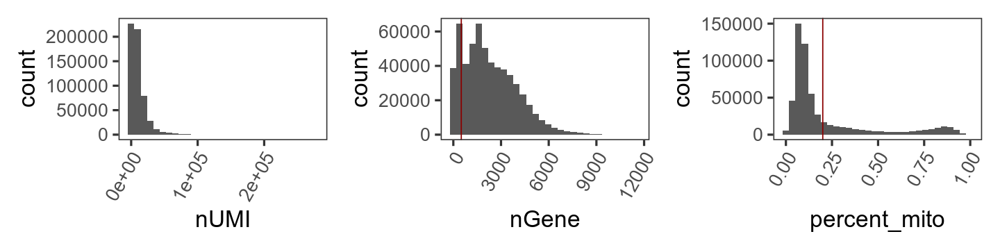

In [11]:
# Filter out cells with <= 500 genes, >= 0.2 mitochondrial genes
meta_all$nUMI <- Matrix::colSums(mRNA_exprs)
meta_all$nGene <- Matrix::colSums(mRNA_exprs > 0)
mito_genes <- grep("^MT-", rownames(mRNA_exprs), value = TRUE, ignore.case = TRUE)
meta_all$percent_mito <- Matrix::colSums(mRNA_exprs[mito_genes, ])/Matrix::colSums(mRNA_exprs)
length(mito_genes)

fig.size(3,12)
(ggplot(meta_all) +
    geom_histogram(aes(x = nUMI))) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              )+
(ggplot(meta_all) +
    geom_histogram(aes(x = nGene)) +
    geom_vline(xintercept = 500, col = "darkred")) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              ) +
(ggplot(meta_all) +
    geom_histogram(aes(x = percent_mito)) +
    geom_vline(xintercept = 0.2, col = "darkred")) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              )
#  ggsave(file = paste("post_QC_barplot", ".pdf", sep = ""), width = 15, height = 4, dpi = 300)

Warning message:
“Transformation introduced infinite values in continuous x-axis”


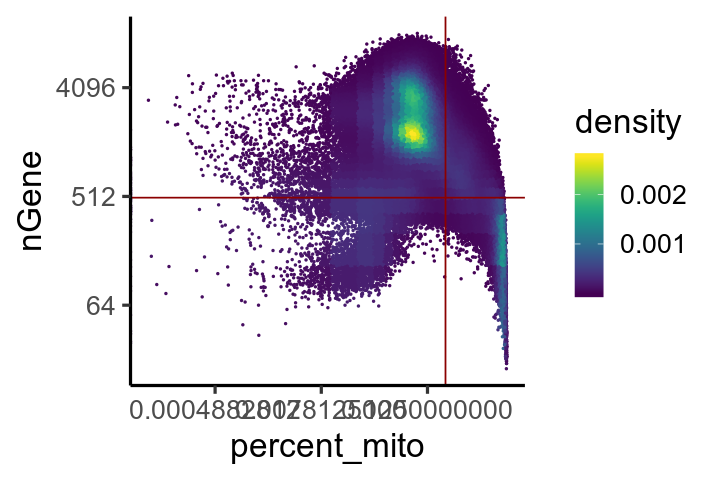

In [12]:
meta_all <- readRDS("meta_all_2020-01-24.rds")

library(MASS)
get_density <- function(x, y, ...) {
    dens <- MASS::kde2d(x, y, ...)
    ix <- findInterval(x, dens$x)
    iy <- findInterval(y, dens$y)
    ii <- cbind(ix,iy)
    return(dens$z[ii])
}
plot_dens <- get_density(meta_all$percent_mito, meta_all$nGene, n = 100)
fig.size(4,6)
ggplot(meta_all, aes(x = percent_mito, y = nGene, color = plot_dens)) +
    geom_point(size = .3) +
    scale_x_continuous(trans = "log2") + 
    scale_y_continuous(trans = "log2") + 
    geom_hline(yintercept = 500, color = "darkred") +
    geom_vline(xintercept = .2, color = "darkred") +
    scale_color_viridis() +
    labs(color = "density") +
    theme_classic(base_size = 20) +
    theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

In [64]:
# Plot per sample quality

In [13]:
temp <- as.data.frame(table(meta_all$sample))
sample_order <- temp[order(temp$Freq, decreasing = T),]
s10000 <- as.character(sample_order[which(sample_order$Freq > 10000),]$Var1)
s1000 <-as.character(sample_order[which(sample_order$Freq > 1000 & sample_order$Freq < 10001),]$Var1)
s100 <- as.character(sample_order[which(sample_order$Freq < 1001),]$Var1)
meta_all$sample <- as.character(meta_all$sample)
meta_all$cell <- as.character(meta_all$cell)
meta_all[1:4,]
# meta_all$sample <- factor(meta_all$sample, levels = sample_order)

,cell,sample,nUMI,nGene,percent_mito
,<chr>,<chr>,<dbl>,<int>,<dbl>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497
3,BRI-399_AAACCCACAGTAGTTC,BRI-399,6012,1713,0.32218896
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573


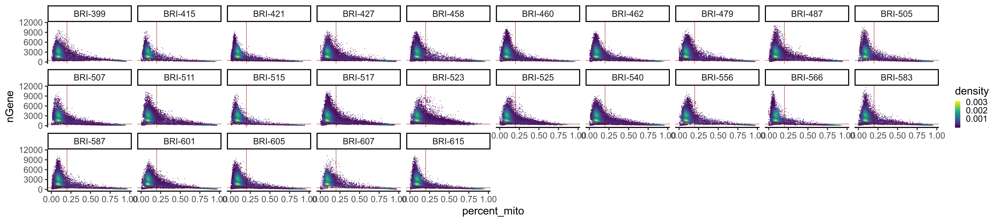

In [15]:
library(MASS)
get_density <- function(x, y, ...) {
    dens <- MASS::kde2d(x, y, ...)
    ix <- findInterval(x, dens$x)
    iy <- findInterval(y, dens$y)
    ii <- cbind(ix,iy)
    return(dens$z[ii])
}

test <- meta_all[which(meta_all$sample %in% s10000),]
plot_dens <- get_density(test$percent_mito, test$nGene, n = 100)

fig.size(10,45)
ggplot(test, 
    aes(x = percent_mito, y = nGene, color = plot_dens)
      ) +
    geom_point(size = .3) +
    geom_hline(yintercept = 500, color = "darkred") +
    geom_vline(xintercept = .2, color = "darkred") +
    facet_wrap(sample ~ . , ncol = 10) +
    scale_color_viridis() +
    labs(color = "density") +
    theme_classic(base_size = 35) +
    theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

[1] 403596      5


 BRI-399  BRI-401  BRI-403  BRI-405  BRI-407  BRI-409  BRI-411  BRI-413 
    8146     5610     4505     1085     2955     3354     2469     4229 
 BRI-415  BRI-417  BRI-419  BRI-421  BRI-425  BRI-427  BRI-429  BRI-431 
    8719     2372     4970    11950     1021    10182      982     1091 
 BRI-436  BRI-438  BRI-440  BRI-442  BRI-456  BRI-458  BRI-460  BRI-462 
    6661     2700     1386     3271     4644    11569    12618    13342 
 BRI-475  BRI-477  BRI-479  BRI-481  BRI-483  BRI-485  BRI-487  BRI-503 
    2510     2169    10603     1453      665     6037     9339      316 
 BRI-505  BRI-507  BRI-509  BRI-511  BRI-515  BRI-517  BRI-521  BRI-523 
    7857     8132      319     8513     9572    13932      714     5903 
 BRI-525  BRI-527  BRI-529  BRI-534  BRI-536  BRI-538  BRI-540  BRI-542 
   10196      380     3635      870      832     5257     9806     6159 
 BRI-544  BRI-546  BRI-548  BRI-550  BRI-552  BRI-554  BRI-556  BRI-558 
     348     2990     2620     6139     4190      

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



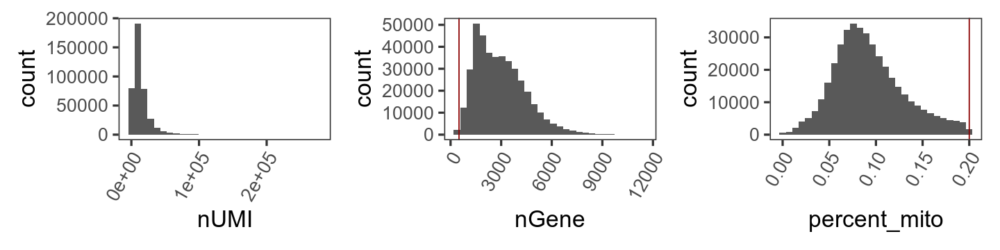

In [14]:
# QC
meta_all <- subset(meta_all, nGene > 500 & percent_mito < 0.2)
dim(meta_all)
table(meta_all$sample)
mRNA_exprs <- mRNA_exprs[, meta_all$cell]

fig.size(3,12)
(ggplot(meta_all) +
    geom_histogram(aes(x = nUMI))) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              )+
(ggplot(meta_all) +
    geom_histogram(aes(x = nGene)) +
    geom_vline(xintercept = 500, col = "darkred")) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              ) +
(ggplot(meta_all) +
    geom_histogram(aes(x = percent_mito)) +
    geom_vline(xintercept = 0.2, col = "darkred")) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              )

## Save the post QC data

In [17]:
# saveRDS(mRNA_exprs, "qc_mRNA_exprs_2020-01-24.rds")
# saveRDS(meta_all, "qc_meta_all_2020-01-24.rds")

## Load the post QC data

In [4]:
mRNA_exprs <- readRDS("qc_mRNA_exprs_2020-01-24.rds")
meta_all <- readRDS("qc_meta_all_2020-01-24.rds")

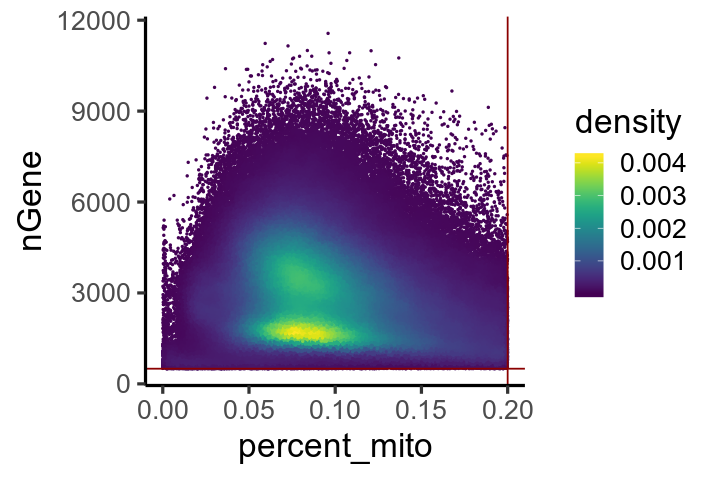

In [7]:
library(MASS)
get_density <- function(x, y, ...) {
    dens <- MASS::kde2d(x, y, ...)
    ix <- findInterval(x, dens$x)
    iy <- findInterval(y, dens$y)
    ii <- cbind(ix,iy)
    return(dens$z[ii])
}
plot_dens <- get_density(meta_all$percent_mito, meta_all$nGene, n = 100)
fig.size(4,6)
ggplot(meta_all, aes(x = percent_mito, y = nGene, color = plot_dens)) +
    geom_point(size = .3) +
    geom_hline(yintercept = 500, color = "darkred") +
    geom_vline(xintercept = .2, color = "darkred") +
    scale_color_viridis() +
    labs(color = "density") +
#     coord_cartesian(xlim = c(0, 1), ylim = c(0,12000)) + 
    theme_classic(base_size = 20) +
    theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

In [40]:
temp <- as.data.frame(table(meta_all$sample))
sample_order <- temp[order(temp$Freq, decreasing = T),]
sample_order[1:4,]
s10000 <- as.character(sample_order[which(sample_order$Freq > 10000),]$Var1)
s5000 <-as.character(sample_order[which(sample_order$Freq > 5000 & sample_order$Freq < 10001),]$Var1)
s1000 <-as.character(sample_order[which(sample_order$Freq > 1000 & sample_order$Freq < 5001),]$Var1)
s100 <- as.character(sample_order[which(sample_order$Freq < 1001),]$Var1)

,Var1,Freq
,<fct>,<int>
38,BRI-517,13932
24,BRI-462,13342
23,BRI-460,12618
74,BRI-615,12194


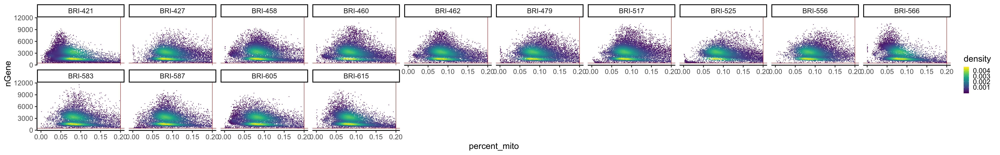

In [38]:
test <- meta_all[which(meta_all$sample %in% s10000),]
plot_dens <- get_density(test$percent_mito, test$nGene, n = 100)

fig.size(7,45)
ggplot(test, 
    aes(x = percent_mito, y = nGene, color = plot_dens)
      ) +
    geom_point(size = .3) +
    geom_hline(yintercept = 500, color = "darkred") +
    geom_vline(xintercept = .2, color = "darkred") +
    facet_wrap(sample ~ . , ncol = 10) +
    scale_color_viridis() +
    labs(color = "density") +
    theme_classic(base_size = 28) +
    theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

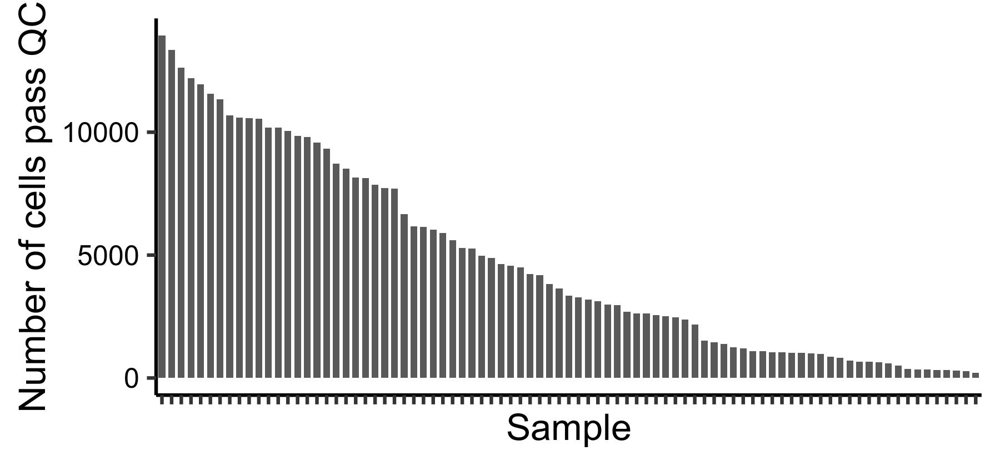

In [147]:
temp <- as.data.frame(table(meta_all$sample))
sample_order <- temp[order(temp$Freq, decreasing = T),]

# Barplot of cell number
options(repr.plot.height = 7, repr.plot.width = 15)
ggplot(data=sample_order, aes(x=reorder(Var1, -Freq), y=Freq)) +
  geom_bar(stat="identity", width = 0.7) +
  labs(x = "Sample", y = "Number of cells pass QC") +
  theme_classic(base_size = 40) +
  theme(
    legend.position = "none",
    axis.text.x = element_blank(),
#     axis.ticks = element_blank(),
#     axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 20),
    axis.text.y = element_text(color = "black", size = 30),
    panel.grid = element_blank()
  )

[1] TRUE

,sample,before_qc,after_qc,percent,p_badcells
39,BRI-521,2347,714,0.3042182,0.6957818
40,BRI-523,17866,5903,0.3304041,0.6695959
43,BRI-529,9606,3635,0.3784093,0.6215907
85,BRI-637R,1225,634,0.5175510,0.4824490


,sample,before_qc,after_qc,percent,p_badcells
39,BRI-521,2347,714,0.3042182,0.6957818
40,BRI-523,17866,5903,0.3304041,0.6695959
43,BRI-529,9606,3635,0.3784093,0.6215907
85,BRI-637R,1225,634,0.5175510,0.4824490


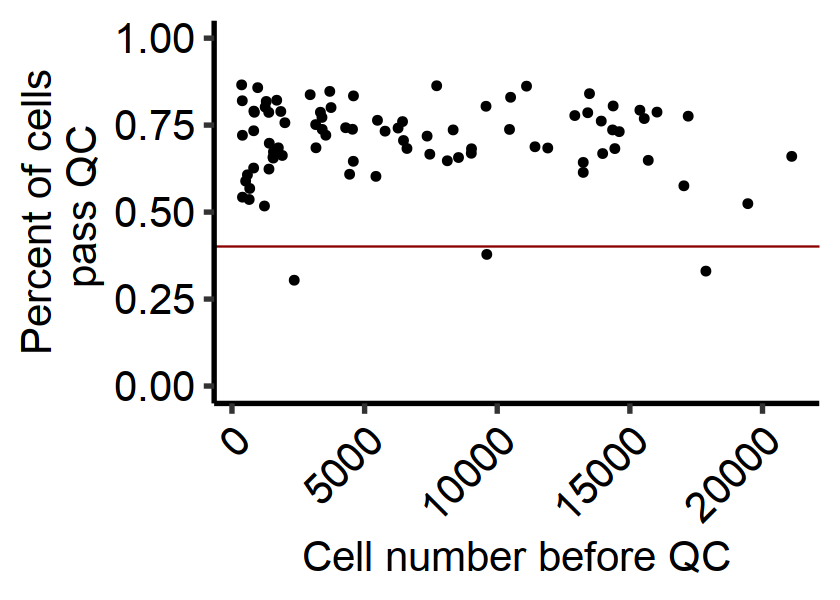

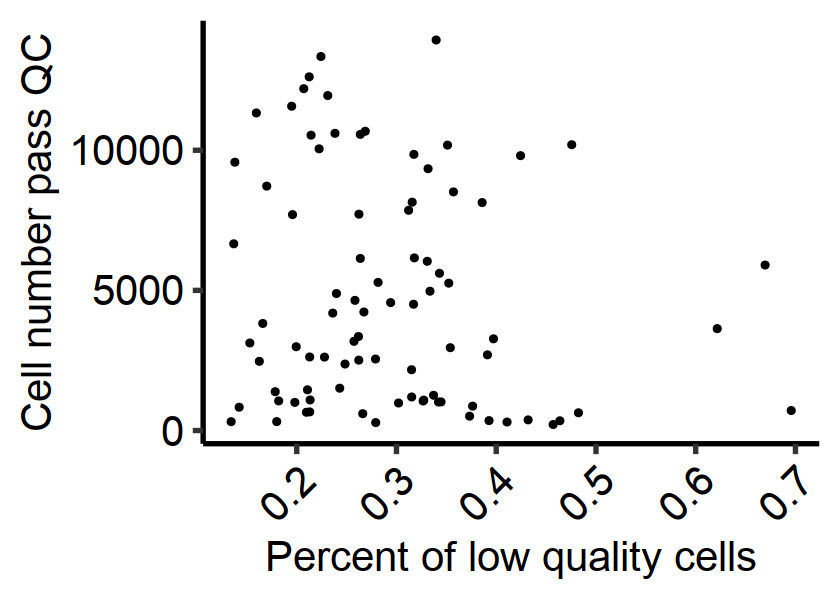

In [16]:
## Samples with lower cell number post-QC are the ones with lower quality
meta_all_before <- readRDS("meta_all_2020-01-24.rds")
meta_all_after <- readRDS("qc_pca_harmony_umap_meta_all_2020-01-25.rds")

# Percent of cell 

before <- as.data.frame(table(meta_all_before$sample))
after <- as.data.frame(table(meta_all_after$sample))
all(before$Var1 == after$Var1)

qc = data.frame(
    sample = as.character(before$Var1),
    before_qc = before$Freq,
    after_qc = after$Freq
)
qc$percent <- qc$after_qc / qc$before_qc
qc$p_badcells = (qc$before_qc - qc$after_qc)/qc$before_qc
qc[order(qc$percent, decreasing = F),][1:4,]
qc[order(qc$p_badcells, decreasing = T),][1:4,]

options(repr.plot.height = 5, repr.plot.width = 7)
ggplot(data=qc, 
       aes(x=before_qc, y=percent)
      ) +
    geom_point(size = 2 ) +
    geom_hline(yintercept = .4, color = "darkred") +
  coord_cartesian(ylim = c(0, 1)) +
#   geom_bar(stat="identity", width = 0.7) +
  labs(x = "Cell number before QC", y = "Percent of cells\n pass QC") +
  theme_classic(base_size = 25) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 25),
    axis.text.y = element_text(color = "black", size = 25),
    panel.grid = element_blank()
  )
ggsave(file = paste("sample_qc_1", ".pdf", sep = ""), width = 7, height = 5, dpi = 300)


ggplot(data=qc, 
       aes(x=p_badcells, y=after_qc)
      ) +
    geom_point() +
#     geom_hline(yintercept = .7, color = "darkred") +
#   geom_bar(stat="identity", width = 0.7) +
  labs(x = "Percent of low quality cells", y = "Cell number pass QC") +
  theme_classic(base_size = 25) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 25),
    axis.text.y = element_text(color = "black", size = 25),
    panel.grid = element_blank()
  )

[1] TRUE

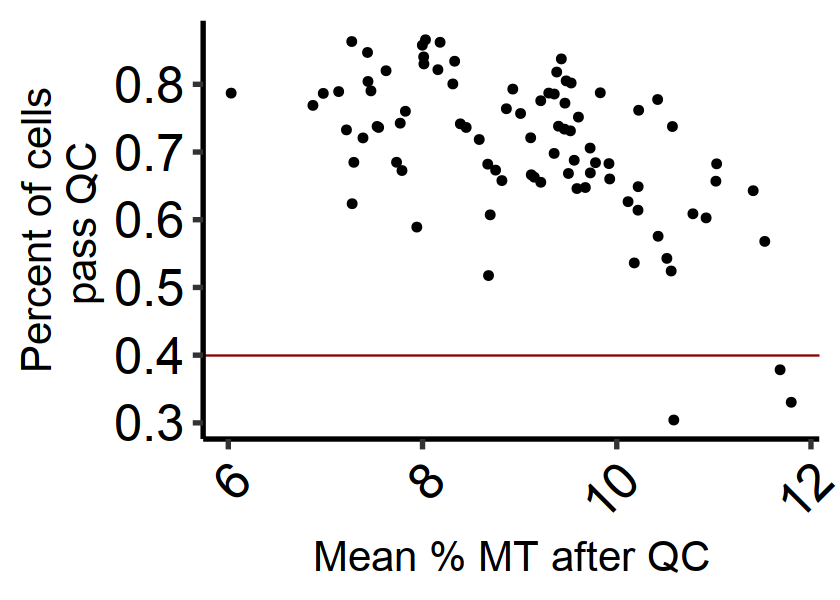

In [17]:
## Samples with lower cell number post-QC are the ones with lower quality
# meta_all_before <- readRDS("meta_all_2020-01-24.rds")
# meta_all_after <- readRDS("qc_pca_harmony_umap_meta_all_2020-01-25.rds")

temp1 <-  meta_all_after %>%
          group_by(sample) %>%
          summarize(mean_perc_mito = mean(percent_mito, na.rm = TRUE),
                    mean_perc_nGene = mean(nGene, na.rm = TRUE)
#                     n_cell = n(),
#                     n_low_per_mito = sum(percent_mito < 0.2),
#                     p_low_per_mito = n_low_per_mito / n_cell
                   )


all(temp1$sample == qc$sample)
temp1 <- cbind(qc, temp1)
temp1 <- temp1[, -5]


# Plot "percent of cells pass QC" vs "average % MT genes for that sample"
options(repr.plot.height = 5, repr.plot.width = 7)
ggplot(data=temp1, 
       aes(x=100 * mean_perc_mito, y=percent)
      ) +
    geom_point( size = 2 ) +
    geom_hline(yintercept = .4, color = "darkred") +
#   geom_bar(stat="identity", width = 0.7) +
  labs(x = "Mean % MT after QC", y = "Percent of cells\n pass QC") +
  theme_classic(base_size = 25) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 30),
    axis.text.y = element_text(color = "black", size = 30),
    panel.grid = element_blank()
  )
ggsave(file = paste("sample_qc_2", ".pdf", sep = ""), width = 7, height = 5, dpi = 300)

# ggplot(data=temp1, 
#        aes(x=p_low_per_mito, y=percent)
#       ) +
#     geom_point() +
#     geom_hline(yintercept = .7, color = "darkred") +
# #   geom_bar(stat="identity", width = 0.7) +
# #   labs(x = "Mean % MT before QC", y = "Percent of cells\n pass QC") +
#   theme_classic(base_size = 30) +
#   theme(
#     legend.position = "none",
# #     axis.text = element_blank(),
# #     axis.ticks = element_blank(),
#     axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 30),
#     axis.text.y = element_text(color = "black", size = 30),
#     panel.grid = element_blank()
#   )

# # ggplot(data=temp1, 
# #        aes(x=mean_perc_nGene, y=percent)
# #       ) +
# #     geom_point() +
# #     geom_hline(yintercept = .7, color = "darkred") +
# # #   geom_bar(stat="identity", width = 0.7) +
# # #   labs(x = "Cell number before QC", y = "Percent of cells\n pass QC") +
# #   theme_classic(base_size = 30) +
# #   theme(
# #     legend.position = "none",
# # #     axis.text = element_blank(),
# # #     axis.ticks = element_blank(),
# #     axis.text.x = element_text(color = "black", angle = 45, hjust = 1, size = 30),
# #     axis.text.y = element_text(color = "black", size = 30),
# #     panel.grid = element_blank()
# #   )

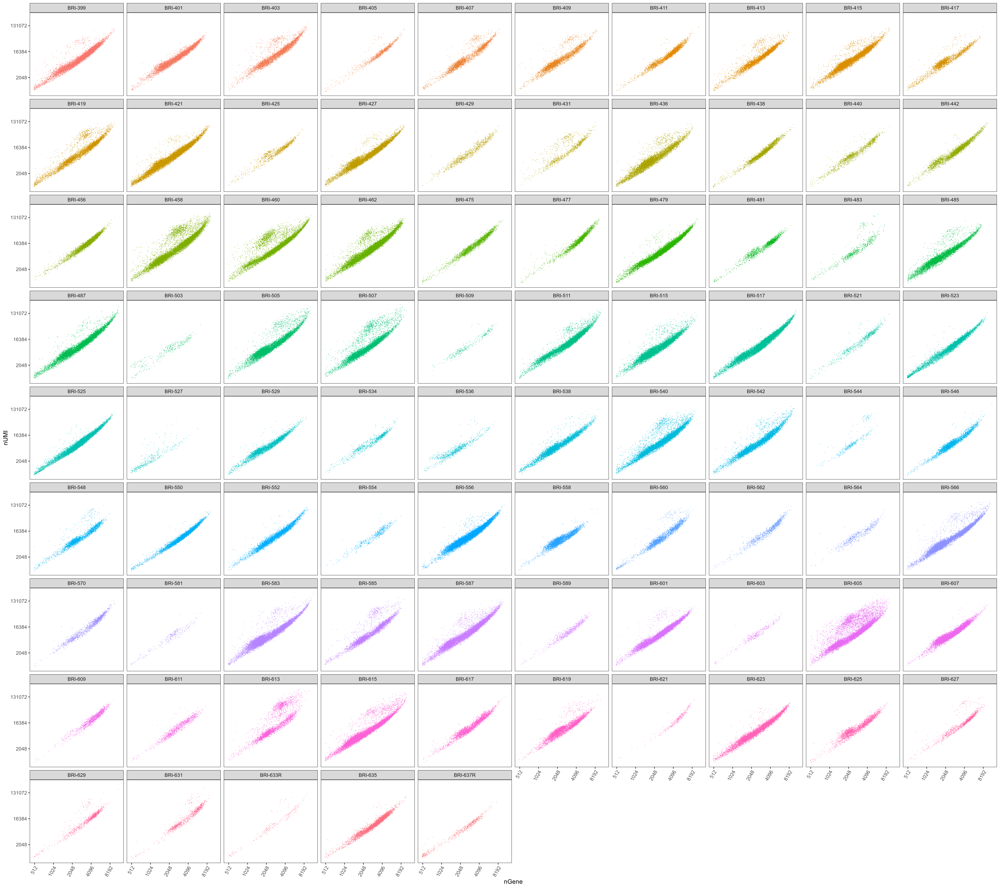

In [35]:
fig.size(40,45)

ggplot() +
    geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "nGene", y = "nUMI", fill = "sample"),
    size = 0.7, stroke = 0.01, shape = 21
    ) +    
    facet_wrap( ~ sample, ncol = 10) +
    scale_x_continuous(trans = "log2") + 
    scale_y_continuous(trans = "log2") + 
    guides(col = FALSE) +
        theme_bw(base_size = 20) +
        theme(text = element_text(size = 20),
            legend.position = "none",
    #         axis.text = element_blank(),
    #         axis.ticks = element_blank(),
            panel.grid = element_blank(),
          axis.text.x = element_text(angle = 60, hjust = 1)
              )

In [15]:
## Ribosomal reads
genes_ribo <- grep("^RPS\\d+|^RPL\\d+", row.names(mRNA_exprs), value = TRUE)
length(genes_ribo)
meta_all$percent.ribo <- Matrix::colSums(mRNA_exprs[genes_ribo, meta_all$cell]) / 
                                        Matrix::colSums(mRNA_exprs[, meta_all$cell])

[1] 100

In [16]:
## Normalize
exprs_norm <- mRNA_exprs %>% NormalizeDataSeurat()
dim(exprs_norm)
saveRDS(exprs_norm, "mRNA_exprs_norm_2020-01-24.rds")

# Find varible genes
genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 0.7e3)

nrow(vargenes_df)
table(vargenes_df$N)
var_genes <- vargenes_df$gene
head(var_genes)

exprs_scaled <- exprs_norm[var_genes, ] %>% ScaleDataSeurat() 
exprs_cosine <- exprs_scaled %>% cosine_normalize(2)

[1]  33538 403596

In [10]:
# PCA for top 20 PCs
pca_res <- irlba::prcomp_irlba(t(exprs_cosine), 20)
umap_res <- umap(pca_res$x, n_neighbors = 30, metric = "cosine", min_dist = .3)
meta_all$UMAP1 <- umap_res$layout[, 1]
meta_all$UMAP2 <- umap_res$layout[, 2]

In [13]:
meta_all <- cbind(meta_all, pca_res$x)
meta_all[1:4,]

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,⋯,-0.023782410,0.02014607,-0.002612597,-0.114616503,-0.09321071,0.016751547,-0.026468537,-0.071925509,-0.013562808,0.044665006
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,⋯,-0.057559679,-0.04534581,-0.009537267,-0.008953708,-0.08859925,0.001792422,0.013124503,0.022926293,0.101287338,-0.414311488
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,⋯,0.002326752,-0.01557515,-0.049214707,-0.064864437,-0.03625999,0.017270126,0.005430456,-0.107591652,-0.001496217,0.077471782
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,⋯,-0.037175904,-0.09064106,-0.204887165,0.129006267,-0.05470159,0.112012283,0.006601404,-0.001725609,-0.014012232,0.006655405


In [8]:
# # Save the update meta_all
# saveRDS(meta_all, "qc_pca_umap_meta_all_2020-01-24.rds")

meta_all <- readRDS("qc_pca_umap_meta_all_2020-01-24.rds")
meta_all[1:4,]

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,⋯,-0.023782410,0.02014607,-0.002612597,-0.114616503,-0.09321071,0.016751547,-0.026468537,-0.071925509,-0.013562808,0.044665006
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,⋯,-0.057559679,-0.04534581,-0.009537267,-0.008953708,-0.08859925,0.001792422,0.013124503,0.022926293,0.101287338,-0.414311488
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,⋯,0.002326752,-0.01557515,-0.049214707,-0.064864437,-0.03625999,0.017270126,0.005430456,-0.107591652,-0.001496217,0.077471782
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,⋯,-0.037175904,-0.09064106,-0.204887165,0.129006267,-0.05470159,0.112012283,0.006601404,-0.001725609,-0.014012232,0.006655405


Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Harmony 1/30

Harmony 2/30

Harmony 3/30

Harmony 4/30

Harmony 5/30

Harmony 6/30

Harmony 7/30

Harmony 8/30

Harmony 9/30

Harmony 10/30

Harmony 11/30

Harmony 12/30

Harmony 13/30

Harmony 14/30

Harmony 15/30

Harmony 16/30

Harmony 1

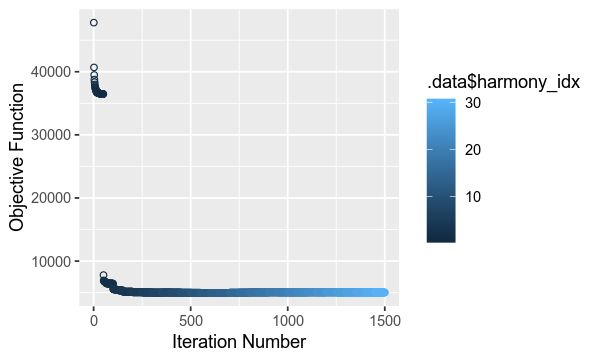

In [9]:
# Harmonization: sample and tissue 
options(repr.plot.height = 3, repr.plot.width = 5)
harmony <- HarmonyMatrix(# pca_res$x, meta_all, do_pca=FALSE, 
                         meta_all[, c(9:28)], meta_all, do_pca=FALSE, 
                         "sample", theta = 2,
                         # lambda = 1, # Not sure what lambda affects
                         # tau = 10, 
                         epsilon.cluster = -Inf,
                         epsilon.harmony = -Inf,
                         max.iter.cluster = 50,
                         max.iter.harmony = 30,
                         plot_convergence = T)

In [10]:
colnames(harmony) <- paste0("harmonized_", colnames(harmony), sep="")
meta_all <- cbind(meta_all, harmony)
# Save the update meta_all
saveRDS(meta_all, "qc_pca_harmony_meta_all_2020-01-24.rds")

In [11]:
# UMAP with top 20 PCs
umap_res <- umap(harmony[, c(1:20)], n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_UMAP2 <- umap_res$layout[, 2]
meta_all[1:4,]

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,harmonized_PC13,harmonized_PC14,harmonized_PC15,harmonized_PC16,harmonized_PC17,harmonized_PC18,harmonized_PC19,harmonized_PC20,harmonized_UMAP1,harmonized_UMAP2
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,⋯,-0.002850743,-0.077324210,-0.056753212,0.0252208036,-0.042332082,-0.01766654,-0.0004747563,-0.005633132,11.135468,-0.7312793
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,⋯,0.001328416,-0.003706535,-0.083106743,-0.0007857185,0.005573716,0.02676186,0.0956605894,-0.356151813,2.863655,-10.3395105
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,⋯,-0.049297706,-0.031875093,-0.003280377,0.0278151578,-0.012838638,-0.05469046,0.0117411423,0.027152254,10.381248,-1.9383886
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,⋯,-0.134523139,0.086668640,-0.041117325,0.0601768633,-0.008440295,-0.02368517,-0.0036981598,-0.004332571,1.240208,2.9091845


In [15]:
# # Save the update meta_all
# saveRDS(meta_all, "qc_pca_harmony_umap_meta_all_2020-01-25.rds")
meta_all <- readRDS("qc_pca_harmony_umap_meta_all_2020-01-25.rds")

In [35]:
library(parallel)

# Louvain
snn_pcs <- BuildSNNSeurat(meta_all[, c(29:48)], nn.eps = .5)

resolution_list <- c(0.2, 0.4, 0.6, 0.8, 1.0)
ids_cos <- Reduce(cbind, mclapply(resolution_list, function(res_use) {
    Seurat:::RunModularityClustering(SNN = snn_pcs, modularity = 1, 
        resolution = res_use, algorithm = 3, n.start = 10, 
        n.iter = 10, random.seed = 0, print.output = FALSE, 
        temp.file.location = NULL, edge.file.name = NULL)    
}, mc.cores = min(16, length(resolution_list))))
ids_cos %<>% data.frame()
colnames(ids_cos) <- sprintf("res_%.2f", resolution_list)

meta_all$res_0.20 <- ids_cos$res_0.20
meta_all$res_0.40 <- ids_cos$res_0.40
meta_all$res_0.60 <- ids_cos$res_0.60
meta_all$res_0.80 <- ids_cos$res_0.80
meta_all$res_1.00 <- ids_cos$res_1.00

# saveRDS(meta_all, "qc_pca_harmony_umap_clus_meta_all_2020-02-18.rds")

In [6]:
meta_all <- readRDS("qc_pca_harmony_umap_clus_meta_all_2020-02-18.rds")

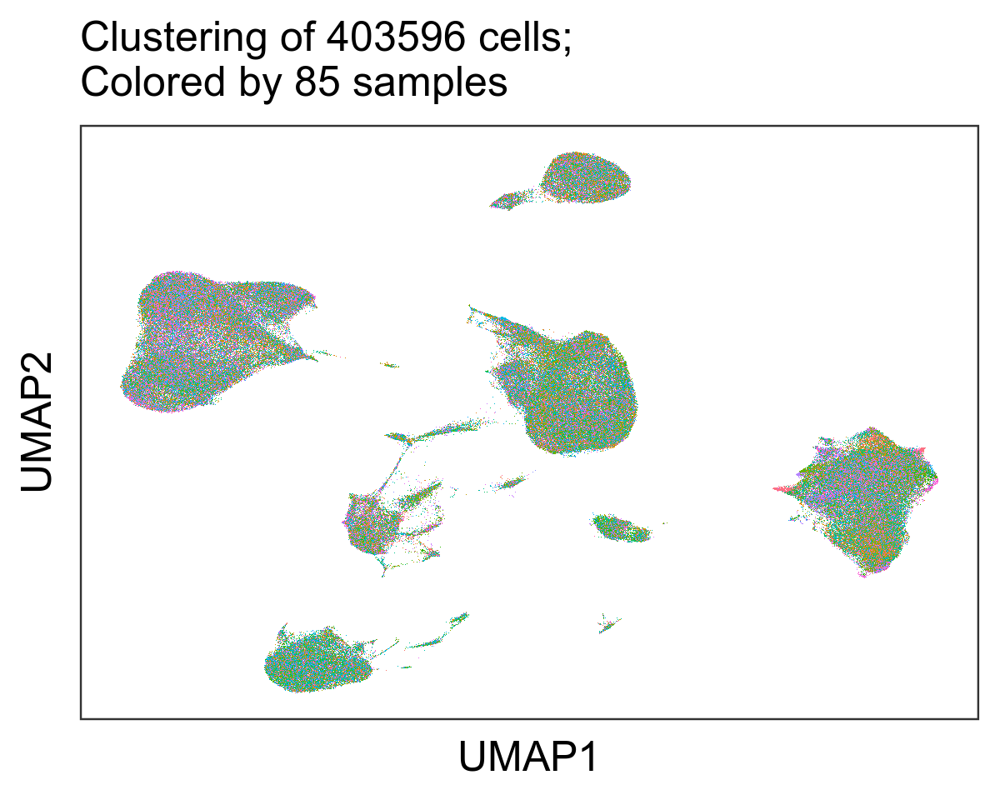

In [27]:
options(repr.plot.height = 8, repr.plot.width = 10)
ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "harmonized_UMAP1	", y = "harmonized_UMAP2", fill = "sample"),
    size = 0.2, stroke = 0.0001, shape = 21
  ) +
#   scale_fill_manual(values = meta_colors$sample, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = paste0("Clustering of ", nrow(meta_all),  " cells; \nColored by ", nrow(as.data.frame(table(meta_all$sample))),  " samples")
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

In [26]:
clin_meta <- readRDS("clin_meta_2020-01-26.rds")
Cedars <- table(clin_meta$site, clin_meta$mRNA_run)[1,]
Cedars <- names(Cedars[which(Cedars == 1)])

Columbia <- table(clin_meta$site, clin_meta$mRNA_run)[2,]
Columbia <- names(Columbia[which(Columbia == 1)])

Feinstein <- table(clin_meta$site, clin_meta$mRNA_run)[3,]
Feinstein <- names(Feinstein[which(Feinstein == 1)])
length(Feinstein)

HSS <- table(clin_meta$site, clin_meta$mRNA_run)[4,]
HSS <- names(HSS[which(HSS == 1)])

Northwestern <- table(clin_meta$site, clin_meta$mRNA_run)[5,]
Northwestern <- names(Northwestern[which(Northwestern == 1)])

UAB <- table(clin_meta$site, clin_meta$mRNA_run)[6,]
UAB <- names(UAB[which(UAB == 1)])
length(UAB)

UC_San_Diego <- table(clin_meta$site, clin_meta$mRNA_run)[7,]
UC_San_Diego <- names(UC_San_Diego[which(UC_San_Diego == 1)])

UK_Birmingham <- table(clin_meta$site, clin_meta$mRNA_run)[8,]
UK_Birmingham <- names(UK_Birmingham[which(UK_Birmingham == 1)])

UK_London <- table(clin_meta$site, clin_meta$mRNA_run)[9,]
UK_London <- names(UK_London[which(UK_London == 1)])

Colorado <- table(clin_meta$site, clin_meta$mRNA_run)[10,]
Colorado <- names(Colorado[which(Colorado == 1)])

Pittsburgh <- table(clin_meta$site, clin_meta$mRNA_run)[11,]
Pittsburgh <- names(Pittsburgh[which(Pittsburgh == 1)])
length(Pittsburgh)

Rochester <- table(clin_meta$site, clin_meta$mRNA_run)[12,]
Rochester <- names(Rochester[which(Rochester == 1)])


meta_all$site <- meta_all$sample
meta_all$site[which(meta_all$site %in% Cedars)] <- "Cedars"
meta_all$site[which(meta_all$site %in% Columbia)] <- "Columbia"
meta_all$site[which(meta_all$site %in% Feinstein)] <- "Feinstein"
meta_all$site[which(meta_all$site %in% HSS)] <- "HSS"
meta_all$site[which(meta_all$site %in% Northwestern)] <- "Northwestern"
meta_all$site[which(meta_all$site %in% UAB)] <- "UAB"
meta_all$site[which(meta_all$site %in% UC_San_Diego)] <- "UC_San_Diego"
meta_all$site[which(meta_all$site %in% UK_Birmingham)] <- "UK_Birmingham"
meta_all$site[which(meta_all$site %in% UK_London)] <- "UK_London"
meta_all$site[which(meta_all$site %in% Colorado)] <- "Colorado"
meta_all$site[which(meta_all$site %in% Pittsburgh)] <- "Pittsburgh"
meta_all$site[which(meta_all$site %in% Rochester)] <- "Rochester"
meta_all$site[which(meta_all$site %in% "BRI-548")] <- "Rochester"
meta_all$site[which(meta_all$site %in% "BRI-552")] <- "Feinstein"
meta_all$site[which(meta_all$site %in% "BRI-581")] <- "UAB"
table(meta_all$site)

# saveRDS(meta_all, "qc_pca_harmony_umap_meta_all_site_2020-01-25.rds")

[1] 1

[1] 2

[1] 9


       Cedars      Colorado      Columbia     Feinstein           HSS 
        19684         13427         35301          4190         74262 
 Northwestern    Pittsburgh     Rochester           UAB  UC_San_Diego 
        11490         40966         15984          2904         70837 
UK_Birmingham     UK_London 
        86364         28187 

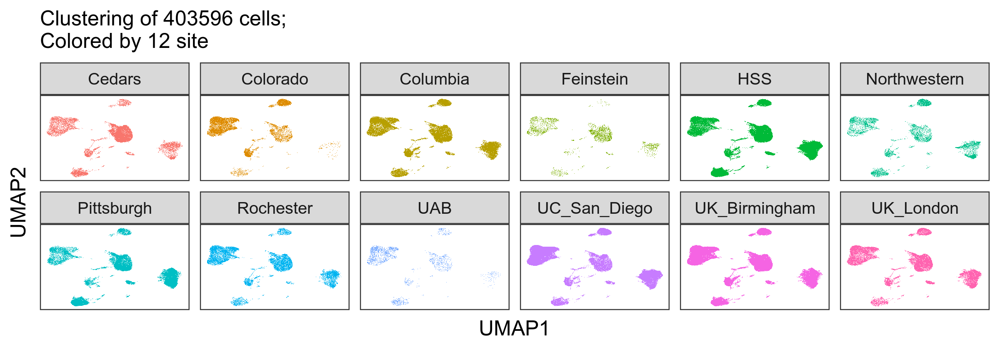

In [120]:
options(repr.plot.height = 7, repr.plot.width = 20)
ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "site"),
    size = 0.07, stroke = 0.0001, shape = 21
  ) +
  facet_wrap(site ~ ., ncol = 6) +
#   scale_fill_manual(values = meta_colors$sample, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = paste0("Clustering of ", nrow(meta_all),  " cells; \nColored by ", nrow(as.data.frame(table(meta_all$site))),  " site")
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

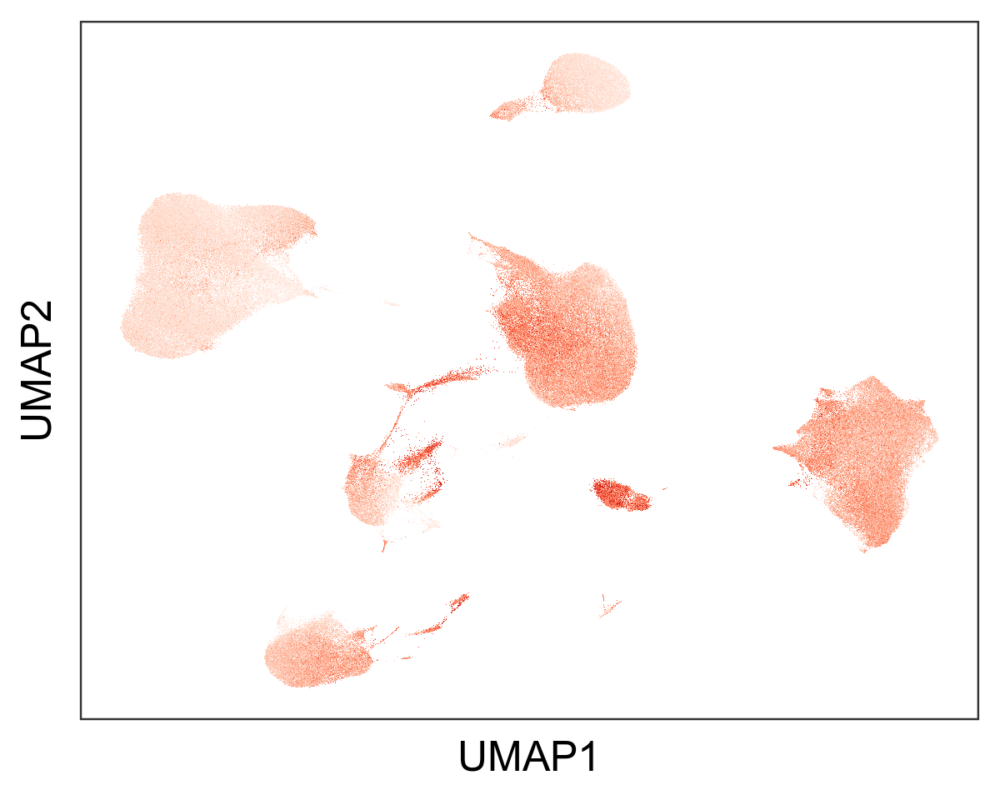

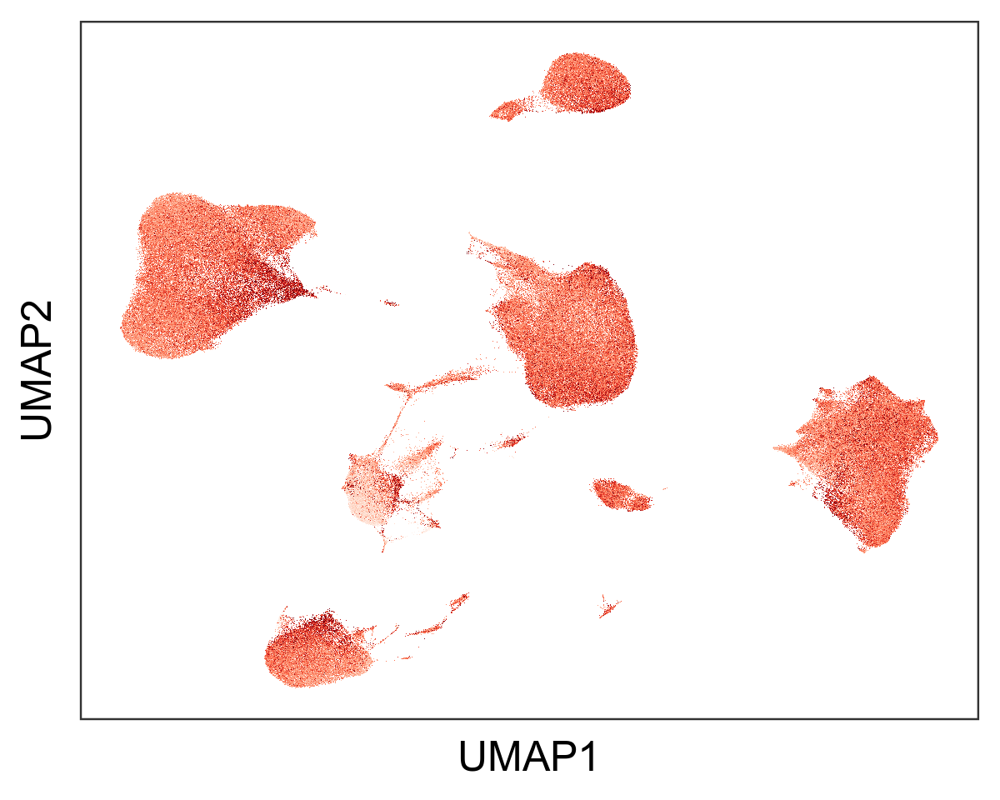

In [30]:
options(repr.plot.height = 8, repr.plot.width = 10)
ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "nGene"),
    size = 0.1, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Reds"))(7)[1:7],
      name = "nUMI"
  ) +
  labs(
      x = "UMAP1",
      y = "UMAP2"
  ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "percent_mito"),
    size = 0.1, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Reds"))(7)[1:7],
      name = "nUMI"
  ) +
  labs(
      x = "UMAP1",
      y = "UMAP2"
  ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

# QC the protein data

In [129]:
# Load the pre-QC mRNA cells
meta_all <- readRDS("qc_pca_harmony_umap_meta_all_2020-01-25.rds")

In [130]:
adt_exprs <- readRDS("adt_exprs_2020-01-24.rds")
adt_exprs <- adt_exprs[, meta_all$cell]
all(colnames(adt_exprs) == meta_all$cell)
dim(adt_exprs)

[1] TRUE

[1]     58 403596

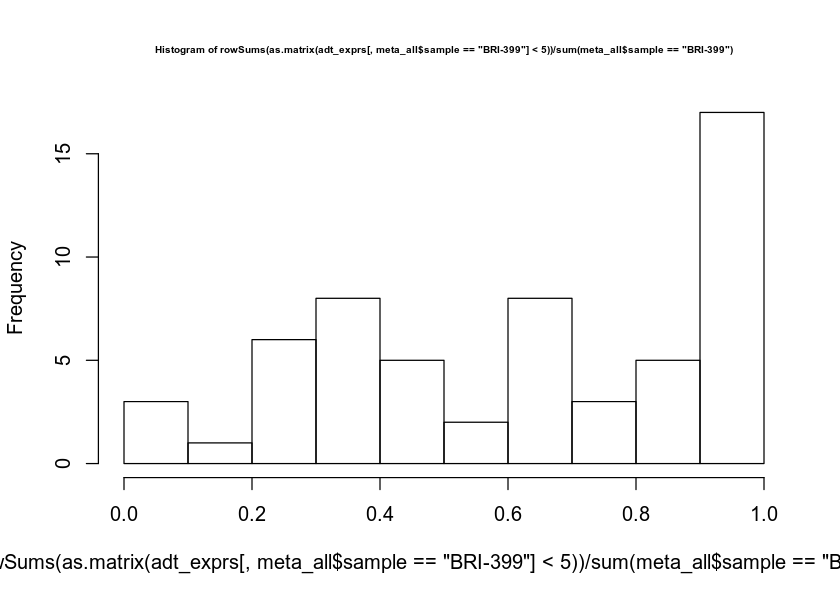

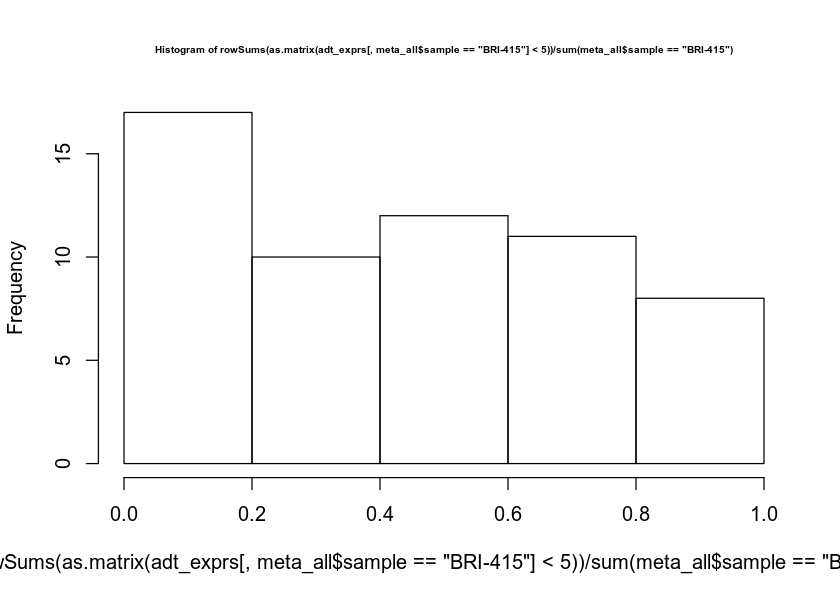

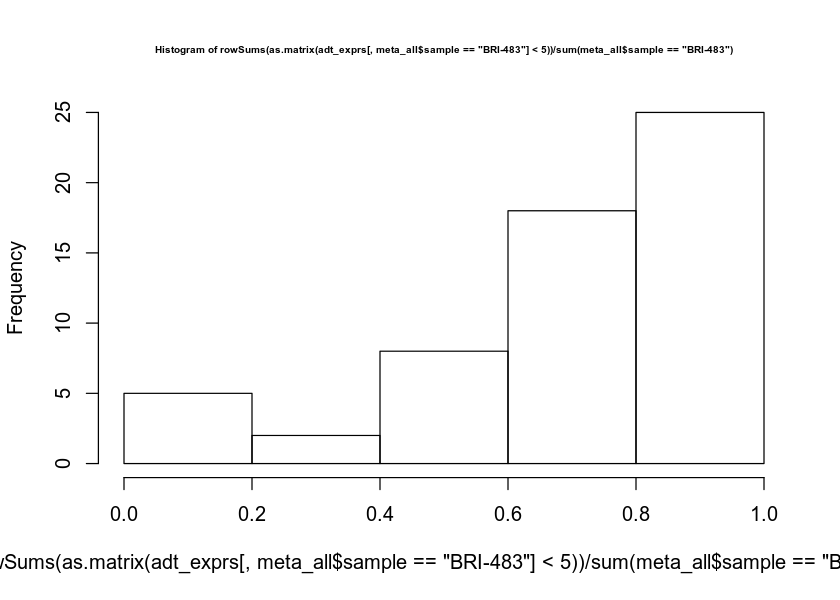

In [44]:
fig.size(5,7)
hist(rowSums(as.matrix(adt_exprs[, meta_all$sample == "BRI-399"] < 5))/sum(meta_all$sample == "BRI-399"), cex.main=0.5, cex.sub=0.5)
hist(rowSums(as.matrix(adt_exprs[, meta_all$sample == "BRI-415"] < 5))/sum(meta_all$sample == "BRI-415"), cex.main=0.5, cex.sub=0.5)
hist(rowSums(as.matrix(adt_exprs[, meta_all$sample == "BRI-483"] < 5))/sum(meta_all$sample == "BRI-483"), cex.main=0.5, cex.sub=0.5)

In [10]:
# Why normalizeCLR_dgc for protein data?

# adt_exprs_norm <- adt_exprs %>% singlecellmethods::normalizeData(method = "cellCLR")
# saveRDS(adt_exprs_norm, "adt_exprs_norm_2020-01-25.rds")

adt_exprs_norm <- readRDS("adt_exprs_norm_2020-01-25.rds")
dim(adt_exprs_norm)

[1]     58 403596

In [9]:
?normalizeCLR_dgc

No documentation for ‘normalizeCLR_dgc’ in specified packages and libraries:
you could try ‘??normalizeCLR_dgc’

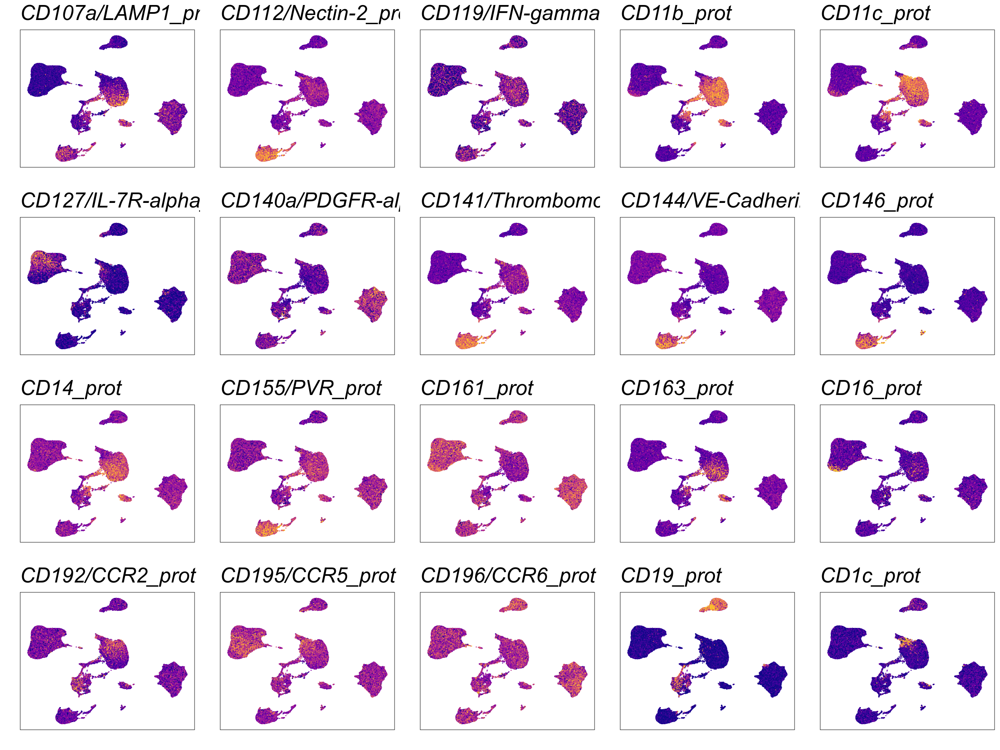

In [11]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[1:20]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

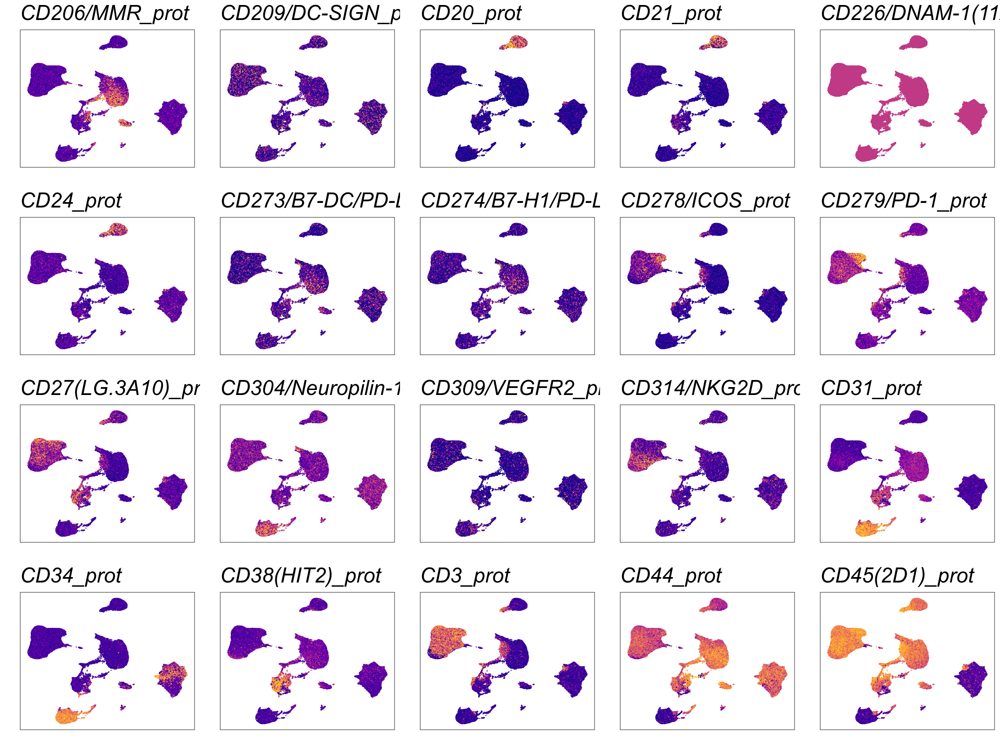

In [57]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[21:40]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

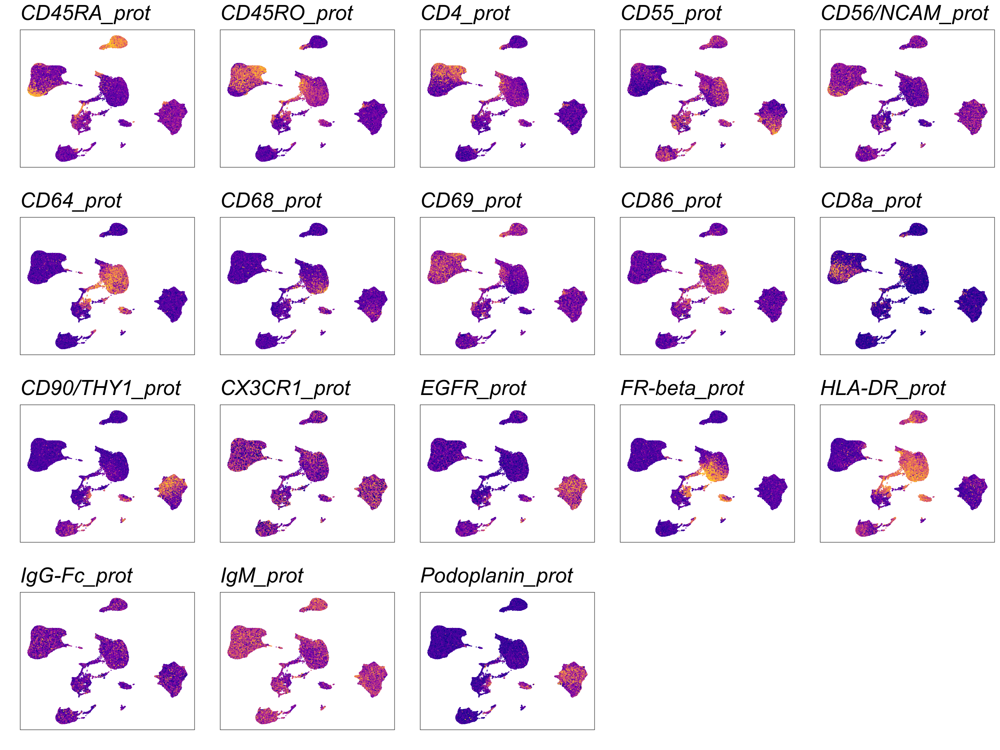

In [58]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[41:nrow(adt_exprs)]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

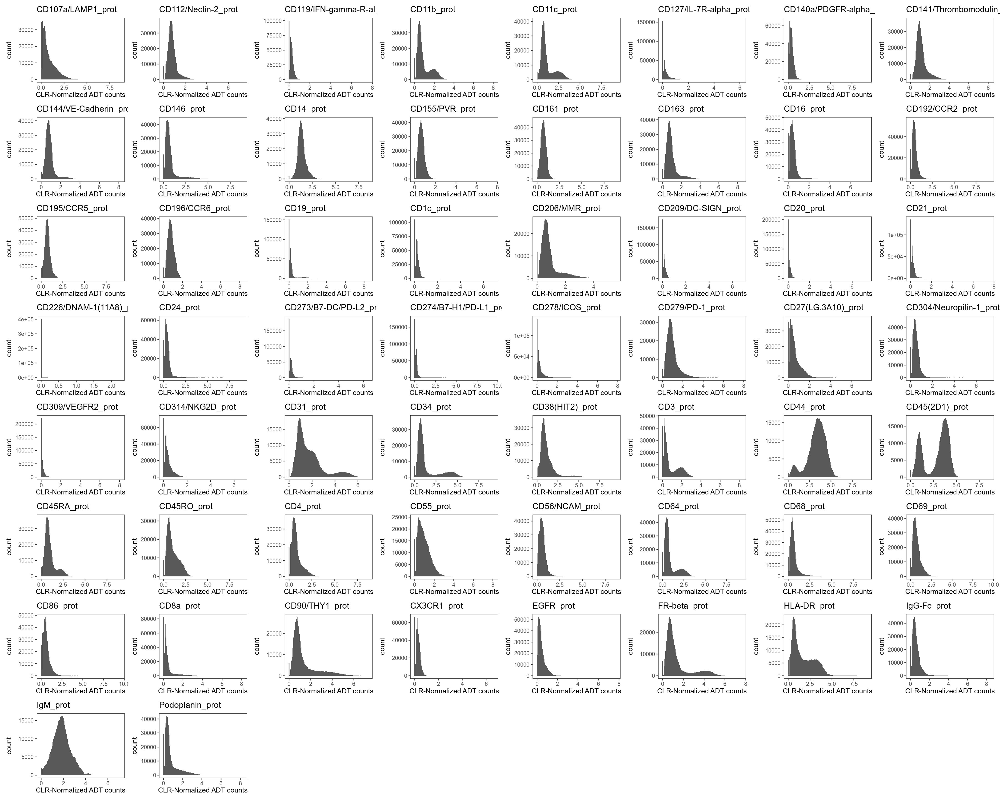

In [111]:
# Histograms of normalized, unfiltered expression for each protein marker
options(repr.plot.height = 24, repr.plot.width = 30)
Reduce(`+`, lapply(which(rowSums(adt_exprs_norm > 0) > 0), function(x) {
    ggplot(as.data.frame(adt_exprs_norm[x,]), aes(adt_exprs_norm[x,])) +
        geom_histogram(binwidth = max(adt_exprs_norm[x,])/100) +
        labs(title=row.names(adt_exprs_norm)[x], x = "CLR-Normalized ADT counts") +
        theme_bw(base_size = 15)+
        theme(
#             axis.text = element_blank(),
#             axis.ticks = element_blank(),
            panel.grid = element_blank(),
            legend.position = "none"
          )
}))

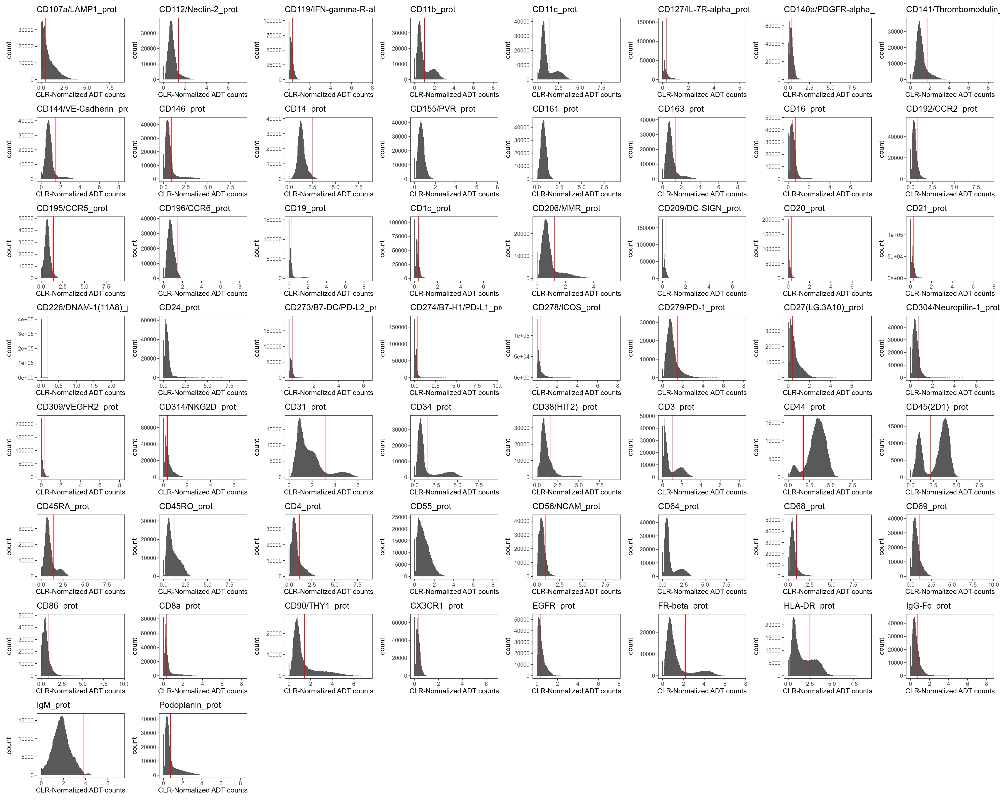

In [140]:
# Histograms of normalized, unfiltered expression for each protein marker
options(repr.plot.height = 24, repr.plot.width = 30)
Reduce(`+`, lapply(which(rowSums(adt_exprs_norm > 0) > 0), function(x) {
    ggplot(as.data.frame(adt_exprs_norm[x,]), aes(adt_exprs_norm[x,])) +
        geom_histogram(binwidth = max(adt_exprs_norm[x,])/100) +
        geom_vline(xintercept = shift_factor[x], color = "red") + 
        labs(title=row.names(adt_exprs_norm)[x], x = "CLR-Normalized ADT counts") +
        theme_bw(base_size = 15)+
        theme(
#             axis.text = element_blank(),
#             axis.ticks = element_blank(),
            panel.grid = element_blank(),
            legend.position = "none"
          )
}))

# Protein-specific QC

In [139]:
shift_factor <- apply(adt_exprs_norm, 1, function(x) {
    ## find the highest peak in the density histogram after 0, and multiply by 2 to find the end of the peak
    density(x[x > 0])$x[which.max(density(x[x > 0])$y)]*2
})

# manually adjust a couple markers' thresholds
shift_factor["CD31_prot"] <- 3.2
shift_factor["FR-beta_prot"] <- 2.2
shift_factor["HLA-DR_prot"] <- 2.4
shift_factor["CD3_prot"] <- 1
shift_factor["CD34_prot"] <- 1.55
shift_factor["CD45(2D1)_prot"] <- 2.2
shift_factor["CD44_prot"] <- 1.8
shift_factor["CD11b_prot"] <- 1
shift_factor["CD64_prot"] <- 1.1

# I don't know if this is necessary, but because I identified this threshold in normalized expression space, I reversed the normalization to get the equivalent thresholds in raw UMI count space
shift_mat <- (exp(shift_factor) - 1)
shift_mat <- as.matrix(shift_factor, ncol = 1) %*% t(as.matrix(apply(adt_exprs[,meta_all$cell], 2, function(x) {exp(sum(log(x + 1))/length(x))})))

# Subtracted filter thresholds
adt_exprs_norm_filter <- adt_exprs - shift_mat

# Set negatives to 0
adt_exprs_norm_filter[adt_exprs_norm_filter < 0] <- 0

# Re-normalize
adt_exprs_norm_filter <- singlecellmethods::normalizeData(adt_exprs_norm_filter, method = "cellCLR")

# Save the post-QC normalized protein expression
saveRDS(adt_exprs_norm_filter, "adt_exprs_norm_filter_2020-02-18.rds")

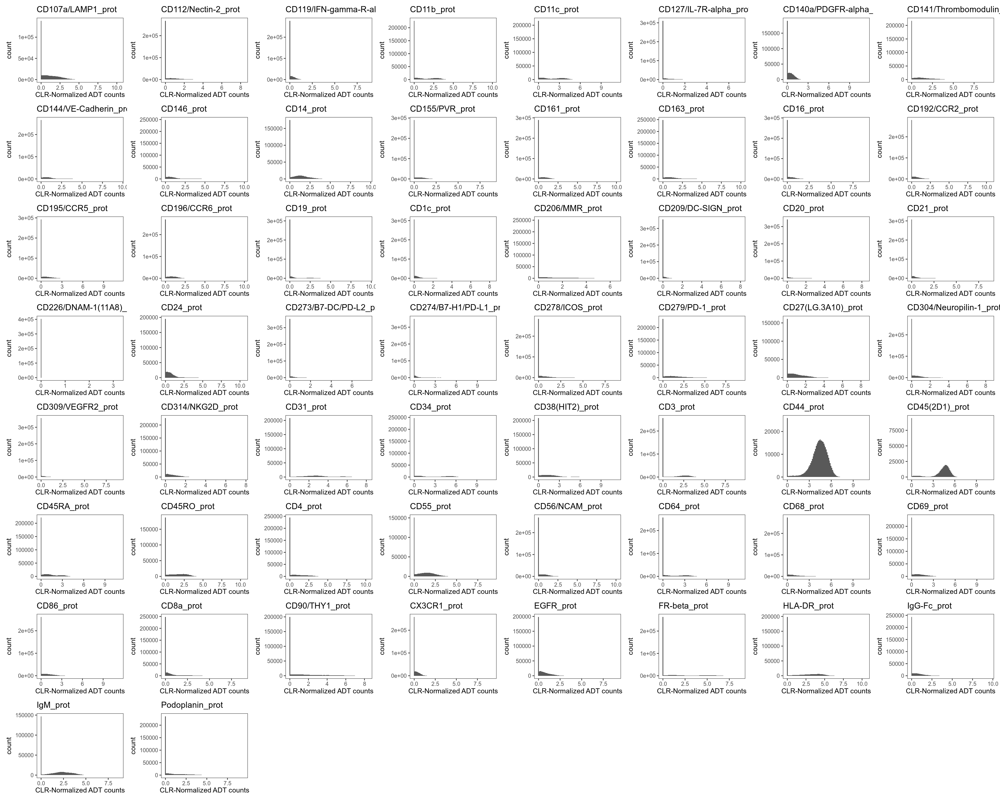

In [141]:
# Histograms of normalized, filtered expression for each protein marker
options(repr.plot.height = 24, repr.plot.width = 30)
Reduce(`+`, lapply(which(rowSums(adt_exprs_norm_filter > 0) > 0), function(x) {
    ggplot(as.data.frame(adt_exprs_norm_filter[x,]), aes(adt_exprs_norm_filter[x,])) +
        geom_histogram(binwidth = max(adt_exprs_norm_filter[x,])/100) +
        labs(title=row.names(adt_exprs_norm_filter)[x], x = "CLR-Normalized ADT counts") +
        theme_bw(base_size = 15)+
        theme(
#             axis.text = element_blank(),
#             axis.ticks = element_blank(),
            panel.grid = element_blank(),
            legend.position = "none"
          )
}))

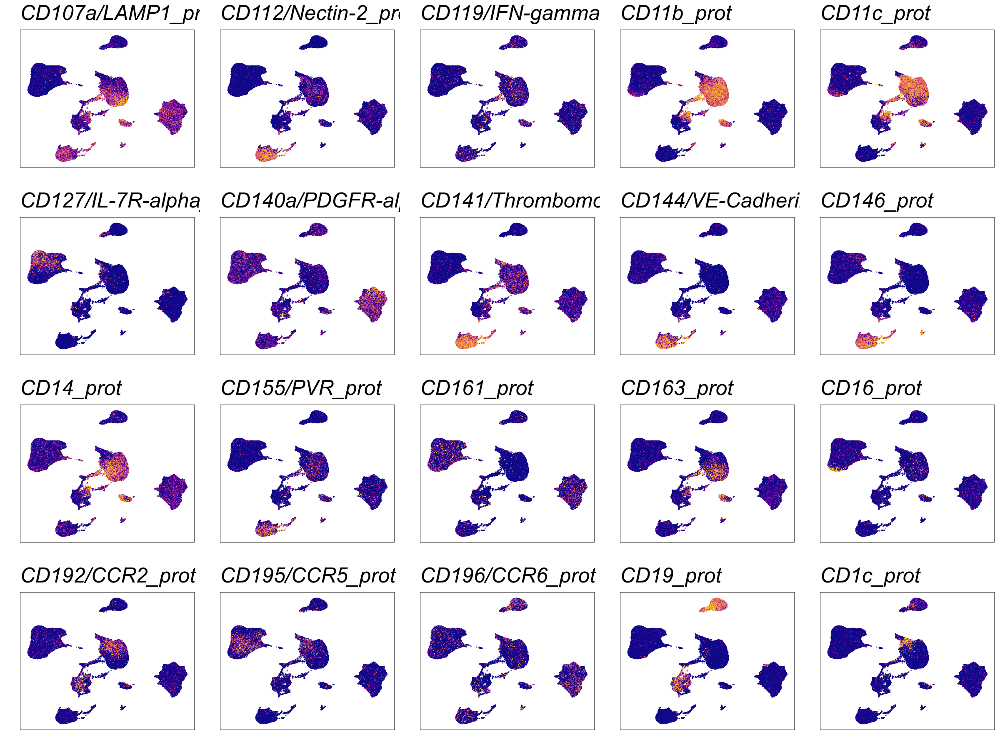

In [142]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[1:20]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm_filter[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm_filter[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm_filter[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

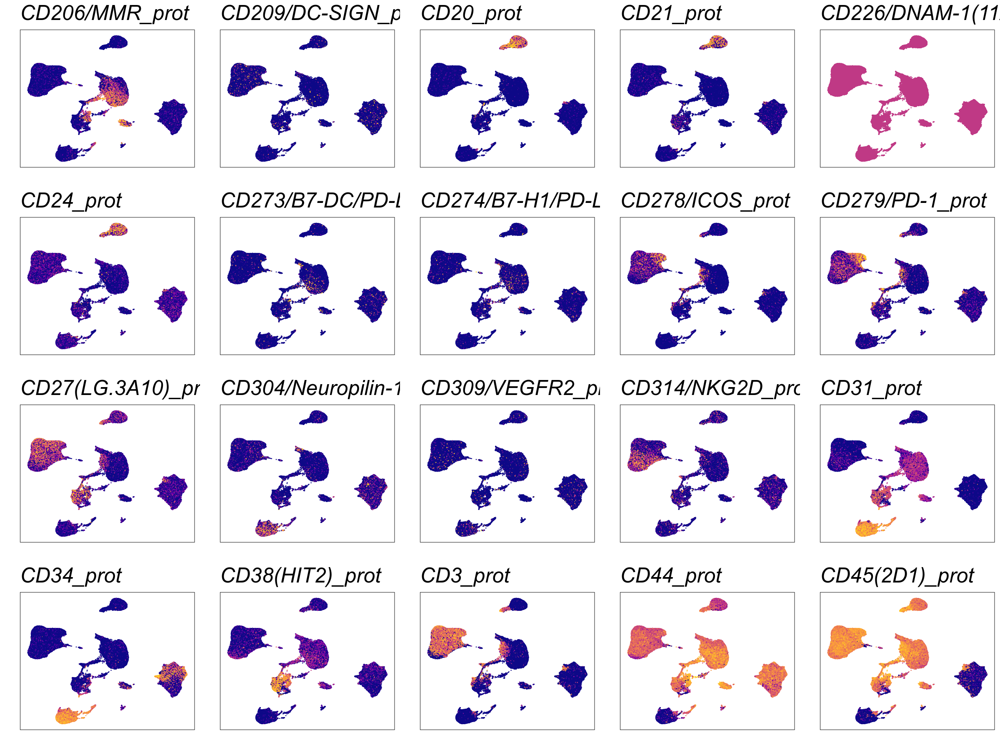

In [143]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[21:40]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm_filter[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm_filter[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm_filter[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

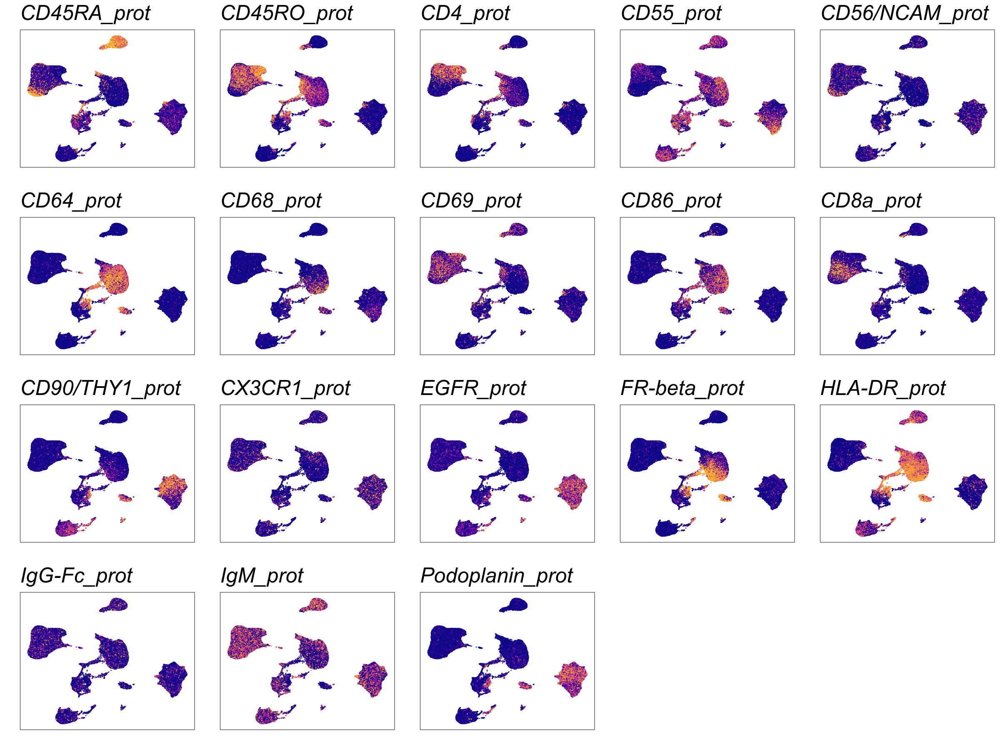

In [144]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs)[41:nrow(adt_exprs)]

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm_filter[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm_filter[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm_filter[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

In [39]:
# K-L divergence (with modification to prevent lowly expressed proteins from getting high KL-divergences)
# For each marker, comparing distributions:
# Test: distribution of cells across clusters with marker expression > 85th percentile of expression for that marker
# Null: Distribution of cells across clusters

library(entropy)
kl_div_cor_adt_mrna_nofilter <- sapply(1:nrow(adt_exprs_norm), function(ab_idx) {
    tmp <- factor(meta_all$res_0.80[adt_exprs_norm[ab_idx,] > quantile(adt_exprs_norm[ab_idx,], .85)])
    tmp <- factor(tmp, levels = c(levels(tmp), which(!names(table(meta_all$res_0.80)) %in% levels(tmp))-1))
    tmp.table <- table(tmp)[order(names(table(tmp)))]
    tst <- tmp.table/table(meta_all$res_0.80)[order(names(table(meta_all$res_0.80)))]
    tmp.table <- tmp.table + min(tst[tst > 0])*table(meta_all$res_0.80)[order(names(table(meta_all$res_0.80)))]
    freq1 <- tmp.table/sum(tmp.table)
    null.table <- table(meta_all$res_0.80)/sum(table(meta_all$res_0.80))
    freq2 <- null.table[order(names(null.table))]
    KL.plugin(freq1, freq2)
    })
names(kl_div_cor_adt_mrna_nofilter) <- row.names(adt_exprs_norm)

In [43]:
library(entropy)
kl_div_cor_adt_mrna_filter <- sapply(1:nrow(adt_exprs_norm_filter), function(ab_idx) {
    tmp <- factor(meta_all$res_0.80[adt_exprs_norm_filter[ab_idx,] > quantile(adt_exprs_norm_filter[ab_idx,], .85)])
    tmp <- factor(tmp, levels = c(levels(tmp), which(!names(table(meta_all$res_0.80)) %in% levels(tmp))-1))
    tmp.table <- table(tmp)[order(names(table(tmp)))]
    tst <- tmp.table/table(meta_all$res_0.80)[order(names(table(meta_all$res_0.80)))]
    tmp.table <- tmp.table + min(tst[tst > 0])*table(meta_all$res_0.80)[order(names(table(meta_all$res_0.80)))]
    freq1 <- tmp.table/sum(tmp.table)
    null.table <- table(meta_all$res_0.80)/sum(table(meta_all$res_0.80))
    freq2 <- null.table[order(names(null.table))]
    KL.plugin(freq1, freq2)
    })
names(kl_div_cor_adt_mrna_filter) <- row.names(adt_exprs_norm_filter)

,before,after
,<dbl>,<dbl>
CD107a/LAMP1_prot,0.51662735,0.53002044
CD112/Nectin-2_prot,0.78644584,0.78004980
CD119/IFN-gamma-R-alpha-chain_prot,0.05630272,0.06511971
CD11b_prot,1.18662327,1.18633181


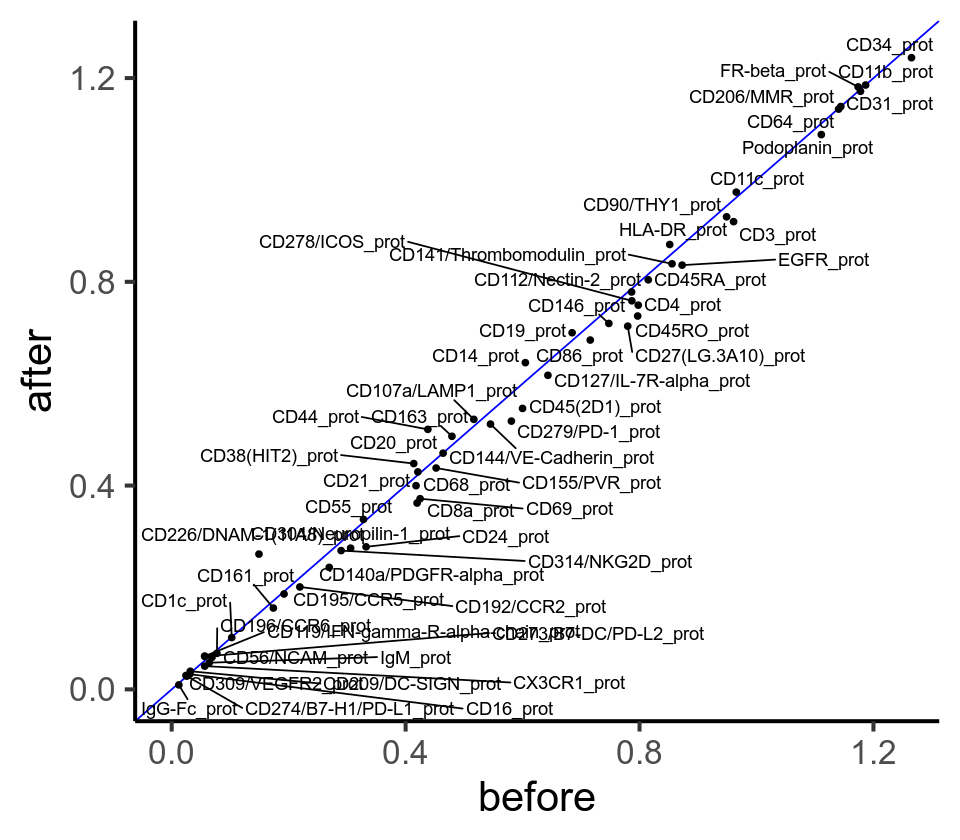

In [95]:
dat_kl = data.frame(
    before = kl_div_cor_adt_mrna_nofilter,
    after = kl_div_cor_adt_mrna_filter
)
rownames(dat_kl) <- names(kl_div_cor_adt_mrna_filter)
dat_kl[1:4,]

fig.size(7,8)
ggplot(data = dat_kl, aes(x = before, y = after, label = rownames(dat_kl))) +
#     stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_abline(intercept = 0, slope = 1, color = "blue") +
    geom_point() +
    coord_cartesian(xlim = c(0, 1.25), ylim = c(0, 1.25)) +
#     xlab("") +
#     ylab("") +
    geom_text_repel(hjust = 0.5) +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
#         legend.position = "none"
    ) 

In [51]:
rownames(adt_exprs_norm)

[1] "CD107a/LAMP1_prot"                  "CD112/Nectin-2_prot"               
 [3] "CD119/IFN-gamma-R-alpha-chain_prot" "CD11b_prot"                        
 [5] "CD11c_prot"                         "CD127/IL-7R-alpha_prot"            
 [7] "CD140a/PDGFR-alpha_prot"            "CD141/Thrombomodulin_prot"         
 [9] "CD144/VE-Cadherin_prot"             "CD146_prot"                        
[11] "CD14_prot"                          "CD155/PVR_prot"                    
[13] "CD161_prot"                         "CD163_prot"                        
[15] "CD16_prot"                          "CD192/CCR2_prot"                   
[17] "CD195/CCR5_prot"                    "CD196/CCR6_prot"                   
[19] "CD19_prot"                          "CD1c_prot"                         
[21] "CD206/MMR_prot"                     "CD209/DC-SIGN_prot"                
[23] "CD20_prot"                          "CD21_prot"                         
[25] "CD226/DNAM-1(11A8)_prot"            "CD24_prot"                         
[27] "CD273/B7-DC/PD-L2_prot"             "CD274/B7-H1/PD-L1_prot"            
[29] "CD278/ICOS_prot"                    "CD279/PD-1_prot"                   
[31] "CD27(LG.3A10)_prot"                 "CD304/Neuropilin-1_prot"           
[33] "CD309/VEGFR2_prot"                  "CD314/NKG2D_prot"                  
[35] "CD31_prot"                          "CD34_prot"                         
[37] "CD38(HIT2)_prot"                    "CD3_prot"                          
[39] "CD44_prot"                          "CD45(2D1)_prot"                    
[41] "CD45RA_prot"                        "CD45RO_prot"                       
[43] "CD4_prot"                           "CD55_prot"                         
[45] "CD56/NCAM_prot"                     "CD64_prot"                         
[47] "CD68_prot"                          "CD69_prot"                         
[49] "CD86_prot"                          "CD8a_prot"                         
[51] "CD90/THY1_prot"                     "CX3CR1_prot"                       
[53] "EGFR_prot"                          "FR-beta_prot"                      
[55] "HLA-DR_prot"                        "IgG-Fc_prot"                       
[57] "IgM_prot"                           "Podoplanin_prot"

In [73]:
# exprs_norm <- readRDS("qc_mRNA_exprs_2020-01-24.rds")
# meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_anno_hpca_2020-02-20.rds")
# adt_exprs_norm_filter <- readRDS("adt_exprs_norm_filter_2020-02-18.rds")

In [145]:
# Matched gene names with rownames(adt_exprs_norm)
# matched_genes <- c("", "", "CD19", "", "", 
#                    "", "CD226", "TNFSF11", "", "", "", "", 
#                    "", "", "", "", "", "","", "", "", "", 
#                    "CDH5", "", "MERTK", "", "CXCR5", "", "", "HAVCR2", "IGHD", "")

matched_genes <- c("LAMP1", "NECTIN2", "IFNGR1", "ITGAM", "ITGAX",
                   "IL7R", "PDGFRA", "THBD", "CDH11", "MCAM",
                   
                   "CD14", "PVR", "KLRB1", "CD163", "FCGR3A",
                   "CCR2", "CCR5", "CCR6", "CD19", "CD1C",
                   
                   "MRC1", "CD209", "MS4A1", "CR2", "CD226",
                   "CD24", "PDCD1LG2", "CD274", "ICOS", "PDCD1",
                   
                   "CD27", "NRP1", "KDR", "KLRK1", "PECAM1",
                   "CD34", "CD38", "CD3D", "CD44", "PTPRC",
                   
                   "PTPRC", "PTPRC", "CD4", "CD55", "NCAM1",
                   "FCGR1A", "CD68", "CD69", "CD86", "CD8A",
                   
                   "THY1", "CX3CR1", "EGFR", "FOLR2", "HLA-DRA",
                   "IGHG1", "IGHM", "PDPN"
                  )
length(matched_genes)

matched_genes[which((!matched_genes %in% row.names(exprs_norm)))]

[1] 58

character(0)

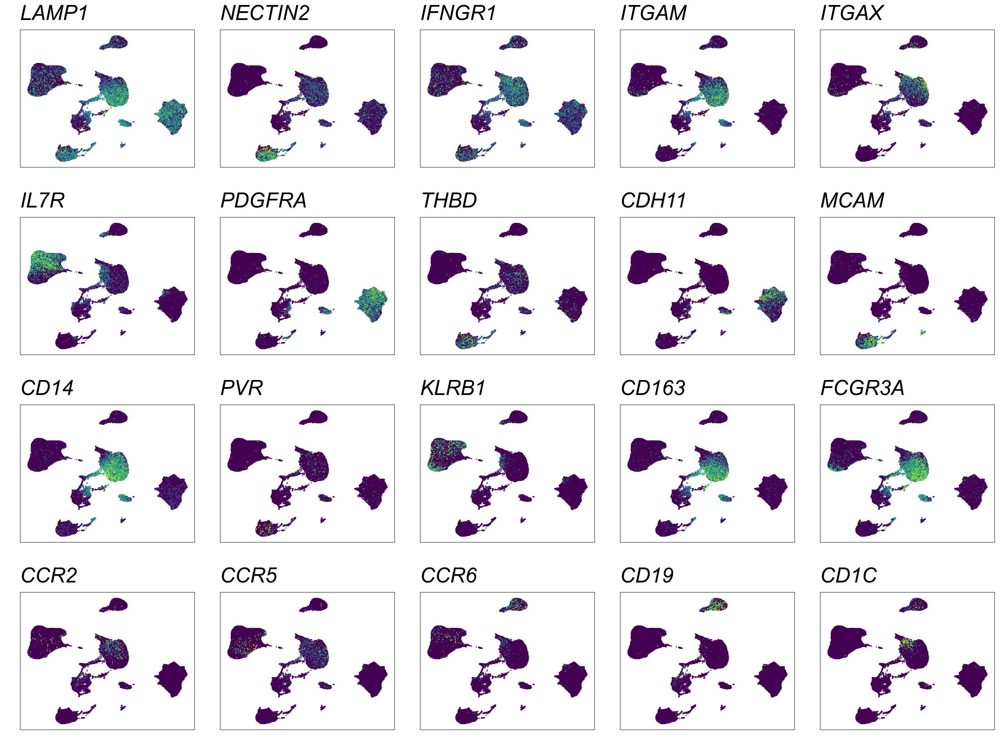

In [151]:
# Check expression of gene expression

myplots <- list()
for (i in 1:20) {
    gene <- matched_genes[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="") +
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

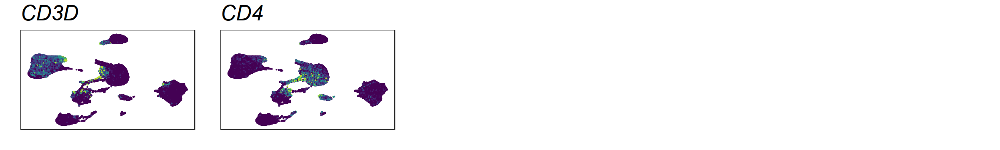

In [78]:
# Check expression of gene expression
matched_genes <- c("CD3D", "CD4")

myplots <- list()
for (i in 1:length(matched_genes)) {
    gene <- matched_genes[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="") +
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 3, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

In [77]:
matched_genes %in% rownames(exprs_norm)

[1] TRUE TRUE

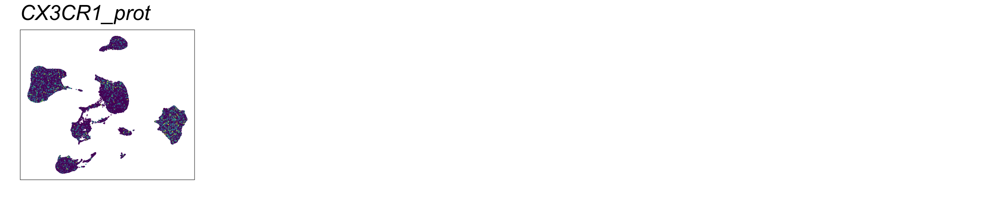

In [12]:
# Check expression of gene expression

gene_plot <- c("CX3CR1_prot")

myplots <- list()
for (i in 1) {
  gene <- gene_plot[i]
    
    max.cutoff = quantile(adt_exprs_norm_filter[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm_filter[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm_filter[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
#                  data = meta_all[sample(nrow(meta_all)),],
                 data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 4, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

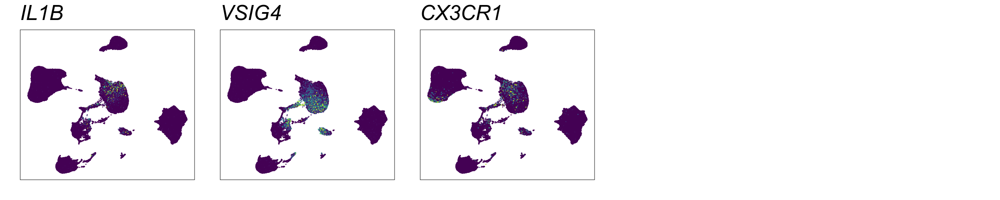

In [10]:
# Check expression of gene expression

gene_plot <- c("IL1B", "VSIG4", "CX3CR1")

myplots <- list()
for (i in 1:3) {
  gene <- gene_plot[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 4, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

In [ ]:
# Check expression of gene expression

myplots <- list()
for (i in 41:length(matched_genes)) {
  gene <- matched_genes[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 15, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

## Before QC, correlation

In [104]:
cor_expr_before <- sapply(which(matched_genes %in% row.names(exprs_norm)), function(x){cor(exprs_norm[matched_genes[x],], adt_exprs_norm[x,], method = "spearman")})
names(cor_expr_before) <- matched_genes[which(matched_genes %in% row.names(exprs_norm))]
mean_exp_before <- apply(exprs_norm[matched_genes,], 1, function(x){mean(x[x!=0])})

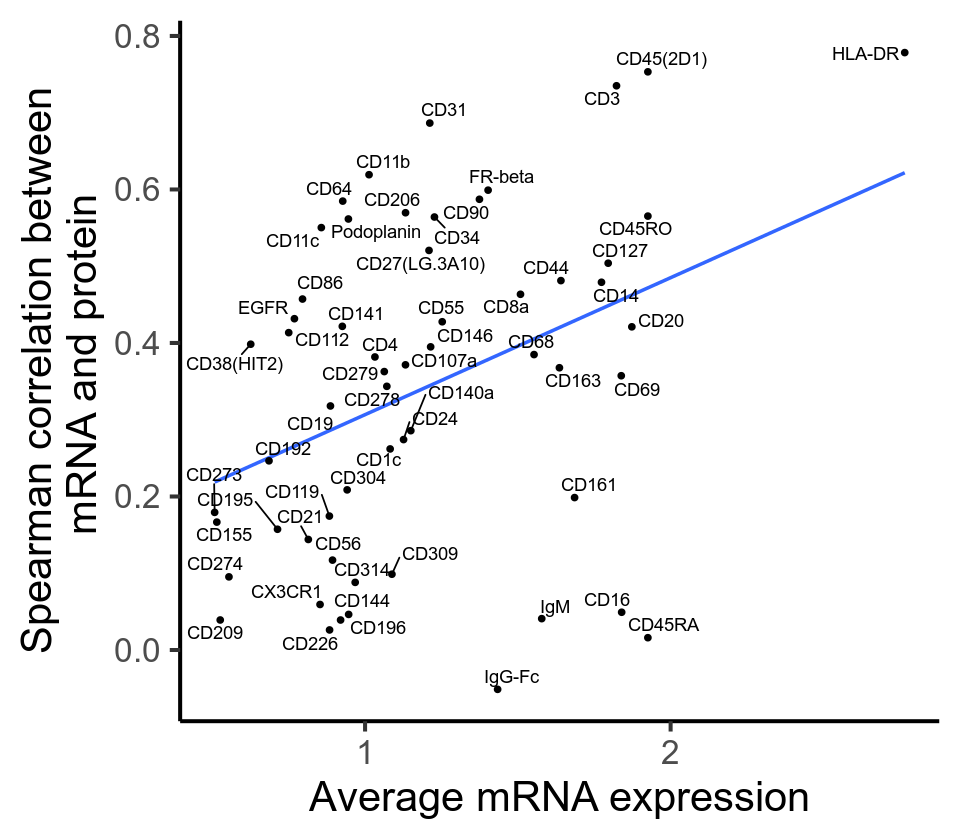

In [106]:
fig.size(7,8)
ggplot(data = as.data.frame(cor_expr_before[!is.na(cor_expr_before)]), aes(x = mean_exp_before[which(matched_genes %in% row.names(exprs_norm))][!is.na(cor_expr_before)],
                                                             y = cor_expr_before[!is.na(cor_expr_before)],
                                                             label = sub('\\/.*', '', sub('\\_.*', '', rownames(adt_exprs_norm)))
                                                            )) +
    stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_point() +
    xlab("Average mRNA expression") +
    ylab("Spearman correlation between\n mRNA and protein") +
    geom_text_repel() +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
        legend.position = "none"
    ) 

## After QC, correlation

In [146]:
cor_expr <- sapply(which(matched_genes %in% row.names(exprs_norm)), function(x){cor(exprs_norm[matched_genes[x],], adt_exprs_norm_filter[x,], method = "spearman")})
names(cor_expr) <- matched_genes[which(matched_genes %in% row.names(exprs_norm))]
mean_exp <- apply(exprs_norm[matched_genes,], 1, function(x){mean(x[x!=0])})

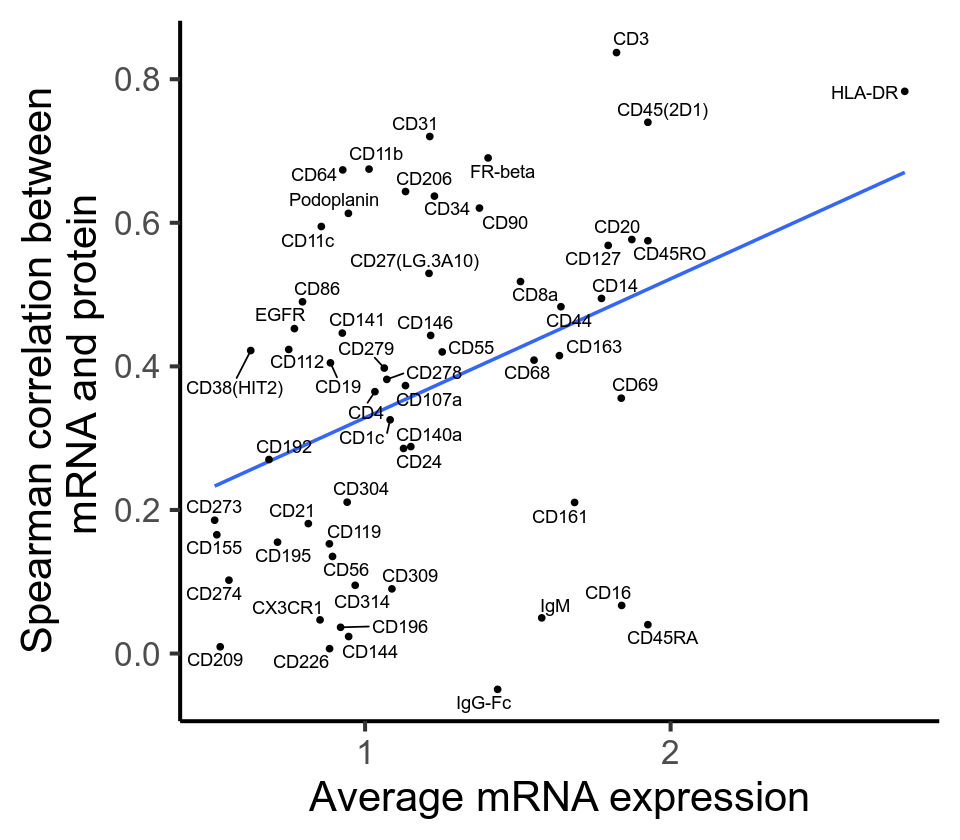

In [147]:
fig.size(7,8)
ggplot(data = as.data.frame(cor_expr[!is.na(cor_expr)]), aes(x = mean_exp[which(matched_genes %in% row.names(exprs_norm))][!is.na(cor_expr)],
                                                             y = cor_expr[!is.na(cor_expr)],
                                                             label = sub('\\/.*', '', sub('\\_.*', '', rownames(adt_exprs_norm)))
                                                            )) +
    stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_point() +
    xlab("Average mRNA expression") +
    ylab("Spearman correlation between\n mRNA and protein") +
    geom_text_repel() +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
        legend.position = "none"
    ) 

[1] 58

[1] 58

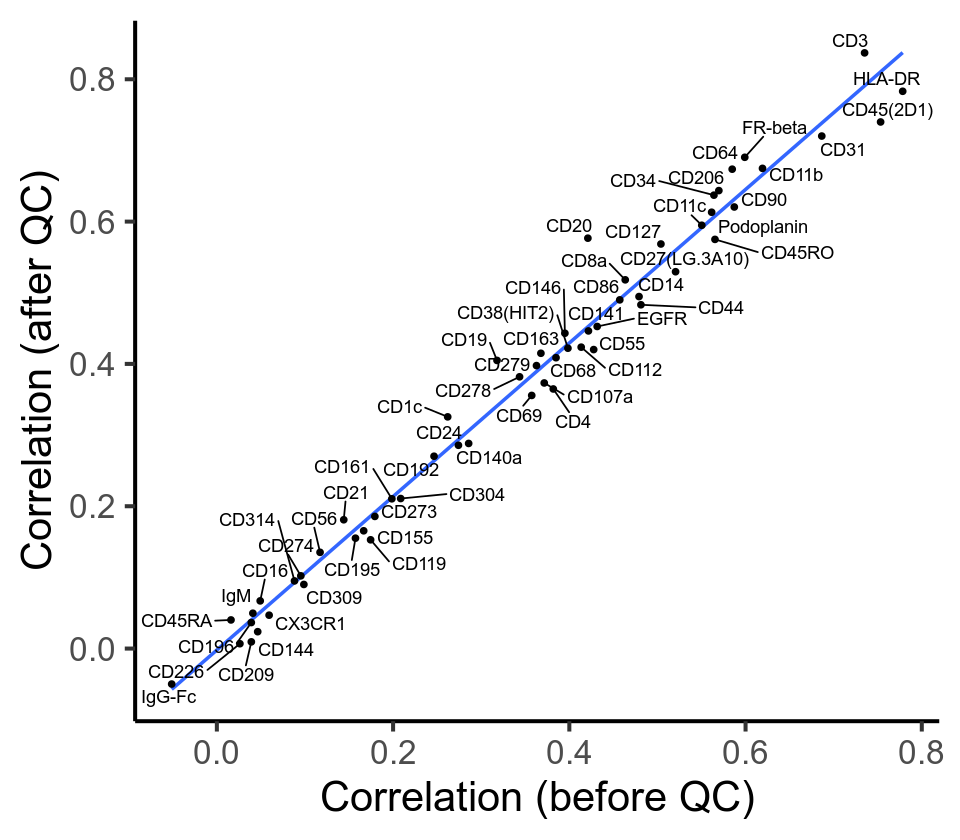

In [149]:
length(cor_expr_before)
length(cor_expr)

fig.size(7,8)
ggplot(data = as.data.frame(cor_expr[!is.na(cor_expr)]), aes(x = cor_expr_before,
                                                             y = cor_expr[!is.na(cor_expr)],
                                                             label = sub('\\/.*', '', sub('\\_.*', '', rownames(adt_exprs_norm)))
                                                            )) +
    stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_point() +
    xlab("Correlation (before QC)") +
    ylab("Correlation (after QC)") +
    geom_text_repel() +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
        legend.position = "none"
    ) 


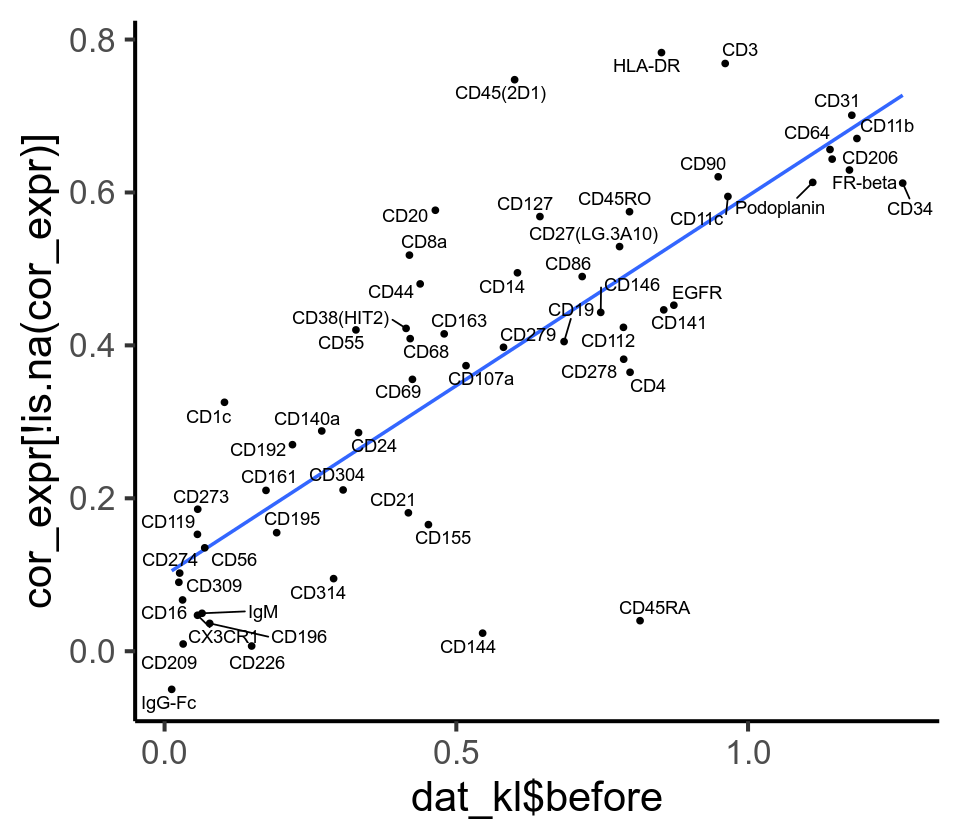

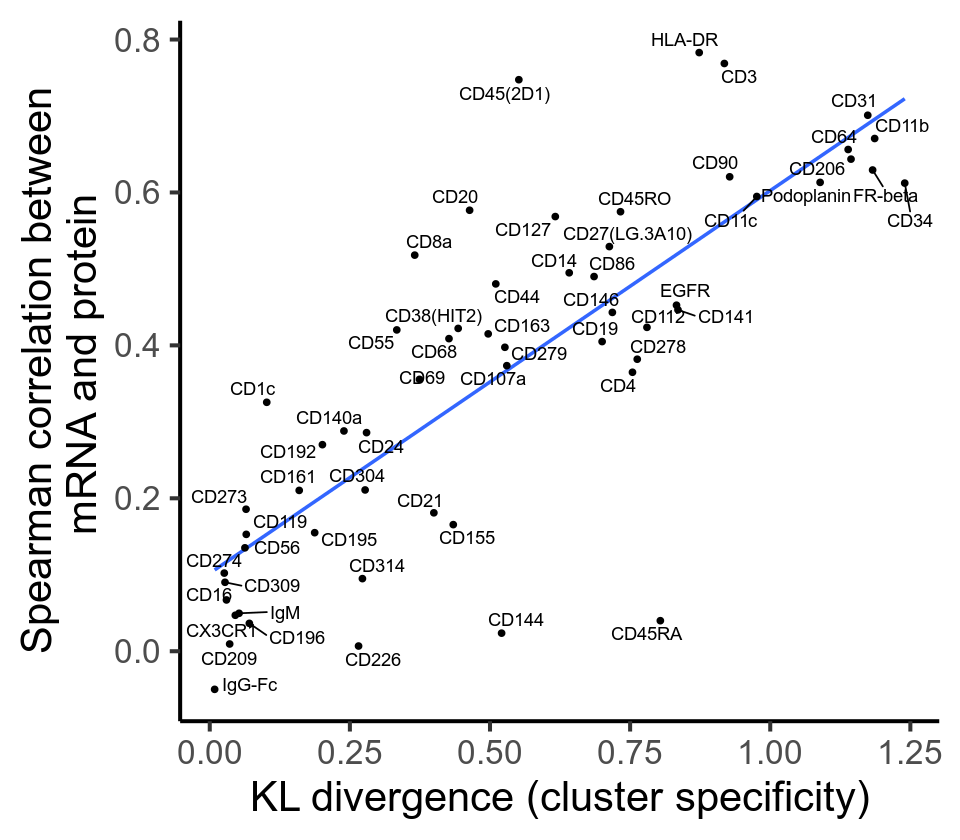

In [102]:
fig.size(7,8)
ggplot(data = as.data.frame(cor_expr[!is.na(cor_expr)]), aes(x = dat_kl$before,
                                                             y = cor_expr[!is.na(cor_expr)],
                                                             label = sub('\\/.*', '', sub('\\_.*', '', rownames(adt_exprs_norm)))
                                                            )) +
    stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_point() +
#     xlab("Average mRNA expression") +
#     ylab("Spearman correlation between\n mRNA and protein") +
    geom_text_repel() +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
        legend.position = "none"
    ) 

ggplot(data = as.data.frame(cor_expr[!is.na(cor_expr)]), aes(x = dat_kl$after,
                                                             y = cor_expr[!is.na(cor_expr)],
                                                             label = sub('\\/.*', '', sub('\\_.*', '', rownames(adt_exprs_norm)))
                                                            )) +
    stat_smooth(method = "lm", formula = y ~ x, se = FALSE) +
    geom_point() +
    xlab("KL divergence (cluster specificity)") +
    ylab("Spearman correlation between\n mRNA and protein") +
    geom_text_repel() +
    theme_classic(base_size = 25)+
    theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=25, face = "italic"), # face="bold.italic"
        legend.position = "none"
    ) 

# Clustering on the protein expression

In [7]:
meta_all[1:4,]

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,harmonized_PC19,harmonized_PC20,harmonized_UMAP1,harmonized_UMAP2,gene,res_0.20,res_0.40,res_0.60,res_0.80,res_1.00
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,⋯,-0.0004747563,-0.005633132,11.135468,-0.7312793,0.000000,1,1,0,3,2
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,⋯,0.0956605894,-0.356151813,2.863655,-10.3395105,0.000000,13,18,19,20,21
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,⋯,0.0117411423,0.027152254,10.381248,-1.9383886,1.105236,1,1,0,3,8
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,⋯,-0.0036981598,-0.004332571,1.240208,2.9091845,0.000000,2,2,6,13,14


In [ ]:
# Scale expression to z-scores across cell types 
adt_exprs_scaled <- adt_exprs_norm_filter[rowSums(as.matrix(adt_exprs_norm_filter)) > 0,] %>% singlecellmethods::scaleData() 
adt_pca_res <- irlba::prcomp_irlba(t(adt_exprs_scaled), 20)

# Harmonization: sample and tissue 
options(repr.plot.height = 3, repr.plot.width = 5)
harmony <- HarmonyMatrix(adt_pca_res$x, meta_all,  "sample", theta = 2,
                         do_pca = FALSE,
#                          lambda = 1, 
#                          tau = 10, 
                         epsilon.cluster = -Inf,
                         epsilon.harmony = -Inf,
                         max.iter.cluster = 30,
                         max.iter.harmony = 20,
                         plot_convergence = T
                        )


Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 20179800)”
Harmony 1/20

Harmony 2/20

Harmony 3/20

Harmony 4/20

Harmony 5/20

Harmony 6/20

Harmony 7/20

Harmony 8/20

Harmony 9/20

Harmony 10/20

Harmony 11/20

Harmony 12/20

Harmony 13/20

Harmony 14/20

Harmony 15/20

Harmony 16/20

Harmony 17/20

Harmony 18/20

Harmony 19/20

Harmony 20/20



In [ ]:
colnames(harmony) <- paste0("protein_harmonized_", colnames(harmony), sep="")
meta_all <- cbind(meta_all, harmony)

saveRDS(meta_all, "qc_mRNA_protein_meta_all_2020-02-19.rds")

In [11]:
# UMAP with top 20 PCs
# adt_umap_res <- umap(harmony, n_neighbors = 50, metric = "cosine", min_dist = .3)

# meta_all <- readRDS("qc_mRNA_protein_meta_all_2020-02-19.rds")
adt_umap_res <- umap(meta_all[,c(57:66)], n_neighbors = 50, metric = "cosine", min_dist = .3)
meta_all$UMAP1_adt <- adt_umap_res$layout[, 1]
meta_all$UMAP2_adt <- adt_umap_res$layout[, 2]

In [10]:
# saveRDS(meta_all, "qc_mRNA_protein_meta_all_2020-02-20.rds")

In [6]:
library(parallel)

# Louvain
meta_all <- readRDS("qc_mRNA_protein_meta_all_2020-02-20.rds")
snn_pcs <- BuildSNNSeurat(meta_all[, c(57:66)], nn.eps = .5)

resolution_list <- c(0.2, 0.4)
ids_cos <- Reduce(cbind, mclapply(resolution_list, function(res_use) {
    Seurat:::RunModularityClustering(SNN = snn_pcs, modularity = 1, 
        resolution = res_use, algorithm = 3, n.start = 10, 
        n.iter = 10, random.seed = 0, print.output = FALSE, 
        temp.file.location = NULL, edge.file.name = NULL)    
}, mc.cores = min(16, length(resolution_list))))
ids_cos %<>% data.frame()
colnames(ids_cos) <- sprintf("res_%.2f", resolution_list)

meta_all$res_0.20_adt <- ids_cos$res_0.20
meta_all$res_0.40_adt <- ids_cos$res_0.40
# meta_all$res_0.60_adt <- ids_cos$res_0.60
# meta_all$res_0.80_adt <- ids_cos$res_0.80
# meta_all$res_1.00_adt <- ids_cos$res_1.00

# saveRDS(meta_all, "qc_mRNA_protein_pca_umap_clus_meta_all_2020-02-20.rds")

In [6]:
meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_2020-02-20.rds")

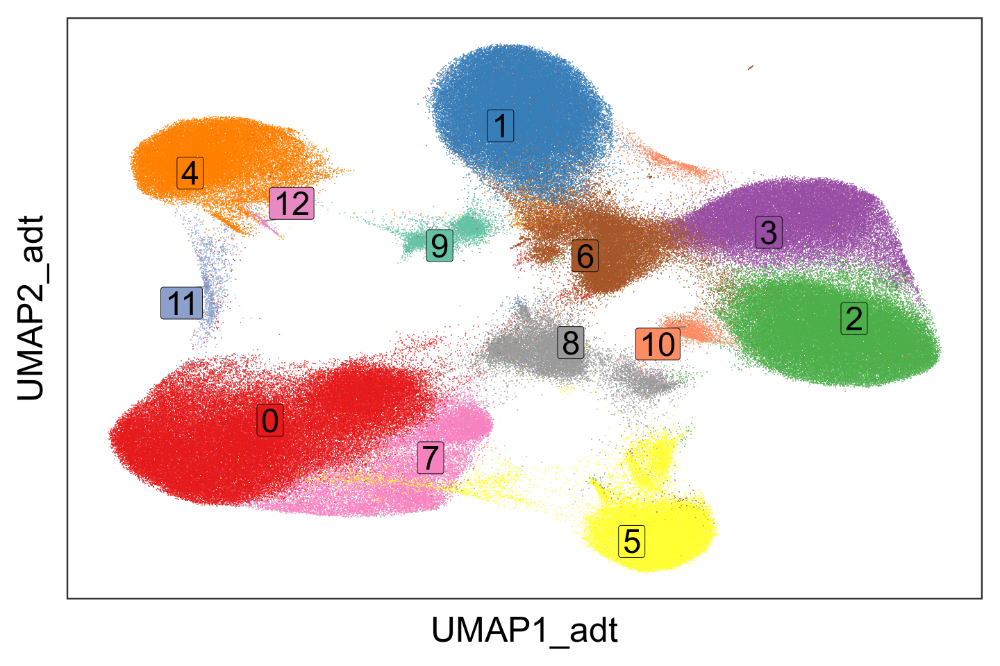

In [109]:
meta_all$res_0.20_adt <- as.character(meta_all$res_0.20_adt)
meta_all$res_0.40_adt <- as.character(meta_all$res_0.40_adt)


cluster_center <- meta_all %>%
                  group_by(res_0.20_adt) %>%
                  summarise_at(vars(UMAP1_adt, UMAP2_adt), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$res_0.20_adt <- as.character(cluster_center$res_0.20_adt)

options(repr.plot.height = 8, repr.plot.width = 12)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = UMAP1_adt, y = UMAP2_adt, fill= res_0.20_adt)
      ) +
  geom_point(size = 0.6, stroke = 0.0001, shape = 21, alpha = 0.6) +
  geom_label_repel(
    data = cluster_center,
    aes(label = res_0.20_adt, fill = res_0.20_adt),
#     fontface = 'bold', 
    size = 10, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = meta_colors$cluster, name = "") +
  labs(
      x = "UMAP1_adt",
      y = "UMAP2_adt"
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30, face = "italic")
)

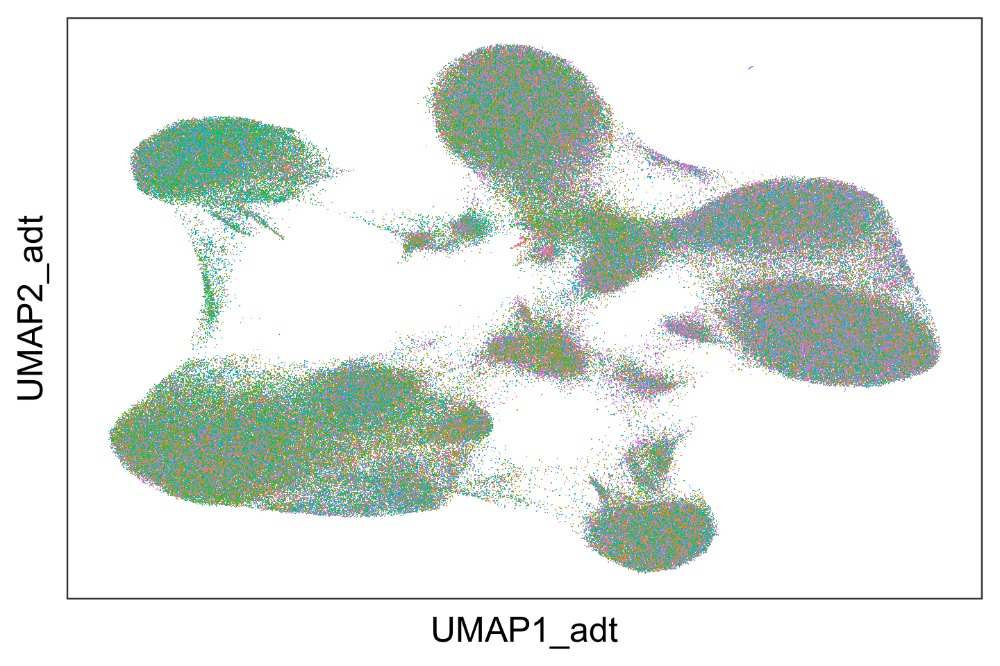

In [97]:
options(repr.plot.height = 8, repr.plot.width = 12)
ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "UMAP1_adt", y = "UMAP2_adt", fill = "sample"),
    size = 0.5, stroke = 0.0001, shape = 21
  ) +
#   scale_fill_manual(values = meta_colors$sample, name = "") +
  labs(
      x = "UMAP1_adt",
      y = "UMAP2_adt"
#       title = paste0("Clustering of ", nrow(meta_all),  " cells on proteins; \nColored by ", nrow(as.data.frame(table(meta_all$sample))),  " samples")
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

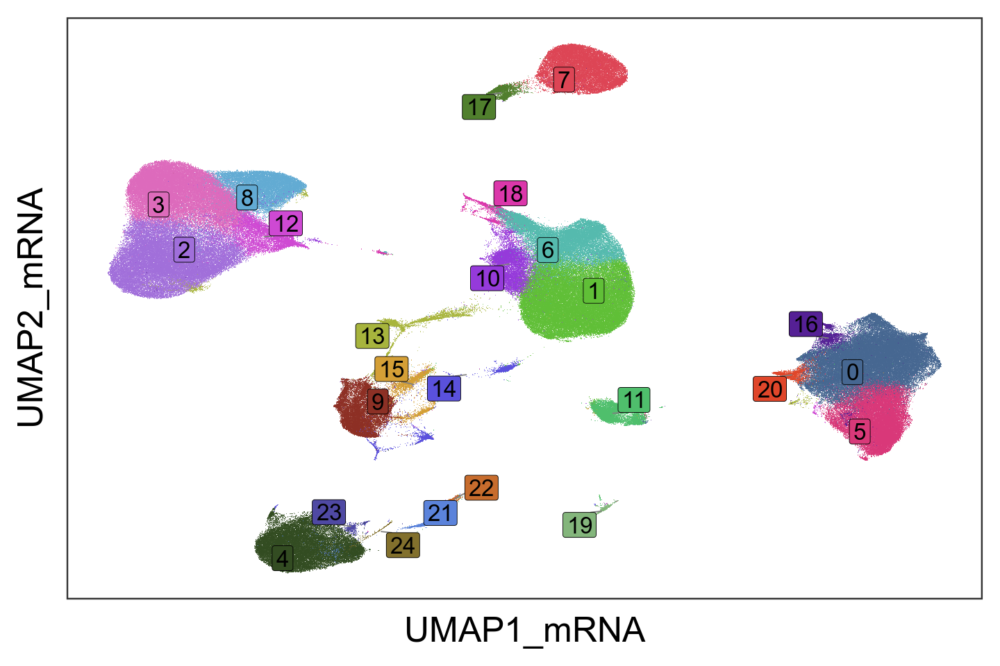

In [41]:
meta_all$res_0.20 <- as.character(meta_all$res_0.20)
meta_all$res_0.40 <- as.character(meta_all$res_0.40)
meta_all$res_0.60 <- as.character(meta_all$res_0.60)


set3 = c("#8DD3C7", "#FFFFB3", "#BEBADA", "#FB8072", "#80B1D3", "#FDB462", "#B3DE69", "#FCCDE5", "#D9D9D9", "#BC80BD", "#CCEBC5", "#FFED6F")
set2 = c("#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3")
colors37 = c("#466791","#60bf37","#953ada","#4fbe6c","#ce49d3","#a7b43d","#5a51dc","#d49f36","#552095","#507f2d","#db37aa","#84b67c","#a06fda","#df462a","#5b83db","#c76c2d","#4f49a3","#82702d","#dd6bbb","#334c22","#d83979","#55baad","#dc4555","#62aad3","#8c3025","#417d61","#862977","#bba672","#403367","#da8a6d","#a79cd4","#71482c","#c689d0","#6b2940","#d593a7","#895c8b","#bd5975")


cluster_center <- meta_all %>%
                  group_by(res_0.60) %>%
                  summarise_at(vars(harmonized_UMAP1, harmonized_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$res_0.60 <- as.character(cluster_center$res_0.60)

options(repr.plot.height = 8, repr.plot.width = 12)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_UMAP1, y = harmonized_UMAP2, fill= res_0.60)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.7) +
  geom_label_repel(
    data = cluster_center,
    aes(label = res_0.60, fill = res_0.60),
#     fontface = 'bold', 
    size = 7, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1_mRNA",
      y = "UMAP2_mRNA"
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30, face = "italic")
)

In [4]:
# test_meta <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_site_anno_hpca_2020-02-23.rds")
test_meta[1:4,]
dim(test_meta)
colnames(test_meta)


,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,protein_harmonized_PC18,protein_harmonized_PC19,protein_harmonized_PC20,UMAP1_adt,UMAP2_adt,res_0.20_adt,res_0.40_adt,hpca_anno,hpca_anno_fine,site
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,⋯,0.2740286,0.57389824,-0.3256205,0.9773253,6.577851,1,0,Chondrocytes:MSC-derived,Chondrocytes:MSC-derived,Pittsburgh
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,⋯,-0.3393538,1.04008517,-0.8825261,-6.2643149,5.037686,4,4,iPS_cells:adipose_stem_cells,iPS_cells:adipose_stem_cells,Pittsburgh
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,⋯,2.8541640,-0.25334417,-0.2337399,-2.2928325,-4.808373,7,5,Smooth_muscle_cells:bronchial,Smooth_muscle_cells:bronchial,Pittsburgh
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,⋯,-1.3839181,0.02315231,0.1476639,-4.0102350,-5.385874,0,5,Monocyte:CD16-,Monocyte:CD16-,Pittsburgh


[1] 403596     83

[1] "cell"                    "sample"                 
 [3] "nUMI"                    "nGene"                  
 [5] "percent_mito"            "percent.ribo"           
 [7] "UMAP1"                   "UMAP2"                  
 [9] "PC1"                     "PC2"                    
[11] "PC3"                     "PC4"                    
[13] "PC5"                     "PC6"                    
[15] "PC7"                     "PC8"                    
[17] "PC9"                     "PC10"                   
[19] "PC11"                    "PC12"                   
[21] "PC13"                    "PC14"                   
[23] "PC15"                    "PC16"                   
[25] "PC17"                    "PC18"                   
[27] "PC19"                    "PC20"                   
[29] "harmonized_PC1"          "harmonized_PC2"         
[31] "harmonized_PC3"          "harmonized_PC4"         
[33] "harmonized_PC5"          "harmonized_PC6"         
[35] "harmonized_PC7"          "harmonized_PC8"         
[37] "harmonized_PC9"          "harmonized_PC10"        
[39] "harmonized_PC11"         "harmonized_PC12"        
[41] "harmonized_PC13"         "harmonized_PC14"        
[43] "harmonized_PC15"         "harmonized_PC16"        
[45] "harmonized_PC17"         "harmonized_PC18"        
[47] "harmonized_PC19"         "harmonized_PC20"        
[49] "harmonized_UMAP1"        "harmonized_UMAP2"       
[51] "gene"                    "res_0.20"               
[53] "res_0.40"                "res_0.60"               
[55] "res_0.80"                "res_1.00"               
[57] "protein_harmonized_PC1"  "protein_harmonized_PC2" 
[59] "protein_harmonized_PC3"  "protein_harmonized_PC4" 
[61] "protein_harmonized_PC5"  "protein_harmonized_PC6" 
[63] "protein_harmonized_PC7"  "protein_harmonized_PC8" 
[65] "protein_harmonized_PC9"  "protein_harmonized_PC10"
[67] "protein_harmonized_PC11" "protein_harmonized_PC12"
[69] "protein_harmonized_PC13" "protein_harmonized_PC14"
[71] "protein_harmonized_PC15" "protein_harmonized_PC16"
[73] "protein_harmonized_PC17" "protein_harmonized_PC18"
[75] "protein_harmonized_PC19" "protein_harmonized_PC20"
[77] "UMAP1_adt"               "UMAP2_adt"              
[79] "res_0.20_adt"            "res_0.40_adt"           
[81] "hpca_anno"               "hpca_anno_fine"         
[83] "site"

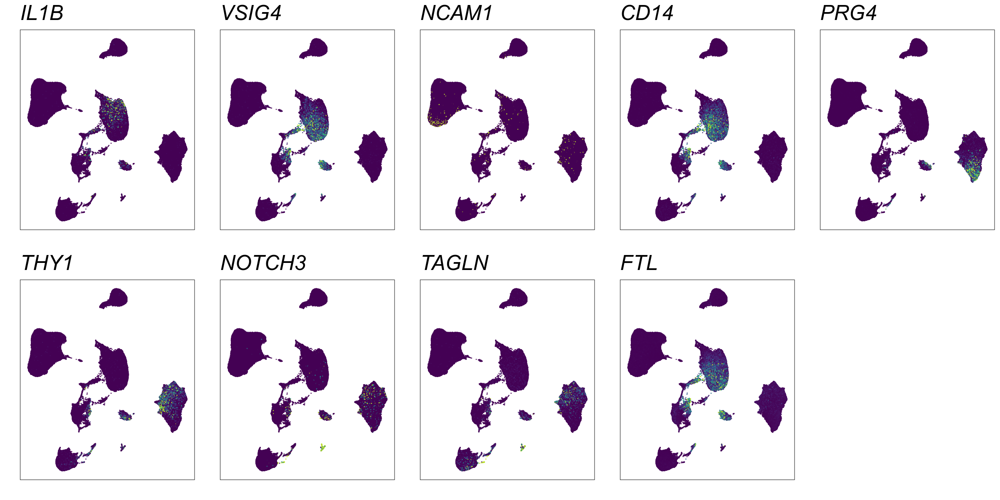

In [36]:
# Check expression of gene expression

plot_genes <- c("IL1B", "VSIG4", "NCAM1", "CD14", "PRG4", "THY1", "NOTCH3", "TAGLN", "FTL")

myplots <- list()
for (i in 1:length(plot_genes)) {
    gene <- plot_genes[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_UMAP1, y = harmonized_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "viridis", end = .9) +
      labs(x="", y="") +
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 10, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 5))

In [57]:
# library(presto)
# genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
# vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 1e3)
# var_genes <- vargenes_df$gene
# length(var_genes)
# dim(exprs_norm[var_genes,])

# mRNA_marker <- wilcoxauc(exprs_norm[var_genes,], meta_all$res_0.40)
# saveRDS(mRNA_marker, "mRNA_marker_2020-02-21.rds")

mRNA_marker <- readRDS("mRNA_marker_2020-02-21.rds")
x <- mRNA_marker %>%
  group_by(group) %>%
  top_n(4, wt = logFC) 
x

# x[which(x$feature == "CD38"),]




feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
IL7R,0,6.928786,5.571822,18128259804,0.8464536,0,0,85.80338,21.912409
IL32,0,9.681161,6.947141,17829527319,0.8325050,0,0,93.71868,35.496254
CD52,0,7.621959,4.509784,17002535663,0.7938907,0,0,95.22378,43.671917
LTB,0,7.973223,6.404569,18157646382,0.8478257,0,0,88.60516,26.569585
DCN,1,94.241282,86.711190,19062177412,0.9599347,0,0,99.77159,35.409711
COL1A2,1,89.585211,79.447059,18501536105,0.9317019,0,0,99.65651,40.829011
COL3A1,1,101.188206,91.150735,18346270704,0.9238830,0,0,98.21802,42.191634
PLA2G2A,1,109.064235,90.133908,17376500185,0.8750472,0,0,93.51374,37.800222
HLA-DRA,2,194.479762,161.287278,17950069992,0.9096299,0,0,99.57837,72.684136
TMSB4X,2,209.645691,129.500456,16326743537,0.8273669,0,0,99.99649,99.491165


In [52]:
# exprs_norm <- readRDS("mRNA_exprs_norm_2020-01-24.rds")
# all(colnames(exprs_norm) == meta_all$cell)

[1] TRUE

In [ ]:
## Heatmap of marker genes
gene_plot <- c(unique(x$feature), "THY1", "CD3D", "CD19", "PDPN", "TRDC", "MZB1", "CD27", "MCAM", "CD1C", "MKI67")
# gene_plot <- gene_plot[-which(gene_plot %in% genes_exclude)]

exp_heat <- exprs_norm[gene_plot,]
all(colnames(exp_heat) == meta_all$cell)
exp_heat <- t(exp_heat)
exp_heat <- as.data.frame(exp_heat)
all(rownames(exp_heat) == meta_all$cell)
exp_heat$res_0.60 <- as.character(meta_all$res_0.60)
dim(exp_heat)

exp_ave <- aggregate(exp_heat[, 1:(ncol(exp_heat)-1)], list(exp_heat$res_0.60), mean)
colnames(exp_ave)[1] <- "res_0.60"
exp_ave <- as.data.frame(t(exp_ave))
colnames(exp_ave) <- as.character(t(exp_ave[1,]))
exp_ave <- exp_ave[-1,]
row_names <- rownames(exp_ave)

exp_ave <- mutate_all(exp_ave, function(x) as.numeric(as.character(x)))
rownames(exp_ave) <- row_names
class(exp_ave[1,1])         

In [86]:
exp_ave <- as.matrix(exp_ave)
mat_breaks <- seq(min(exp_ave), max(exp_ave), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(exp_ave, n = 10)

# annotation_col <- meta_all[,c("res_0.60_anno", "diagnosis")] 
# rownames(annotation_col) <- meta_all$cell

# d <- d[,order(annotation_col$res_0.60_anno)]
scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2

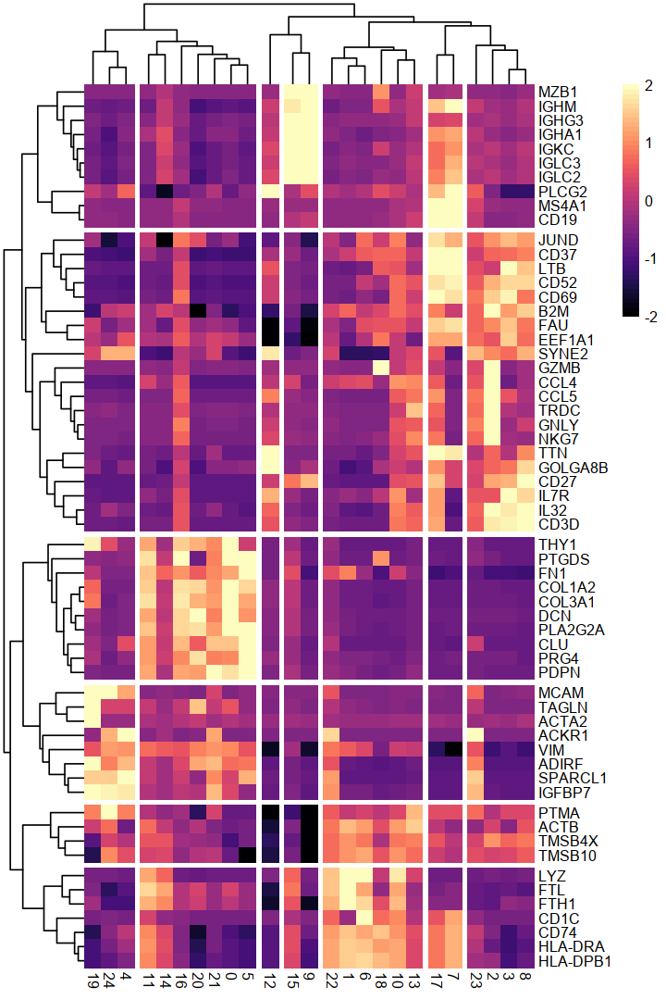

In [87]:
library(pheatmap)
options(repr.plot.width = 6, repr.plot.height = 9)
pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
  color  = magma(50),
  show_rownames = TRUE,
  show_colnames = TRUE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 6,
  cutree_cols = 7,
#   annotation_col = annotation_col,
#   annotation_colors = meta_colors,
  fontsize = 9,
  fontsize_row = 9
#   scale = "none"
)
# dev.copy(png,file = paste("heatmap_2019-06-25", ".png", sep = ""), width=5, height=12, units="in", res=300)
# dev.off()

In [8]:
# Run singleR
library(SingleR)
source("/data/srlab/ik936/Foxxy/utils/utils_singler.R")
# source("/data/srlab/ik936/SingleR/R/SingleR.R")
library(umap)
library(RcppArmadillo)

hpca$data <- hpca$data %>% t %>% scale %>% t
# hpca$data[1:4,1:4]
dim(hpca$data)

# blueprint_encode
genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 0.2e3)
var_genes <- vargenes_df$gene
length(var_genes)


# http://comphealth.ucsf.edu/SupplementaryInformation1.html
# a correlation between the expression of a single cell (x-axis) and a reference sample (y-axis)
anno_hpca <- SingleR.CreateObject2(exprs_norm[var_genes, ], 
                                   # dcast_means, 
                                  hpca,
#                                 immgen, # mouse
#                                 blueprint_encode, # human
                                  NULL, "Human", "", "10X",
                                  do.main.types=FALSE, variable.genes="de",
                                  fine.tune=  FALSE # TRUE
                            )


saveRDS(anno_hpca, "anno_hpca_2020-02-21.rds")

[1] 19363   713

[1] 916

[1] "Annotating data with HPCA..."
[1] "Variable genes method: de"
[1] "Number of DE genes:559"
[1] "Number of cells: 403596"


In [14]:
anno_hpca <- readRDS("anno_hpca_moregenes_2020-02-21.rds")
meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_2020-02-20.rds")
temp2 <- as.character(anno_hpca$SingleR.single$labels)
class(temp2)
length(temp2)
meta_all$hpca_anno <- temp2 
meta_all$hpca_anno_fine <- meta_all$hpca_anno
length(table(meta_all$hpca_anno_fine))

remove <- names(table(meta_all$hpca_anno_fine))[which(as.numeric(table(meta_all$hpca_anno_fine)) < 120)]
meta_all$hpca_anno_fine[which(meta_all$hpca_anno_fine %in% remove)] <- ""
# table(meta_all$hpca_anno_fine)

# saveRDS(meta_all, "qc_mRNA_protein_pca_umap_clus_meta_all_anno_hpca_2020-02-20.rds")

[1] "character"

[1] 403596

[1] 99

In [8]:
plot_clusters3 <- function(cluster_ids, labels, pt_size = 14, umap_use = umap_post, do_labels = FALSE) {
    cluster_table <- table(cluster_ids)
    clusters_keep <- names(which(cluster_table > 20))
    plt_df <- umap_use %>% data.frame() %>% cbind(cluster = cluster_ids) %>%
        subset(cluster %in% clusters_keep) 
    plt <- plt_df %>% 
        ggplot(aes(X1, X2, col = factor(cluster))) + geom_point(shape = '.', alpha = .6) + 
        theme_tufte() + geom_rangeframe(col = "black") + 
#         theme(axis.line = element_line()) +
        guides(color = guide_legend(override.aes = list(stroke = 1, alpha = 1, shape = 21, size = 4))) + 
        scale_color_manual(values = singler.colors) +
        labs(x = "UMAP 1", y = "UMAP 2") +
        theme(plot.title = element_text(hjust = .5)) + 
        guides(col = FALSE)
    
    if (do_labels) 
        plt <- plt + geom_label(data = data.table(plt_df)[, .(X1 = mean(X1), X2 = mean(X2)), by = cluster], 
                                aes(label = cluster), size = pt_size, alpha = .8)
    return(plt)
}

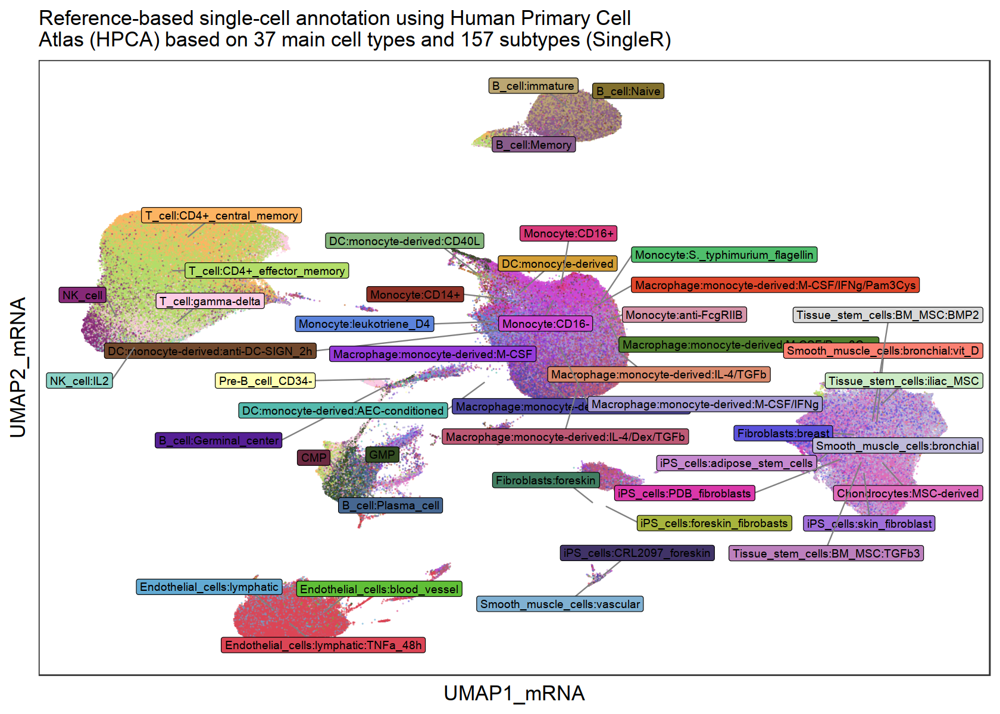

In [22]:
# Find cluster center
# This function provides normalized expression values 713 microarray samples of the Human Primary Cell Atlas (HPCA) (Mabbott et al., 2013). 
# These 713 samples were processed and normalized as described in Aran, Looney and Liu et al. (2019)
# and each sample has been assigned to one of 37 main cell types and 157 subtypes.

set3 = c("#8DD3C7", "#FFFFB3", "#BEBADA", "#FB8072", "#80B1D3", "#FDB462", "#B3DE69", "#FCCDE5", "#D9D9D9", "#BC80BD", "#CCEBC5", "#FFED6F")
set2 = c("#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3")
colors37 = c("#466791","#60bf37","#953ada","#4fbe6c","#ce49d3","#a7b43d","#5a51dc","#d49f36","#552095","#507f2d","#db37aa","#84b67c","#a06fda","#df462a","#5b83db","#c76c2d","#4f49a3","#82702d","#dd6bbb","#334c22","#d83979","#55baad","#dc4555","#62aad3","#8c3025","#417d61","#862977","#bba672","#403367","#da8a6d","#a79cd4","#71482c","#c689d0","#6b2940","#d593a7","#895c8b","#bd5975")

cluster_center <- meta_all %>%
                  group_by(hpca_anno_fine) %>%
                  summarise_at(vars(harmonized_UMAP1, harmonized_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$hpca_anno_fine <- as.character(cluster_center$hpca_anno_fine)
meta_all$hpca_anno_fine <- as.character(meta_all$hpca_anno_fine)


options(repr.plot.height = 10, repr.plot.width = 14)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_UMAP1, y = harmonized_UMAP2, fill= hpca_anno_fine)
      ) +
  geom_point(size = 0.6, stroke = 0.0001, shape = 21, alpha = 0.6) +
  geom_label_repel(
    data = cluster_center,
    aes(label = hpca_anno_fine, fill = hpca_anno_fine),
#     fontface = 'bold', 
    size = 4, 
    box.padding = unit(0.5, "lines"),
    point.padding = unit(0.7, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(sample(colors37), set3, set2), name = "") +
  labs(
      x = "UMAP1_mRNA",
      y = "UMAP2_mRNA",
      title = "Reference-based single-cell annotation using Human Primary Cell\nAtlas (HPCA) based on 37 main cell types and 157 subtypes (SingleR)"
      ) +
  theme_bw(base_size = 20) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=20)
)

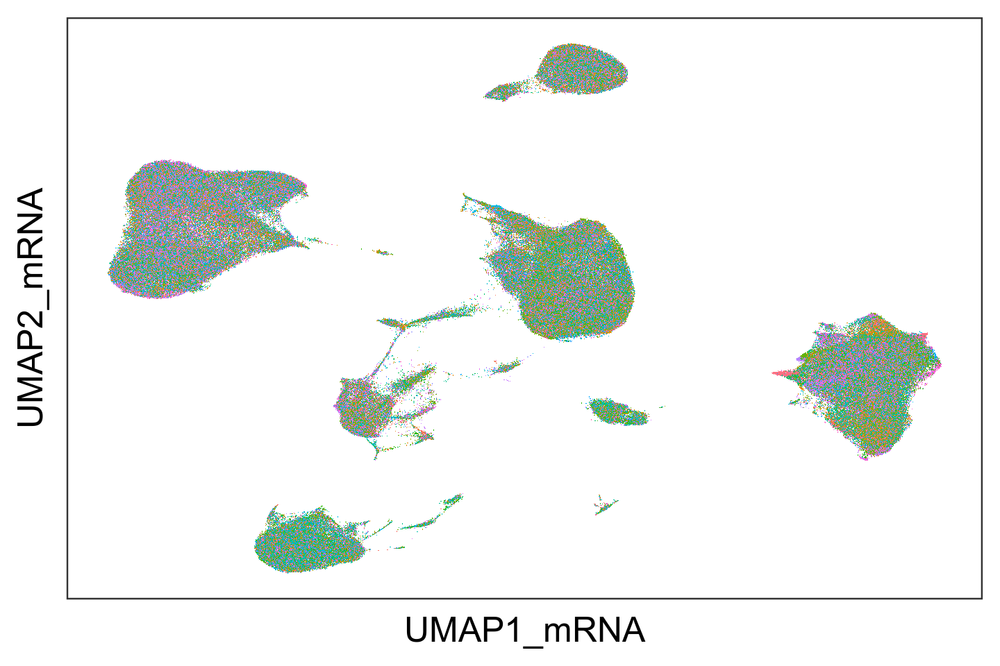

In [98]:
options(repr.plot.height = 8, repr.plot.width = 12)
ggplot() +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "sample"),
    size = 0.4, stroke = 0.0001, shape = 21
  ) +
#   scale_fill_manual(values = meta_colors$sample, name = "") +
  labs(
      x = "UMAP1_mRNA",
      y = "UMAP2_mRNA"
#       title = paste0("Clustering of ", nrow(meta_all),  " cells on proteins; \nColored by ", nrow(as.data.frame(table(meta_all$sample))),  " samples")
      ) +
  theme_bw(base_size = 30) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=30)
  ) 

# Correlation between mRNA clusters and protein clusters

In [36]:
# Number of cells found in each pair of mRNA and protein clusters
# (e.g., number of cells in mRNA cluster 1 AND protein cluster 1)
mrna_adt_intersect <- matrix(nrow = length(unique(meta_all$res_0.60)), ncol = length(unique(meta_all$res_0.20_adt)))
dim(mrna_adt_intersect)
for(x in 1:length(unique(meta_all$res_0.60))) {
    for(y in 1:length(unique(meta_all$res_0.20_adt))) {
        mrna_adt_intersect[x,y] <- sum(meta_all$res_0.60 == (x-1) & meta_all$res_0.20_adt == (y-1))
    }
}


[1] 25 13

In [122]:
class(mrna_adt_intersect)

[1] "matrix"

In [52]:
# Quickly gave clusters labels based on marker genes and proteins identified by differential expression

row.names(mrna_adt_intersect) <- seq(0, nrow(mrna_adt_intersect)-1)
colnames(mrna_adt_intersect) <- seq(0, ncol(mrna_adt_intersect)-1)

# row_nam <- c()

col_nam <- c("M2 monocytes", "CD90+ fibroblasts", "CD4 T", "CD8 T", "Endothelial", 
             "B cell", "NK", "DC", "Plasma", "CX3CR1+ tissue-resident macrophage",
            "CD09+ fibroblasts", "Endothelial", "Endothelial"
            )

colnames(mrna_adt_intersect) <- paste0(colnames(mrna_adt_intersect), "_", col_nam, sep="")

# row.names(mrna_adt_intersect) <- c("THY1+ Fibroblast", "CD8+ T cell", "Myeloid", "CD4+ PD-1+ T cell", "Endothelial", "C1QA+ Myeloid", "Myeloid", "Myeloid", "Endothelial", "THY1+ Fibroblast", "PRG4+ Fibroblast", "Gamma delta T cell", "THY1+ CD34+ Fibroblast", "Endothelial", "Plasma cell", "B cell", "MT high T cell", "Proliferating T cell", "Endothelial")
# colnames(mrna_adt_intersect) <- c("C1QA+ Myeloid", "Endothelial", "CD8+ T cell", "THY1+ Fibroblast", "CD4+ T cell", "CD4+ PD-1+ T cell", "THY1+ Fibroblast", "THY1+ Fibroblast", "Myeloid", "Myeloid", "Myeloid", "Endothelial", "C1QA+ Myeloid", "HLA-high Myeloid", "B cell", "Gamma delta T cell", "Endothelial")


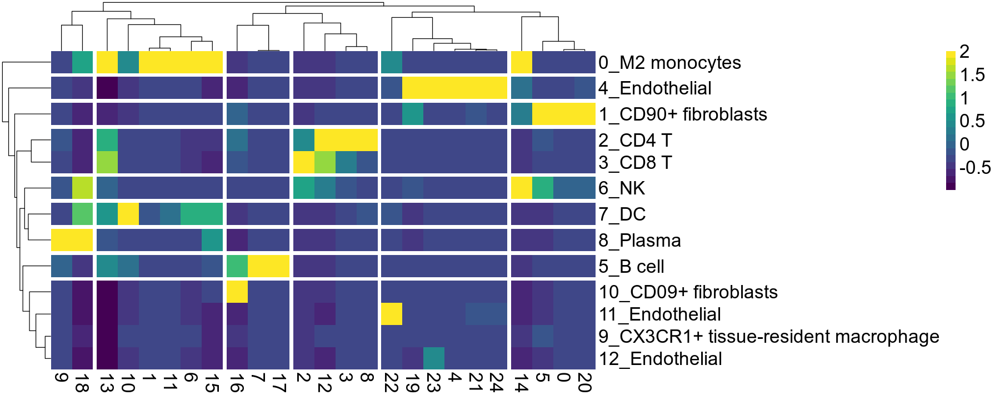

In [53]:
# heatmap with mRNA clusters in rows, protein clusters in columns
# scaled by column: most red square in a column is mRNA cluster with most cells from that protein cluster
library(pheatmap)

mat_breaks <- seq(min(mrna_adt_intersect), max(mrna_adt_intersect), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(mrna_adt_intersect, n = 10)

scale_rows <- function(x) t(scale(t(x)))
mat <- scale_rows(mrna_adt_intersect) # Z-score
mat[mat > 2] <- 2
mat[mat < -2] <- -2

options(repr.plot.width = 15, repr.plot.height = 6)
pheatmap(
  mat = t(mat),
  border_color = NA,
#   breaks  = mat_breaks,
  color  = viridis(20),
  show_rownames = TRUE,
  show_colnames = TRUE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 9,
  cutree_cols = 6,
#   annotation_col = annotation_col,
#   annotation_colors = meta_colors,
  fontsize = 20,
  fontsize_row = 20
#   scale = "none"
)

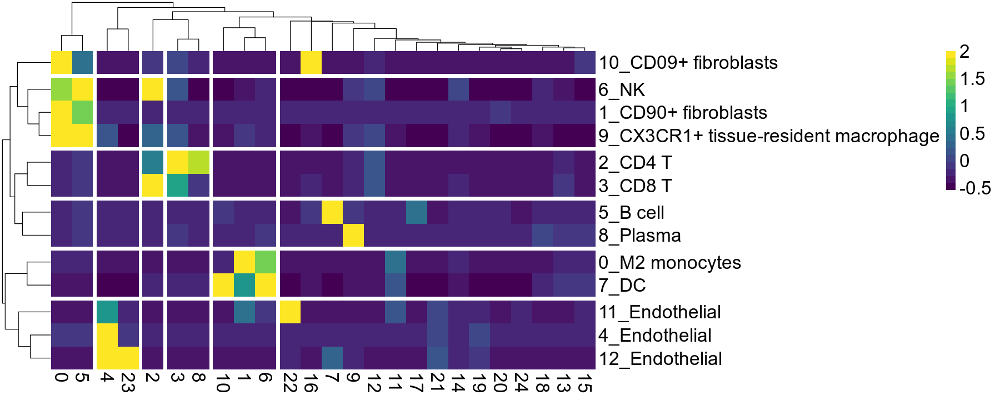

In [54]:
# heatmap with mRNA clusters in rows, protein clusters in columns
# scaled by column: most red square in a column is mRNA cluster with most cells from that protein cluster
library(pheatmap)

mat_breaks <- seq(min(mrna_adt_intersect), max(mrna_adt_intersect), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(mrna_adt_intersect, n = 10)

scale_rows <- function(x) t(scale(t(x)))
mat <- scale(mrna_adt_intersect) # Z-score
mat[mat > 2] <- 2
mat[mat < -2] <- -2

options(repr.plot.width = 15, repr.plot.height = 6)
pheatmap(
  mat = t(mat),
  border_color = NA,
#   breaks  = mat_breaks,
  color  = viridis(20),
  show_rownames = TRUE,
  show_colnames = TRUE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 6,
  cutree_cols = 6,
#   annotation_col = annotation_col,
#   annotation_colors = meta_colors,
  fontsize = 20,
  fontsize_row = 20
#   scale = "none"
)

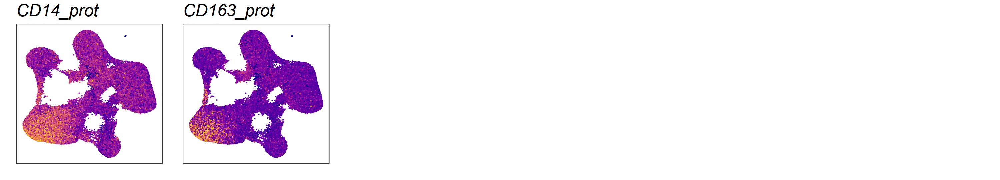

In [6]:
# adt_exprs_norm <- readRDS("adt_exprs_norm_2020-01-25.rds")
# meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_site_anno_hpca_2020-03-31.rds")
# all(colnames(adt_exprs_norm) == meta_all$cell)


plot_protein <- c("CD14_prot", "CD163_prot")

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = UMAP1_adt, y = UMAP2_adt)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 4.5, repr.plot.width = 25)
p <- do.call("grid.arrange", c(myplots, ncol = 6))

# 4: endothelial 
# 0: monocytes
# 

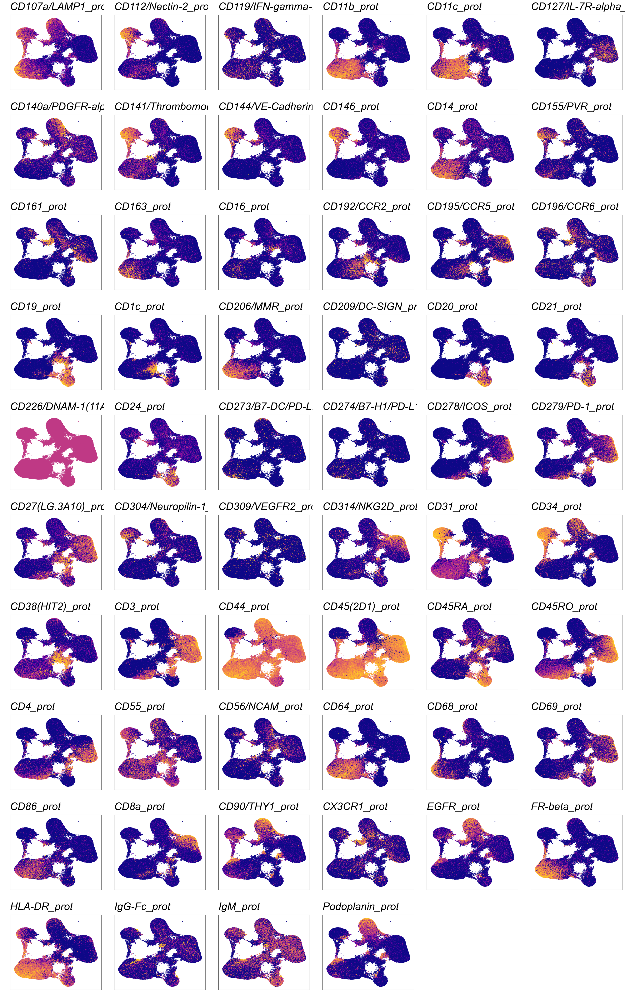

In [103]:
# “This is what the protein looks like, no filtering” to show that different markers have different levels of background

plot_protein <- rownames(adt_exprs_norm_filter)

myplots <- list()
for (i in 1:length(plot_protein)) {
  gene <- plot_protein[i]
    
    max.cutoff = quantile(adt_exprs_norm_filter[gene,], .99)
    min.cutoff = quantile(adt_exprs_norm_filter[gene,], .01)

    tmp <- sapply(X = adt_exprs_norm_filter[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = UMAP1_adt, y = UMAP2_adt)) + 
      geom_point(mapping = aes(color = gene), size = 0.1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face = "italic"), # face="bold.italic"
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 40, repr.plot.width = 25)
p <- do.call("grid.arrange", c(myplots, ncol = 6))

# 4: endothelial 
# 0: monocytes
# 

# LISI: (Local inverse Simpson’s index): measures degree of batch mixing in a low-dimensional embedding
#### "Instead of a fixed number of nearest neighbors as in the case of kBET, LISI selects the nearest neighbors based on the local distribution of distances with a fixed perplexity"
#### "The selected neighbors are then used to compute the inverse Simpson’s index for diversity, which is the effective number of types present in this neighborhood"

In [6]:
library(lisi)

# exprs_norm <- readRDS("qc_mRNA_exprs_2020-01-24.rds")
meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_site_anno_hpca_2020-02-23.rds")
# adt_exprs_norm_filter <- readRDS("adt_exprs_norm_filter_2020-02-18.rds")

In [17]:
# rand_cell <- sample(colnames(exprs_norm), 200000, replace = FALSE, prob = NULL)
# length(rand_cell)

# genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
# vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 0.7e3)
# var_genes <- vargenes_df$gene
# length(var_genes)

[1] 200000

[1] 2717

In [19]:
# all(colnames(exprs_norm) == meta_all$cell)

[1] TRUE

In [29]:
# # 100 cells x 50 genes
# x <- as.matrix(t(exprs_norm[var_genes, rand_cell]))
# x_meta_all <- meta_all[which(meta_all$cell %in% rand_cell),]
# x_meta_all <- x_meta_all[ order(match(x_meta_all$cell, rownames(x))), ]
# all(rownames(x) == x_meta_all$cell)
# x_meta_all[1:4,]
# x[1:4,1:4]

[1] TRUE

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,⋯,protein_harmonized_PC18,protein_harmonized_PC19,protein_harmonized_PC20,UMAP1_adt,UMAP2_adt,res_0.20_adt,res_0.40_adt,hpca_anno,hpca_anno_fine,site
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>
293110,BRI-517_TTTATGCAGCCTGGAA,BRI-517,16378,3531,0.18671388,0.04451093,2.024694,-2.303153,0.08587336,0.4257486,⋯,0.01967718,-0.7426361,0.12517734,-8.8495244,-4.917991,0,2,Macrophage:monocyte-derived:IL-4/Dex/cntrl,Macrophage:monocyte-derived:IL-4/Dex/cntrl,Pittsburgh
130208,BRI-458_ACTGTGAGTGTTTACG,BRI-458,21281,1882,0.05342794,0.04163338,-4.880063,-4.650310,0.14563511,-0.3326298,⋯,0.41186307,0.2135384,-1.18948414,0.3368266,-1.063916,8,9,B_cell:Plasma_cell,B_cell:Plasma_cell,Columbia
529449,BRI-615_CCGGTGACAGGTGGAT,BRI-615,7909,2411,0.07004678,0.20900240,-9.020907,6.787026,0.27304784,-0.2224431,⋯,-0.11009270,0.2764722,0.46167416,8.6515347,1.276128,3,3,T_cell:CD4+_effector_memory,T_cell:CD4+_effector_memory,UC_San_Diego
158255,BRI-460_TTCAATCCAGCTACAT,BRI-460,13455,1691,0.08004459,0.11334077,-4.483989,-4.085734,0.13394237,-0.3083322,⋯,-0.30564838,-0.9187436,0.05095111,4.0748670,-9.180665,5,6,GMP,GMP,HSS


,HSPA1A,CD9,CD63,ITM2B
BRI-517_TTTATGCAGCCTGGAA,1,0,28,15
BRI-458_ACTGTGAGTGTTTACG,0,2,3,0
BRI-615_CCGGTGACAGGTGGAT,1,0,5,7
BRI-460_TTCAATCCAGCTACAT,0,0,6,1


In [7]:
# dim(x)
# dim(x_meta_all)
# colnames(x_meta_all)
# table(x_meta_all$sample)
# table(x_meta_all$site)

In [15]:
colnames(meta_all[,c(57:76)])

[1] "protein_harmonized_PC1"  "protein_harmonized_PC2" 
 [3] "protein_harmonized_PC3"  "protein_harmonized_PC4" 
 [5] "protein_harmonized_PC5"  "protein_harmonized_PC6" 
 [7] "protein_harmonized_PC7"  "protein_harmonized_PC8" 
 [9] "protein_harmonized_PC9"  "protein_harmonized_PC10"
[11] "protein_harmonized_PC11" "protein_harmonized_PC12"
[13] "protein_harmonized_PC13" "protein_harmonized_PC14"
[15] "protein_harmonized_PC15" "protein_harmonized_PC16"
[17] "protein_harmonized_PC17" "protein_harmonized_PC18"
[19] "protein_harmonized_PC19" "protein_harmonized_PC20"

In [17]:
# res <- compute_lisi(x, x_meta_all, c("sample", "site"), perplexity=30, nn_eps=0)
# saveRDS(res, "lisi_res_mRNA.rds")

lisi_res <- rbind(
    lisi::compute_lisi(meta_all[, c(29:48)], meta_all, c('sample', 'site')) %>% 
        dplyr::mutate(type = 'mRNA_harmony'),
    lisi::compute_lisi(meta_all[, c(9:28)], meta_all, c('sample', 'site')) %>% 
        dplyr::mutate(type = 'pca'),
    lisi::compute_lisi(meta_all[, c(57:76)], meta_all, c('sample', 'site')) %>% 
        dplyr::mutate(type = 'protein_harmony')
) %>% 
    tidyr::gather(key, val, site, sample)

saveRDS(lisi_res, "lisi_mRNA_protein_harmonized_2020-02-23.rds")

In [18]:
lisi_res[1:4,]

,type,key,val
,<chr>,<chr>,<dbl>
1,mRNA_harmony,site,1.127976
2,mRNA_harmony,site,2.391587
3,mRNA_harmony,site,1.787361
4,mRNA_harmony,site,4.725662


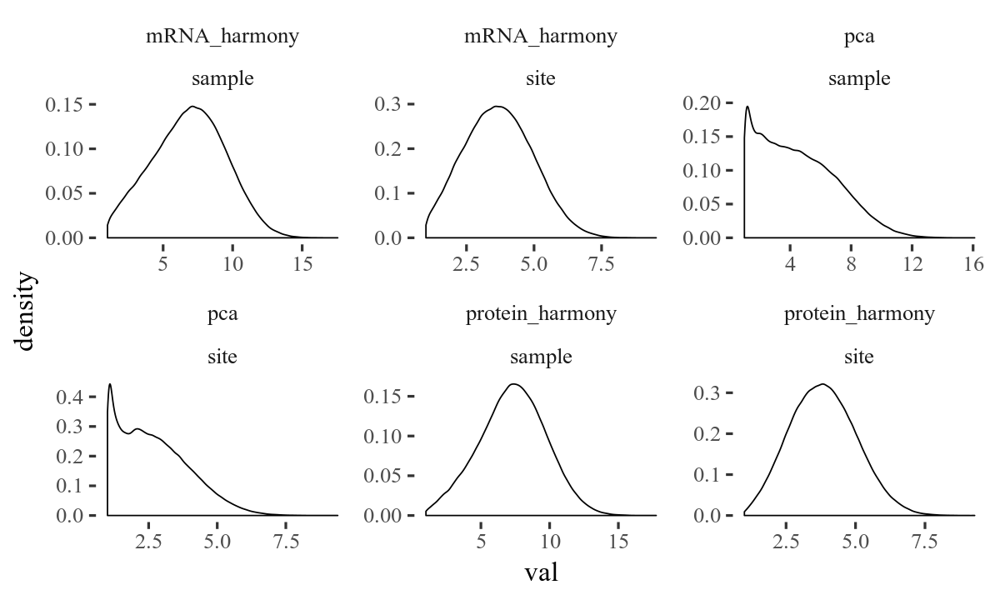

In [20]:
fig.size(6, 10)
lisi_res %>% 
    ggplot(aes(val)) + 
        geom_density() + 
        facet_wrap(~type + key, scales = 'free') + 
        theme_tufte(base_size = 20) 
#         xlim(1, 2)

In [38]:
lisi_res$type[which(lisi_res$type == "mRNA_harmony")] <- "mRNA_harmonized_pc"
lisi_res$type[which(lisi_res$type == "pca")] <- "mRNA_pc"
lisi_res$type[which(lisi_res$type == "protein_harmony")] <- "protein_harmonized_pc"

Warning message:
“Removed 1413 rows containing non-finite values (stat_density).”
Warning message:
“Removed 329 rows containing non-finite values (stat_density).”


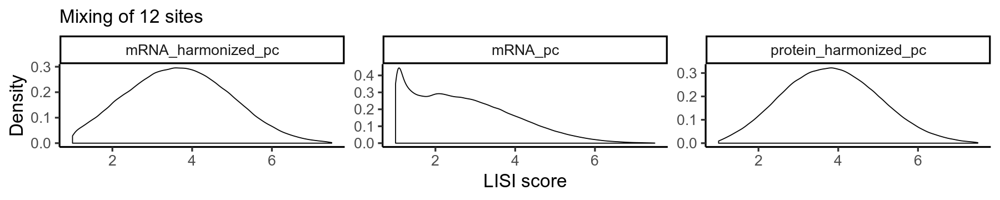

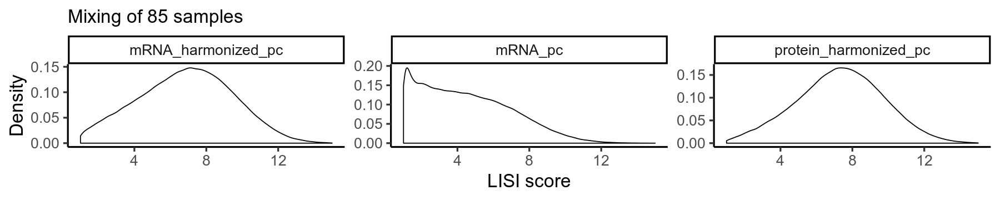

In [40]:
options(repr.plot.height = 3, repr.plot.width = 15)

ggplot(lisi_res[which(lisi_res$key == "site"),]) +
    geom_density(
        aes(x  = val)
    ) +
    facet_wrap(~type, scales = 'free') + 
  scale_x_continuous(limits = c(1, 7.5))+
  labs(
      x = "LISI score",
      y = "Density",
      title = paste0("Mixing of ", length(table(meta_all$site))," sites", sep="")
      ) +
  theme_classic(base_size = 20) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=20)
  )

ggplot(lisi_res[which(lisi_res$key == "sample"),]) +
    geom_density(
        aes(x  = val)
    ) +
    facet_wrap(~type, scales = 'free') + 
  scale_x_continuous(limits = c(1, 15))+
  labs(
      x = "LISI score",
      y = "Density",
      title = paste0("Mixing of ", length(table(meta_all$sample))," samples", sep="")
      ) +
  theme_classic(base_size = 20) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=20)
  )


In [23]:
meta_all[1:4,]

,cell,sample,nUMI,nGene,percent_mito,percent.ribo,UMAP1,UMAP2,PC1,PC2,...,protein_harmonized_PC17,protein_harmonized_PC18,protein_harmonized_PC19,protein_harmonized_PC20,UMAP1_adt,UMAP2_adt,res_0.20_adt,res_0.40_adt,hpca_anno,hpca_anno_fine
1,BRI-399_AAACCCAAGTCATTGC,BRI-399,7959,2497,0.15165222,0.13041839,6.6981000,-5.381405,-0.3571995,-0.0390370210,...,-0.46274513,0.2740286,0.57389824,-0.3256205,0.9773253,6.577851,1,0,Chondrocytes:MSC-derived,Chondrocytes:MSC-derived
2,BRI-399_AAACCCAAGTGAATAC,BRI-399,8601,3055,0.06522497,0.07836298,0.4673366,-9.940085,-0.2261091,-0.0163840411,...,0.07783091,-0.3393538,1.04008517,-0.8825261,-6.2643149,5.037686,4,4,iPS_cells:adipose_stem_cells,iPS_cells:adipose_stem_cells
4,BRI-399_AAACCCACAGTCCGTG,BRI-399,13897,3833,0.07922573,0.14082176,6.9872802,-7.038188,-0.4850761,0.0008679194,...,0.99959744,2.8541640,-0.25334417,-0.2337399,-2.2928325,-4.808373,7,5,Smooth_muscle_cells:bronchial,Smooth_muscle_cells:bronchial
5,BRI-399_AAACCCAGTAGGAGGG,BRI-399,33644,5515,0.08474022,0.18550113,4.7951625,3.897222,0.2578570,0.3665536689,...,-0.01426637,-1.3839181,0.02315231,0.1476639,-4.0102350,-5.385874,0,5,Monocyte:CD16-,Monocyte:CD16-


ERROR while rich displaying an object: Error: Continuous value supplied to discrete scale

Traceback:
1. FUN(X[[i]], ...)
2. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
3. tryCatchList(expr, classes, parentenv, handlers)
4. tryCatchOne(expr, names, parentenv, handlers[[1L]])
5. doTryCatch(return(expr), name, parentenv, handler)
6. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
7. repr::mime2repr[[mime]](obj)
8. repr_text.default(obj)
9. paste(cap

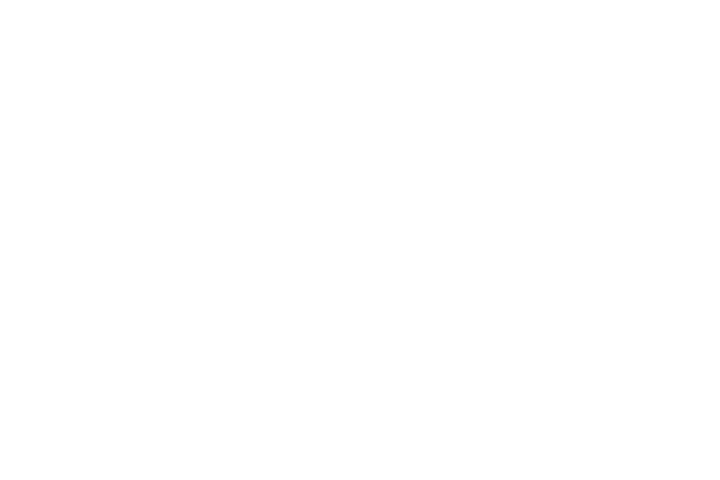

In [43]:
meta_all$res_0.60 <- as.character(meta_all$res_0.60)
meta_all$res_0.20_adt <- as.character(meta_all$res_0.20_adt)

options(repr.plot.height = 4, repr.plot.width = 6)
ggplot() +
#   geom_point(
#     data = meta_all[sample(nrow(meta_all)),],
#     mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "res_0.60"),
#     size = 0.1, stroke = 0.0001, shape = 21
#   ) +
  geom_point(
    data = meta_all[sample(nrow(meta_all)),], # meta_all[which(meta_all$res_0.20_adt == 9),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "res_0.20_adt"),
    size = 0.2, stroke = 0.0001, shape = 22
  ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1_mRNA",
      y = "UMAP2_mRNA"
      ) +
  theme_bw(base_size = 20) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=20)
  ) 

## More ADT denoising

In [3]:
meta_all <- readRDS("qc_mRNA_protein_pca_umap_clus_meta_all_site_anno_hpca_2020-03-31.rds")
adt_exprs_norm <- readRDS("adt_exprs_norm_2020-01-25.rds")
adt_exprs <- readRDS("adt_exprs_2020-01-24.rds")
adt_exprs <- adt_exprs[, colnames(adt_exprs_norm)]
all(meta_all$cell == colnames(adt_exprs))

[1] TRUE

In [4]:
adt_exprs_norm_filter <- readRDS("adt_exprs_norm_filter_2020-02-18.rds")

In [5]:
# add a density gradient on the points () this is helpful when there are many thousands of cells )
# this density function is from this blog post: https://slowkow.com/notes/ggplot2-color-by-density/
get_density = function(x, y, ...) {
  dens <- MASS::kde2d(x, y, ...)
  ix <- findInterval(x, dens$x)
  iy <- findInterval(y, dens$y)
  ii <- cbind(ix, iy)
  return(dens$z[ii])
}


In [40]:
adt_exprs_scaled <- adt_exprs_norm[rowSums(adt_exprs_norm) > 0,] %>% singlecellmethods::scaleData() 

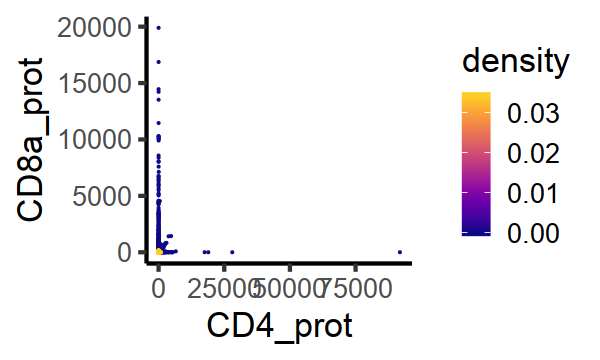

In [62]:
meta_all$CD8a_prot <- adt_exprs["CD8a_prot",]
meta_all$CD4_prot <- adt_exprs["CD4_prot",]
meta_all$CD3_prot <- adt_exprs["CD3_prot",]

fig.size(3,5)
plot_dens <- get_density(meta_all$CD4_prot, meta_all$CD8a_prot, n = 100)
ggplot(meta_all, aes(x = CD4_prot, y = CD8a_prot, color = plot_dens)) +
    geom_point(size = 0.1) +
    scale_color_viridis(option = "plasma", end = .9) +
    labs(color = "density") +
    theme_classic(base_size = 20) +
    theme(
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

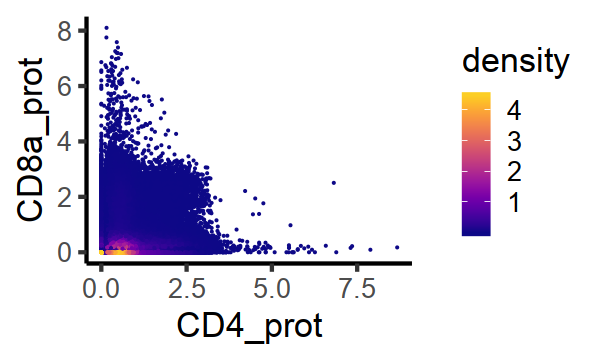

In [61]:
meta_all$CD8a_prot <- adt_exprs_norm["CD8a_prot",]
meta_all$CD4_prot <- adt_exprs_norm["CD4_prot",]
meta_all$CD3_prot <- adt_exprs_norm["CD3_prot",]

fig.size(3,5)
plot_dens <- get_density(meta_all$CD4_prot, meta_all$CD8a_prot, n = 100)
ggplot(meta_all, aes(x = CD4_prot, y = CD8a_prot, color = plot_dens)) +
    geom_point(size = 0.1) +
    scale_color_viridis(option = "plasma", end = .9) +
    labs(color = "density") +
    theme_classic(base_size = 20) +
    theme(
      panel.grid = element_blank(),
      plot.title = element_text(color="black", size=22, face = "italic")
     )

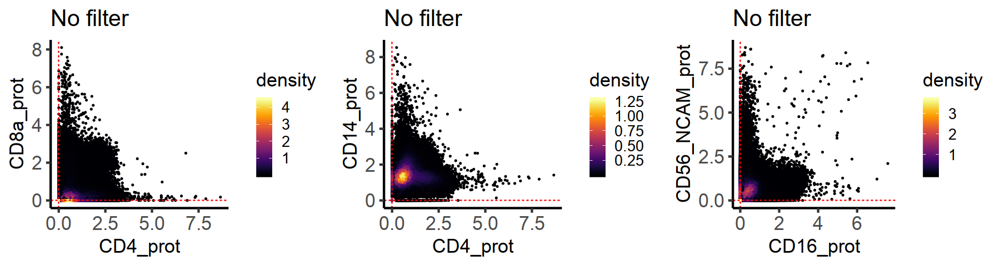

In [22]:
library(ggplot2)
data.plot = adt_exprs_norm %>% t %>%
  as.data.frame() %>% 
  dplyr::select("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56/NCAM_prot") 

colnames(data.plot) <- c("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56_NCAM_prot") 

data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD4_prot, data.plot$CD8a_prot, n = 100)) 
p1 = ggplot(data.plot, aes(x = CD4_prot, y = CD8a_prot, color = density)) +
  geom_point(size = 0.4) + theme_bw() + ggtitle("No filter") +
  geom_vline(xintercept = 0, color = "red", linetype = 2) + 
  geom_hline(yintercept = 0, color = "red", linetype = 2) + 
  theme_classic(base_size = 20) +
  theme(axis.text = element_text(size = 20)) +
  viridis::scale_color_viridis(option = "B") +  
  scale_shape_identity() 


data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD4_prot, data.plot$CD14_prot, n = 100)) 
p2 = ggplot(data.plot, aes(x = CD4_prot, y = CD14_prot, color = density)) +
  geom_point(size = 0.4) + theme_bw() + ggtitle("No filter") +
  geom_vline(xintercept = 0, color = "red", linetype = 2) + 
  geom_hline(yintercept = 0, color = "red", linetype = 2) + 
  theme_classic(base_size = 20) +
  theme(axis.text = element_text(size = 20)) +
  viridis::scale_color_viridis(option = "B") +  
  scale_shape_identity() 


data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD16_prot, data.plot$CD56_NCAM_prot, n = 100)) 
p3 = ggplot(data.plot, aes(x = CD16_prot, y = CD56_NCAM_prot, color = density)) +
  geom_point(size = 0.4) + theme_bw() + ggtitle("No filter") +
  geom_vline(xintercept = 0, color = "red", linetype = 2) + 
  geom_hline(yintercept = 0, color = "red", linetype = 2) + 
  theme_classic(base_size = 20) +
  theme(axis.text = element_text(size = 20)) +
  viridis::scale_color_viridis(option = "B") +  
  scale_shape_identity() 


fig.size(4, 15)
cowplot::plot_grid(p1, p2, p3, ncol = 3)

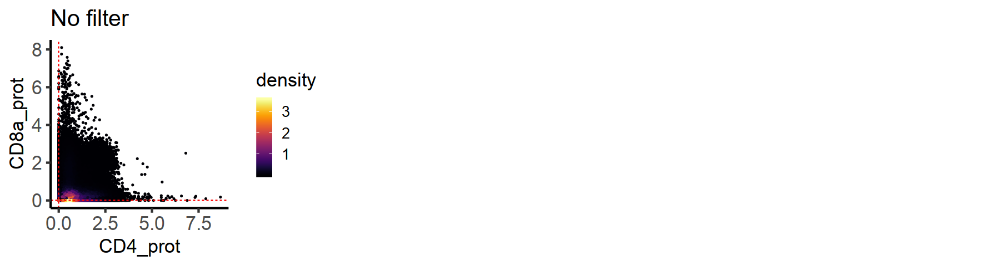

In [27]:
library(ggplot2)
data.plot = adt_exprs_norm %>% t %>%
  as.data.frame() %>% 
  dplyr::select("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56/NCAM_prot", "CD45(2D1)_prot", "CD3_prot") 

colnames(data.plot) <- c("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56_NCAM_prot", "CD45_prot", "CD3_prot") 
data.plot <- data.plot[which(data.plot$CD45_prot > 0 & data.plot$CD3_prot > 0),]

data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD4_prot, data.plot$CD8a_prot, n = 100)) 
p1 = ggplot(data.plot, aes(x = CD4_prot, y = CD8a_prot, color = density)) +
  geom_point(size = 0.4) + theme_bw() + ggtitle("No filter") +
  geom_vline(xintercept = 0, color = "red", linetype = 2) + 
  geom_hline(yintercept = 0, color = "red", linetype = 2) + 
  theme_classic(base_size = 20) +
  theme(axis.text = element_text(size = 20)) +
  viridis::scale_color_viridis(option = "B") +  
  scale_shape_identity() 

fig.size(4, 15)
cowplot::plot_grid(p1, ncol = 3)

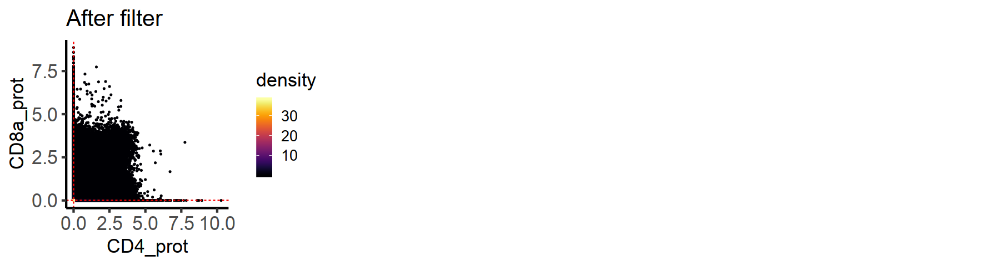

In [28]:
data.plot = adt_exprs_norm_filter %>% t %>%
  as.data.frame() %>% 
  dplyr::select("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56/NCAM_prot") 

colnames(data.plot) <- c("CD4_prot", "CD8a_prot", "CD14_prot", "CD16_prot", "CD56_NCAM_prot") 

data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD4_prot, data.plot$CD8a_prot, n = 500)) 
p1 = ggplot(data.plot, aes(x = CD4_prot, y = CD8a_prot, color = density)) +
  geom_point(size = 0.4) + theme_bw() + ggtitle("After filter") +
  geom_vline(xintercept = 0, color = "red", linetype = 2) + 
  geom_hline(yintercept = 0, color = "red", linetype = 2) + 
  theme_classic(base_size = 20) +
  theme(axis.text = element_text(size = 20)) +
  viridis::scale_color_viridis(option = "B") +  
  scale_shape_identity() 


# data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD4_prot, data.plot$CD14_prot, n = 100)) 
# p2 = ggplot(data.plot, aes(x = CD4_prot, y = CD14_prot, color = density)) +
#   geom_point(size = 0.4) + theme_bw() + ggtitle("After filter") +
#   geom_vline(xintercept = 0, color = "red", linetype = 2) + 
#   geom_hline(yintercept = 0, color = "red", linetype = 2) + 
#   theme_classic(base_size = 20) +
#   theme(axis.text = element_text(size = 20)) +
#   viridis::scale_color_viridis(option = "B") +  
#   scale_shape_identity() 


# data.plot = data.plot %>% dplyr::mutate(density = get_density(data.plot$CD16_prot, data.plot$CD56_NCAM_prot, n = 100)) 
# p3 = ggplot(data.plot, aes(x = CD16_prot, y = CD56_NCAM_prot, color = density)) +
#   geom_point(size = 0.4) + theme_bw() + ggtitle("After filter") +
#   geom_vline(xintercept = 0, color = "red", linetype = 2) + 
#   geom_hline(yintercept = 0, color = "red", linetype = 2) + 
#   theme_classic(base_size = 20) +
#   theme(axis.text = element_text(size = 20)) +
#   viridis::scale_color_viridis(option = "B") +  
#   scale_shape_identity() 


fig.size(4, 15)
cowplot::plot_grid(p1, ncol = 3)

,CD4,CD8,nonzero
BRI-399_AAACCCAAGTCATTGC,0.6061167,0.0000000,FALSE
BRI-399_AAACCCAAGTGAATAC,0.2056513,0.2056513,TRUE
BRI-399_AAACCCACAGTCCGTG,0.8710485,0.4193881,TRUE
BRI-399_AAACCCAGTAGGAGGG,0.3885697,0.1121829,TRUE


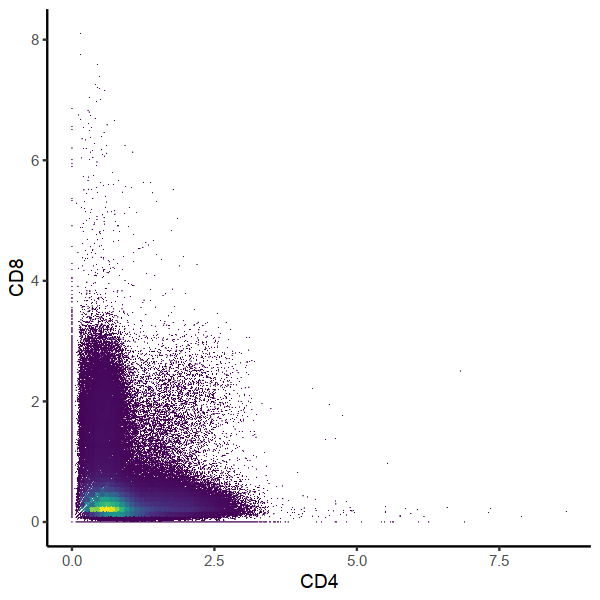

In [8]:
library(ggrastr)

fig.size(5,5)

# Select CD4 and CD8 expression just for cell type of interest (here, for alpha beta T cells)
tmp <- data.frame(CD4 = adt_exprs_norm["CD4_prot", ], 
                         CD8 = adt_exprs_norm["CD8a_prot", ])						 
# # Remove 0 values
tmp$nonzero <- tmp$CD4 != 0 & tmp$CD8 != 0
tmp[1:4, ]

# Calculate density for just nonzero values (and set density for zero values equal to 0)
plot_dens <- get_density(tmp[tmp$nonzero,1], tmp[tmp$nonzero,2], n = 100)
tmp$dens <- 0
tmp$dens[tmp$nonzero] <- plot_dens

# Plot
ggplot(data = tmp, 
       aes(x = CD4, y = CD8, col = dens)) +
    geom_point_rast(shape = ".") +
    theme_classic() + theme(legend.position = "NA") +
#     geom_vline(xintercept = 1.5, color = "darkred", size = .2) +
#     geom_hline(yintercept = 1,color = "darkred", size = .2) + geom_hline(yintercept = 1.75, color = "darkred", size = .2) +
  scale_color_viridis()

,CD4,CD8,CD3,nonzero
BRI-399_AAACCCAAGTCATTGC,0.6061167,0.0000000,0.2451133,FALSE
BRI-399_AAACCCAAGTGAATAC,0.2056513,0.2056513,0.3761390,TRUE
BRI-399_AAACCCACAGTCCGTG,0.8710485,0.4193881,0.0000000,FALSE
BRI-399_AAACCCAGTAGGAGGG,0.3885697,0.1121829,0.2130406,TRUE


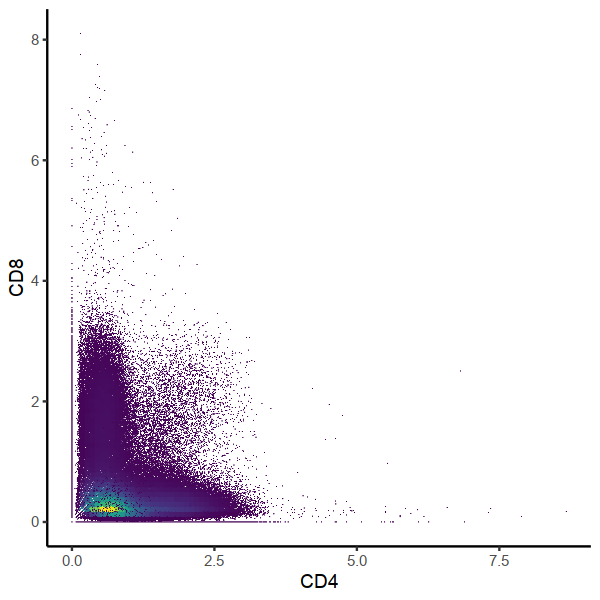

In [12]:
library(ggrastr)

fig.size(5,5)

# Select CD4 and CD8 expression just for cell type of interest (here, for alpha beta T cells)
tmp <- data.frame(CD4 = adt_exprs_norm["CD4_prot", ], 
                  CD8 = adt_exprs_norm["CD8a_prot", ],
                  CD3 = adt_exprs_norm["CD3_prot", ]              
                 )						 
# # Remove 0 values
tmp$nonzero <- tmp$CD4 != 0 & tmp$CD8 != 0 & tmp$CD3 != 0
tmp[1:4, ]

# Calculate density for just nonzero values (and set density for zero values equal to 0)
plot_dens <- get_density(tmp[tmp$nonzero,1], tmp[tmp$nonzero,2], n = 100)
tmp$dens <- 0
tmp$dens[tmp$nonzero] <- plot_dens

# Plot
ggplot(data = tmp, 
       aes(x = CD4, y = CD8, col = dens)) +
    geom_point_rast(shape = ".") +
    theme_classic() + theme(legend.position = "NA") +
#     geom_vline(xintercept = 1.5, color = "darkred", size = .2) +
#     geom_hline(yintercept = 1,color = "darkred", size = .2) + geom_hline(yintercept = 1.75, color = "darkred", size = .2) +
  scale_color_viridis()

,CD4,CD8,nonzero
BRI-399_AAACCCAAGTCATTGC,0.000000,0.0000000,FALSE
BRI-399_AAACCCAAGTGAATAC,0.000000,0.0000000,FALSE
BRI-399_AAACCCACAGTCCGTG,0.490873,0.3857172,TRUE
BRI-399_AAACCCAGTAGGAGGG,0.000000,0.0000000,FALSE


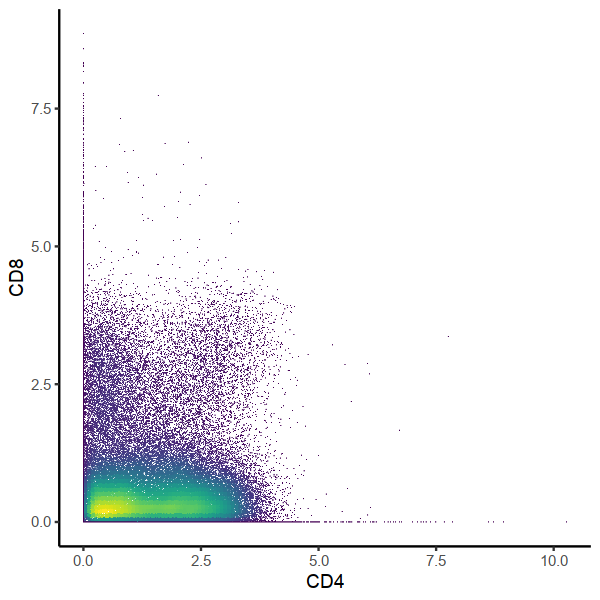

In [9]:
library(ggrastr)

fig.size(5,5)

# Select CD4 and CD8 expression just for cell type of interest (here, for alpha beta T cells)
tmp <- data.frame(CD4 = adt_exprs_norm_filter["CD4_prot", ], 
                  CD8 = adt_exprs_norm_filter["CD8a_prot", ])						 
# # Remove 0 values
tmp$nonzero <- tmp$CD4 != 0 & tmp$CD8 != 0
tmp[1:4, ]

# Calculate density for just nonzero values (and set density for zero values equal to 0)
plot_dens <- get_density(tmp[tmp$nonzero,1], tmp[tmp$nonzero,2], n = 100)
tmp$dens <- 0
tmp$dens[tmp$nonzero] <- plot_dens

# Plot
ggplot(data = tmp, 
       aes(x = CD4, y = CD8, col = dens)) +
    geom_point_rast(shape = ".") +
    theme_classic() + theme(legend.position = "NA") +
#     geom_vline(xintercept = 1.5, color = "darkred", size = .2) +
#     geom_hline(yintercept = 1,color = "darkred", size = .2) + geom_hline(yintercept = 1.75, color = "darkred", size = .2) +
  scale_color_viridis()

,CD16,CD56,nonzero
BRI-399_AAACCCAAGTCATTGC,0.2451133,0.9808030,TRUE
BRI-399_AAACCCAAGTGAATAC,0.0000000,0.9548473,FALSE
BRI-399_AAACCCACAGTCCGTG,0.2981425,0.7139597,TRUE
BRI-399_AAACCCAGTAGGAGGG,0.1638827,0.3885697,TRUE


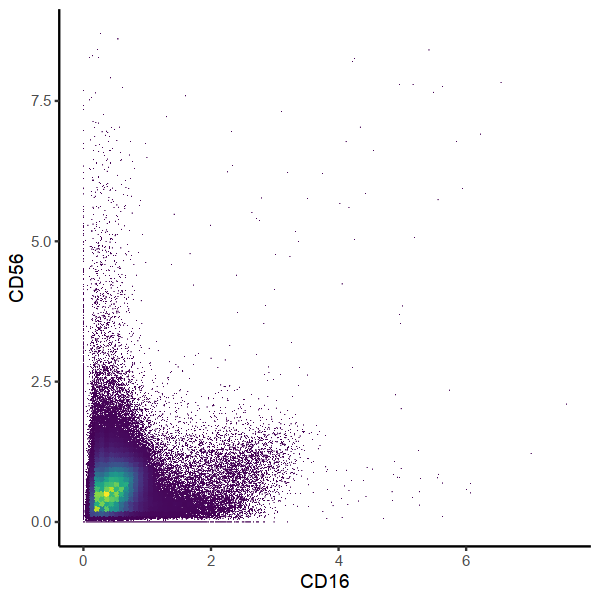

In [25]:
library(ggrastr)

fig.size(5,5)

# Select CD4 and CD8 expression just for cell type of interest (here, for alpha beta T cells)
tmp <- data.frame(CD16 = adt_exprs_norm["CD16_prot", ], 
                  CD56 = adt_exprs_norm["CD56/NCAM_prot", ]       
                 )						 
# # Remove 0 values
tmp$nonzero <- tmp$CD16 != 0 & tmp$CD56 != 0
tmp[1:4, ]

# Calculate density for just nonzero values (and set density for zero values equal to 0)
plot_dens <- get_density(tmp[tmp$nonzero,1], tmp[tmp$nonzero,2], n = 100)
tmp$dens <- 0
tmp$dens[tmp$nonzero] <- plot_dens

# Plot
ggplot(data = tmp, 
       aes(x = CD16, y = CD56, col = dens)) +
    geom_point_rast(shape = ".") +
    theme_classic() + theme(legend.position = "NA") +
#     geom_vline(xintercept = 1.5, color = "darkred", size = .2) +
#     geom_hline(yintercept = 1,color = "darkred", size = .2) + geom_hline(yintercept = 1.75, color = "darkred", size = .2) +
  scale_color_viridis()

,CD16,CD56,nonzero
BRI-399_AAACCCAAGTCATTGC,0,0.9129727,FALSE
BRI-399_AAACCCAAGTGAATAC,0,0.9082707,FALSE
BRI-399_AAACCCACAGTCCGTG,0,0.1786364,FALSE
BRI-399_AAACCCAGTAGGAGGG,0,0.0000000,FALSE


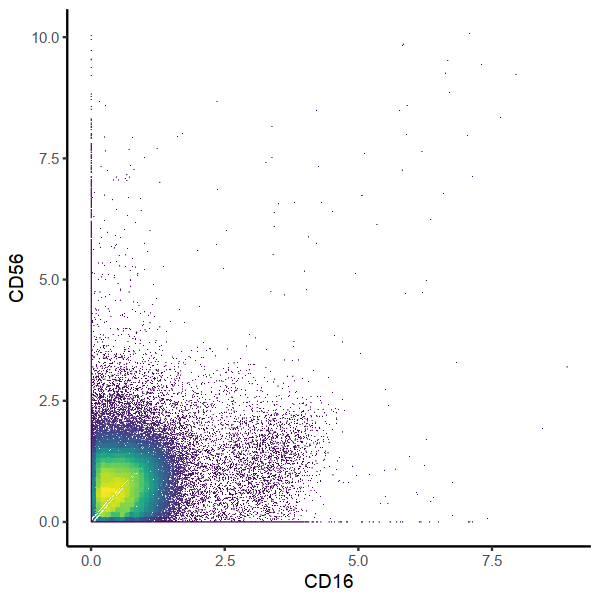

In [26]:
library(ggrastr)

fig.size(5,5)

# Select CD4 and CD8 expression just for cell type of interest (here, for alpha beta T cells)
tmp <- data.frame(CD16 = adt_exprs_norm_filter["CD16_prot", ], 
                  CD56 = adt_exprs_norm_filter["CD56/NCAM_prot", ]       
                 )						 
# # Remove 0 values
tmp$nonzero <- tmp$CD16 != 0 & tmp$CD56 != 0
tmp[1:4, ]

# Calculate density for just nonzero values (and set density for zero values equal to 0)
plot_dens <- get_density(tmp[tmp$nonzero,1], tmp[tmp$nonzero,2], n = 100)
tmp$dens <- 0
tmp$dens[tmp$nonzero] <- plot_dens

# Plot
ggplot(data = tmp, 
       aes(x = CD16, y = CD56, col = dens)) +
    geom_point_rast(shape = ".") +
    theme_classic() + theme(legend.position = "NA") +
#     geom_vline(xintercept = 1.5, color = "darkred", size = .2) +
#     geom_hline(yintercept = 1,color = "darkred", size = .2) + geom_hline(yintercept = 1.75, color = "darkred", size = .2) +
  scale_color_viridis()

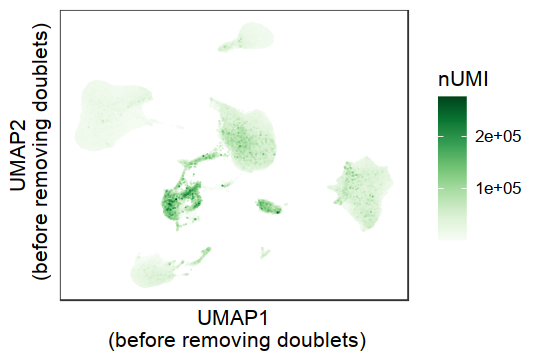

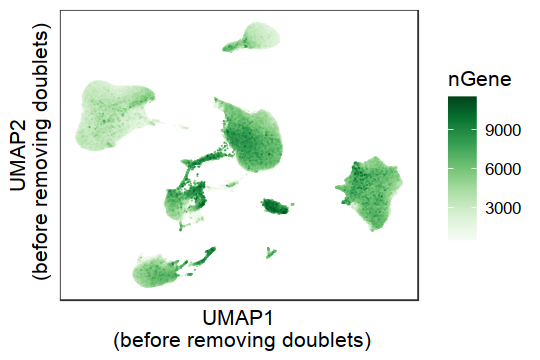

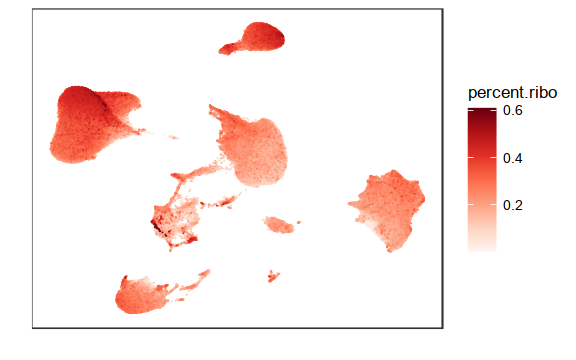

In [33]:
options(repr.plot.height = 3, repr.plot.width = 4.5)
ggplot() +
  geom_point(
    data = meta_all[order(meta_all$nUMI),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "nUMI"),
    size = 0.3, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Greens"))(7)[1:7],
      name = "nUMI"
  ) +
  labs(
      x = "UMAP1\n (before removing doublets)",
      y = "UMAP2\n (before removing doublets)"
      ) +
  theme_bw(base_size = 12) +
  theme(
#     legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )
ggsave(file = paste("all_nUMI", ".png", sep = ""), width = 4.8, height = 3, dpi = 300)


ggplot() +
  geom_point(
    data = meta_all[order(meta_all$nGene),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "nGene"),
    size = 0.3, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Greens"))(7)[1:7],
      name = "nGene"
  ) +
  labs(
      x = "UMAP1\n (before removing doublets)",
      y = "UMAP2\n (before removing doublets)"
      ) +
  theme_bw(base_size = 12) +
  theme(
#     legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )
ggsave(file = paste("all_nGene", ".png", sep = ""), width = 4.8, height = 3, dpi = 300)


options(repr.plot.height = 3, repr.plot.width = 4.8)
ggplot() +
  geom_point(
    data = meta_all[order(meta_all$percent.ribo),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "percent.ribo"),
    size = 0.3, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Reds"))(7)[1:7],
      name = "percent.ribo"
  ) +
  labs(
      x = "",
      y = ""
      ) +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )

In [22]:
# Load scrublet results from Joseph
# /data/srlab1/jmears/jupyter/2020-4-9-AMPCITESEQ/ScrubletDetection.ipynb
library(RcppCNPy)
meta_all <- readRDS("qc_pca_harmony_umap_clus_meta_all_2020-02-18.rds")
doublets <- npyLoad("/data/srlab1/jmears/jupyter/2020-4-9-AMPCITESEQ/doublet_scores_amp_all.npy")

In [23]:
meta_all$doublets <- doublets
colnames(meta_all)

[1] "cell"             "sample"           "nUMI"             "nGene"           
 [5] "percent_mito"     "percent.ribo"     "UMAP1"            "UMAP2"           
 [9] "PC1"              "PC2"              "PC3"              "PC4"             
[13] "PC5"              "PC6"              "PC7"              "PC8"             
[17] "PC9"              "PC10"             "PC11"             "PC12"            
[21] "PC13"             "PC14"             "PC15"             "PC16"            
[25] "PC17"             "PC18"             "PC19"             "PC20"            
[29] "harmonized_PC1"   "harmonized_PC2"   "harmonized_PC3"   "harmonized_PC4"  
[33] "harmonized_PC5"   "harmonized_PC6"   "harmonized_PC7"   "harmonized_PC8"  
[37] "harmonized_PC9"   "harmonized_PC10"  "harmonized_PC11"  "harmonized_PC12" 
[41] "harmonized_PC13"  "harmonized_PC14"  "harmonized_PC15"  "harmonized_PC16" 
[45] "harmonized_PC17"  "harmonized_PC18"  "harmonized_PC19"  "harmonized_PC20" 
[49] "harmonized_UMAP1" "harmonized_UMAP2" "gene"             "res_0.20"        
[53] "res_0.40"         "res_0.60"         "res_0.80"         "res_1.00"        
[57] "doublets"

In [ ]:
options(repr.plot.height = 3, repr.plot.width = 4.8)
ggplot() +
  geom_point(
    data = meta_all[order(meta_all$doublets),],
    mapping = aes_string(x = "harmonized_UMAP1", y = "harmonized_UMAP2", fill = "doublets"),
    size = 0.2, stroke = 0.0001, shape = 21
  ) +
  scale_fill_gradientn(
      colours = colorRampPalette(RColorBrewer::brewer.pal(9, "Greens"))(9)[1:9],
      name = "Doublet\nscore by\nScrublet"
  ) +
  labs(
      x = "UMAP1\n (before removing doublets)",
      y = "UMAP2\n (before removing doublets)"
      ) +
  theme_bw(base_size = 12) +
  theme(
#     legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )
ggsave(file = paste("all_scrublet_score", ".png", sep = ""), width = 4.8, height = 3, dpi = 300)

## Clustering on antibodies

In [204]:
table(meta_all$sample)


 BRI-399  BRI-401  BRI-403  BRI-405  BRI-407  BRI-409  BRI-411  BRI-413 
    8146     5610     4505     1085     2955     3354     2469     4229 
 BRI-415  BRI-417  BRI-419  BRI-421  BRI-425  BRI-427  BRI-429  BRI-431 
    8719     2372     4970    11950     1021    10182      982     1091 
 BRI-436  BRI-438  BRI-440  BRI-442  BRI-456  BRI-458  BRI-460  BRI-462 
    6661     2700     1386     3271     4644    11569    12618    13342 
 BRI-475  BRI-477  BRI-479  BRI-481  BRI-483  BRI-485  BRI-487  BRI-503 
    2510     2169    10603     1453      665     6037     9339      316 
 BRI-505  BRI-507  BRI-509  BRI-511  BRI-515  BRI-517  BRI-521  BRI-523 
    7857     8132      319     8513     9572    13932      714     5903 
 BRI-525  BRI-527  BRI-529  BRI-534  BRI-536  BRI-538  BRI-540  BRI-542 
   10196      380     3635      870      832     5257     9806     6159 
 BRI-544  BRI-546  BRI-548  BRI-550  BRI-552  BRI-554  BRI-556  BRI-558 
     348     2990     2620     6139     4190      

In [222]:
adt_exprs <- readRDS("/data/srlab/fzhang/amp/results/2020_01_22_AMP_cite_seq_QC/adt_exprs_2020-01-24.rds")

# meta_BRI_507 <- meta_all[which(meta_all$sample == "BRI-507"),] # BRI-507
# meta_BRI_507 <- meta_all[which(meta_all$sample == "BRI-399"),] # BRI-399
# meta_BRI_507 <- meta_all[which(meta_all$sample == "BRI-419"),] # BRI-419
meta_BRI_507 <- meta_all[which(meta_all$sample == "BRI-631"),] # BRI-631
dim(meta_BRI_507)
adt_exprs <- adt_exprs[, meta_BRI_507$cell]
dim(adt_exprs)
all(meta_BRI_507$cell == colnames(adt_exprs))

[1] 1004   86

[1]   58 1004

[1] TRUE

In [223]:
# Remove non-cell type specific antibodies for PCA: "CD31_prot", "CD44_prot", "CD45(2D1)_prot", "CD34_prot"
adt_exprs <- adt_exprs[-which(rownames(adt_exprs) %in% c("CD31_prot", "CD44_prot", "CD45(2D1)_prot", "CD34_prot", "HLA-DR_prot", "IgM_prot",
                                                        "CD119/IFN-gamma-R-alpha-chain_prot", "CD226/DNAM-1_prot", "CD38_prot", "CD107a/LAMP1_prot"
                                                        )),]
dim(adt_exprs)

[1]   50 1004

In [224]:
adt_exprs_norm <- t(adt_exprs) %>% singlecellmethods::normalizeData(method = "cellCLR")

In [225]:
# Scale expression to z-scores across cell types 
adt_exprs_scaled_t <- adt_exprs_norm %>% singlecellmethods::scaleData() 
adt_pca_res_t <- irlba::prcomp_irlba(t(adt_exprs_scaled_t), 20)
dim(adt_pca_res_t$x)

[1] 50 20

In [226]:
adt_pca <- as.data.frame(adt_pca_res_t$x)
res <- umap(adt_pca, n_neighbors = 50, metric = "cosine", min_dist = .3)
adt_pca$UMAP1_adt <- res$layout[, 1]
adt_pca$UMAP2_adt <- res$layout[, 2]


 Bad Good 
   6   44 

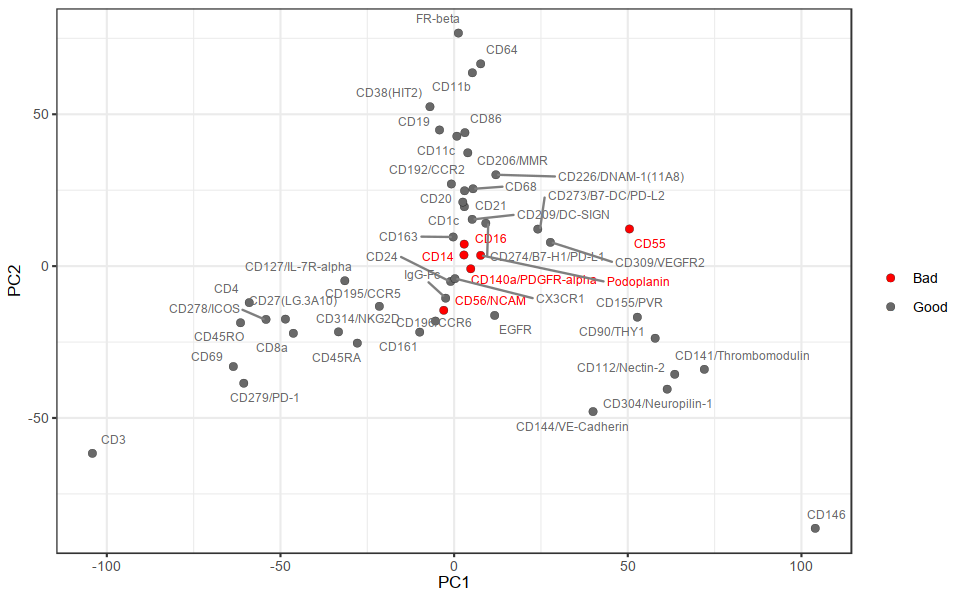

In [197]:
# BRI-507
adt_pca$antibody <- gsub("\\_.*","", rownames(adt_exprs)) 
adt_pca$highlight <- rep("Good", nrow(adt_pca))
adt_pca[which(adt_pca$antibody %in% c("CD14", "CD16", "Podoplanin", "CD140a/PDGFR-alpha", "CD14", "CD56/NCAM", "CD55")),]$highlight <- "Bad"
table(adt_pca$highlight)

options(repr.plot.height = 5, repr.plot.width = 8)
ggplot(adt_pca, aes(PC1, PC2, label = antibody, fill = highlight)) + 
  geom_point(size = 2, shape = 21, stroke = 0.1) +
  geom_text_repel(
    data = adt_pca,
    aes(label = antibody, color = highlight),
#     fontface = 'bold', 
    size = 2.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c("red", "dimgrey"), name = "") +
  scale_color_manual(values = c("red", "dimgrey"), name = "") +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )


 Bad Good 
   6   44 

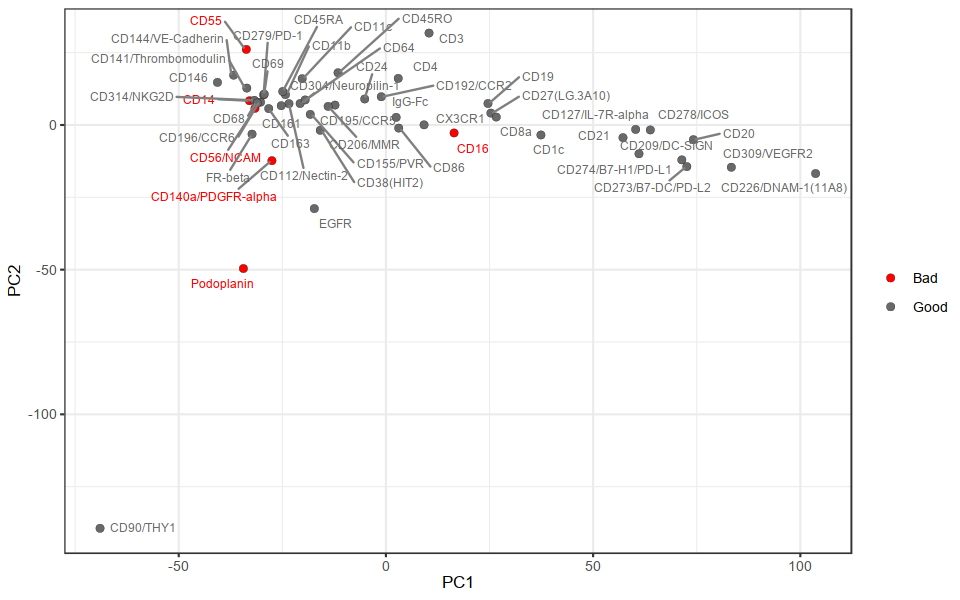

In [203]:
# BRI-399
adt_pca$antibody <- gsub("\\_.*","", rownames(adt_exprs)) 
adt_pca$highlight <- rep("Good", nrow(adt_pca))
adt_pca[which(adt_pca$antibody %in% c("CD14", "CD16", "Podoplanin", "CD140a/PDGFR-alpha", "CD14", "CD56/NCAM", "CD55")),]$highlight <- "Bad"
table(adt_pca$highlight)

options(repr.plot.height = 5, repr.plot.width = 8)
ggplot(adt_pca, aes(PC1, PC2, label = antibody, fill = highlight)) + 
  geom_point(size = 2, shape = 21, stroke = 0.1) +
  geom_text_repel(
    data = adt_pca,
    aes(label = antibody, color = highlight),
#     fontface = 'bold', 
    size = 2.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c("red", "dimgrey"), name = "") +
  scale_color_manual(values = c("red", "dimgrey"), name = "") +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )


 Bad Good 
   6   44 

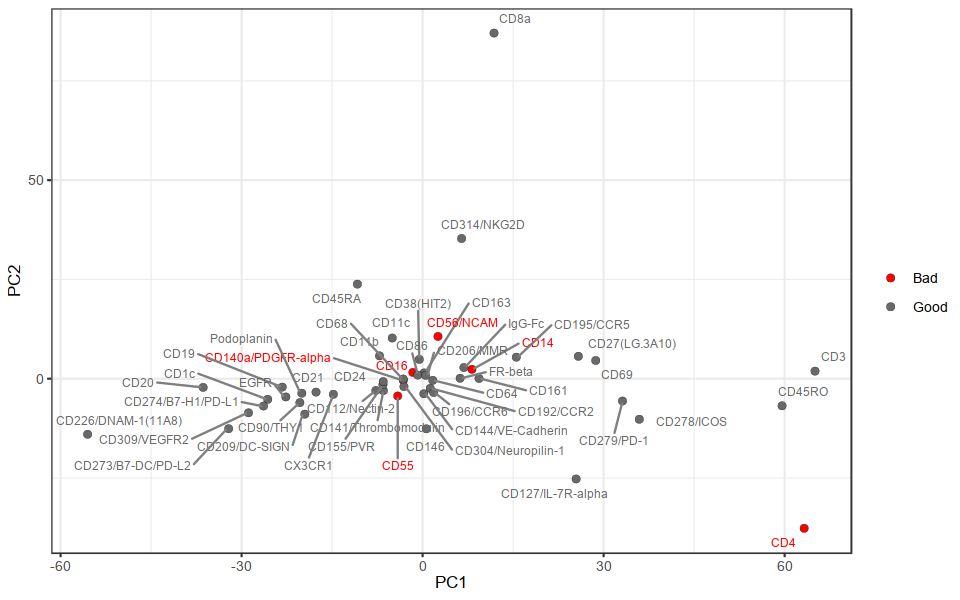

In [221]:
# BRI-546
adt_pca$antibody <- gsub("\\_.*","", rownames(adt_exprs)) 
adt_pca$highlight <- rep("Good", nrow(adt_pca))
adt_pca[which(adt_pca$antibody %in% c("CD14", "CD16", "CD4", "CD140a/PDGFR-alpha", "CD14", "CD56/NCAM", "CD55")),]$highlight <- "Bad"
table(adt_pca$highlight)

options(repr.plot.height = 5, repr.plot.width = 8)
ggplot(adt_pca, aes(PC1, PC2, label = antibody, fill = highlight)) + 
  geom_point(size = 2, shape = 21, stroke = 0.1) +
  geom_text_repel(
    data = adt_pca,
    aes(label = antibody, color = highlight),
#     fontface = 'bold', 
    size = 2.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c("red", "dimgrey"), name = "") +
  scale_color_manual(values = c("red", "dimgrey"), name = "") +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )

In [ ]:
# BRI-507
adt_pca$antibody <- gsub("\\_.*","", rownames(adt_exprs)) 
adt_pca$highlight <- rep("Good", nrow(adt_pca))
adt_pca[which(adt_pca$antibody %in% c("CD14", "CD16", "Podoplanin", "CD140a/PDGFR-alpha", "CD14", "CD56/NCAM", "CD55")),]$highlight <- "Bad"
table(adt_pca$highlight)

options(repr.plot.height = 5, repr.plot.width = 8)
ggplot(adt_pca, aes(PC1, PC2, label = antibody, fill = highlight)) + 
  geom_point(size = 2, shape = 21, stroke = 0.1) +
  geom_text_repel(
    data = adt_pca,
    aes(label = antibody, color = highlight),
#     fontface = 'bold', 
    size = 2.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c("red", "dimgrey"), name = "") +
  scale_color_manual(values = c("red", "dimgrey"), name = "") +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )

In [ ]:
# BRI-631
adt_pca$antibody <- gsub("\\_.*","", rownames(adt_exprs)) 
adt_pca$highlight <- rep("Good", nrow(adt_pca))
adt_pca[which(adt_pca$antibody %in% c("CD3", "CD4", "Podoplanin", "CD140a/PDGFR-alpha", "CD56/NCAM", "CD55")),]$highlight <- "Bad"
table(adt_pca$highlight)

options(repr.plot.height = 5, repr.plot.width = 8)
ggplot(adt_pca, aes(PC1, PC2, label = antibody, fill = highlight)) + 
  geom_point(size = 2, shape = 21, stroke = 0.1) +
  geom_text_repel(
    data = adt_pca,
    aes(label = antibody, color = highlight),
#     fontface = 'bold', 
    size = 2.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c("red", "dimgrey"), name = "") +
  scale_color_manual(values = c("red", "dimgrey"), name = "") +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
    plot.title = element_text(color="black", size=22, face = "italic")
  )


 Bad Good 
   6   44 